## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'pastis-full' 
TRANSFORM = 'gabor'
CHANNEL = 'red'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
red_gabor_full_pastis.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/pastis/full/gabor/red'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 16384000,
 1: 16384000,
 2: 16384000,
 3: 16384000,
 4: 16384000,
 5: 16384000,
 6: 16384000,
 7: 16384000,
 8: 16384000,
 9: 16384000,
 10: 16384000,
 11: 16384000,
 12: 16384000,
 13: 16384000,
 14: 16384000,
 15: 16384000,
 16: 16384000,
 17: 16384000,
 18: 16384000,
 19: 16384000,
 20: 16384000,
 21: 16384000,
 22: 16384000,
 23: 16384000,
 24: 16384000,
 25: 16384000,
 26: 16384000,
 27: 16384000,
 28: 16384000,
 29: 16384000,
 30: 16384000,
 31: 16384000,
 32: 16384000,
 33: 16384000,
 34: 16384000,
 35: 16384000,
 36: 16384000,
 37: 16384000,
 38: 16384000,
 39: 16384000,
 40: 16384000,
 41: 16384000}

Running 12760 CDFs


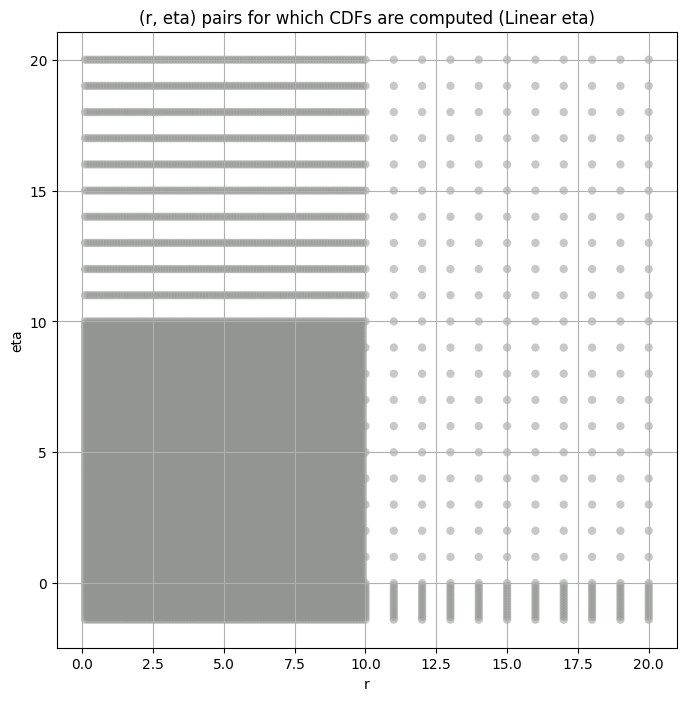

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,45.685776,36.681442,56.196175,4.554366,1.936449,13.453730,16384000.0,"(2.0, 0.5, 0.044)"
1,18.020935,14.297063,22.832045,5.192763,2.020806,22.338587,16384000.0,"(2.0, 0.5, 0.065)"
2,6.863085,5.496876,8.647962,6.144894,2.256978,31.258554,16384000.0,"(2.0, 0.5, 0.096)"
3,2.609329,2.021814,3.562779,8.296274,2.903663,39.319584,16384000.0,"(2.0, 0.5, 0.141)"
4,0.958908,0.720444,1.315991,11.451014,3.967390,63.742058,16384000.0,"(2.0, 0.5, 0.208)"
5,0.279056,0.203140,0.397355,16.405006,3.913536,98.954480,16384000.0,"(2.0, 0.5, 0.306)"
6,0.155727,0.112684,0.251911,20.012684,4.327563,133.719500,16384000.0,"(2.0, 0.5, 0.45)"
7,59.564480,48.876278,73.659966,4.723526,2.010139,13.899191,16384000.0,"(2.0, 1.0, 0.044)"
8,23.811407,19.124970,30.636597,5.541320,2.173217,28.138935,16384000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,45.685776,45.685776,43.866253,42.725842,40.964394
1,18.020935,18.020935,17.255861,16.791645,16.072763
2,6.863085,6.863085,6.538117,6.352648,6.070775
3,2.609329,2.609329,2.461139,2.379794,2.259103
4,0.958908,0.958908,0.891990,0.857595,0.808349
5,0.279056,0.279056,0.255167,0.244015,0.228447
6,0.155727,0.155727,0.141055,0.134592,0.125740
7,59.564480,59.564480,57.108200,55.572624,53.231068
8,23.811407,23.811407,22.769539,22.145113,21.177603


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.001022950874764672 45.685776


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.001589045759338624 43.866253


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.002358167470347495 42.72584


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.0037432292997163774 40.964394
Number of samples: 100000, Without approximation : 16384000.0


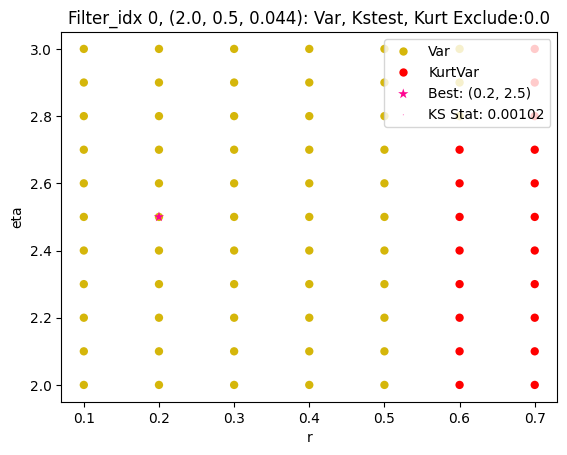

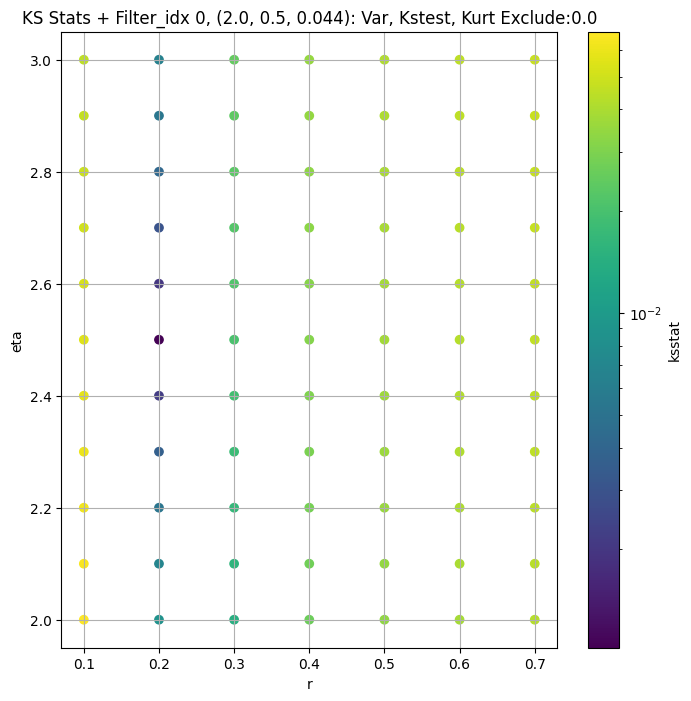

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.0015743698472149292 18.020935


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.0014609301158827748 17.255861


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.0021751795192529455 16.791645


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.00369970765471761 16.072763
Number of samples: 100000, Without approximation : 16384000.0


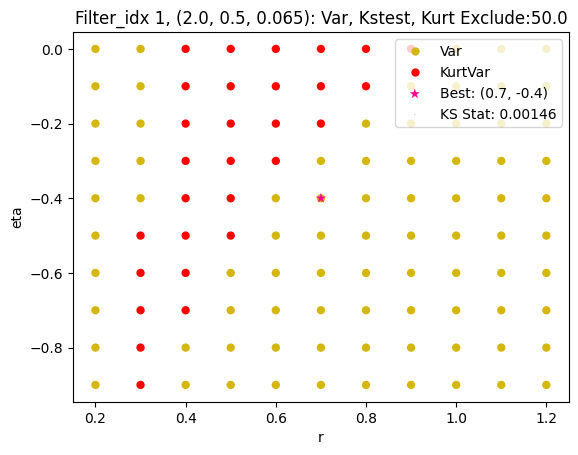

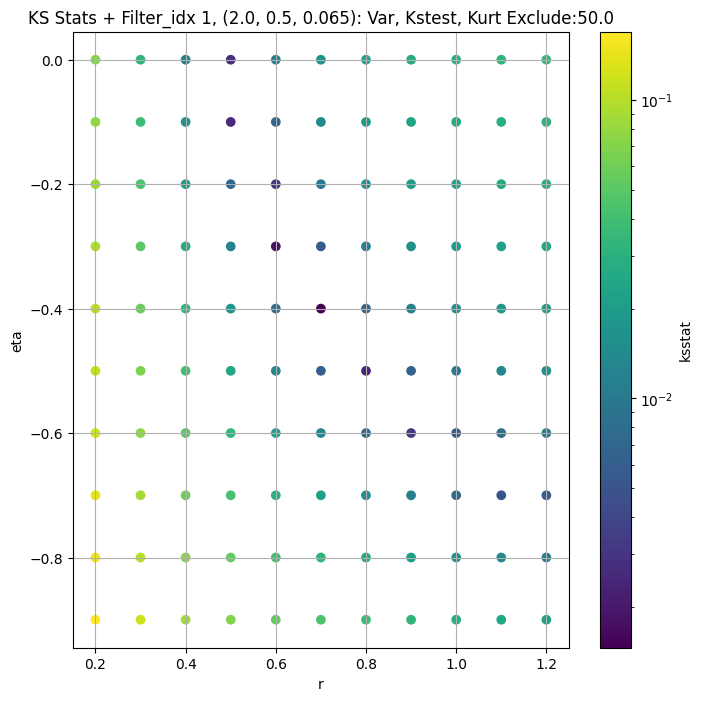

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.0013352841152200479 6.863085


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.002218683172327096 6.538117


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.002278356574339613 6.3526483


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.003661930632882386 6.0707746
Number of samples: 100000, Without approximation : 16384000.0


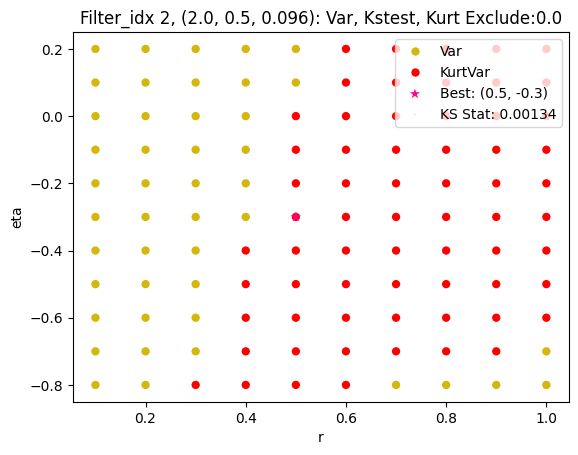

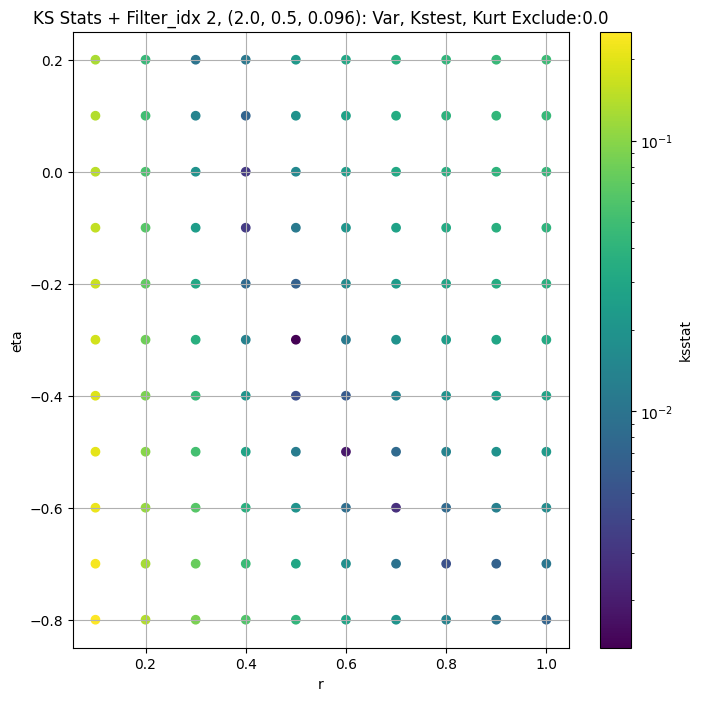

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.002178520910264603 2.6093285


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.002346955729065403 2.4611387


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.0027354406600530387 2.3797936


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.004042841614920221 2.2591033
Number of samples: 100000, Without approximation : 16384000.0


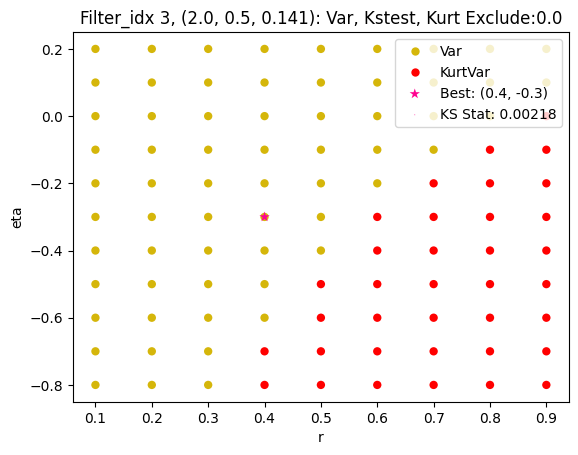

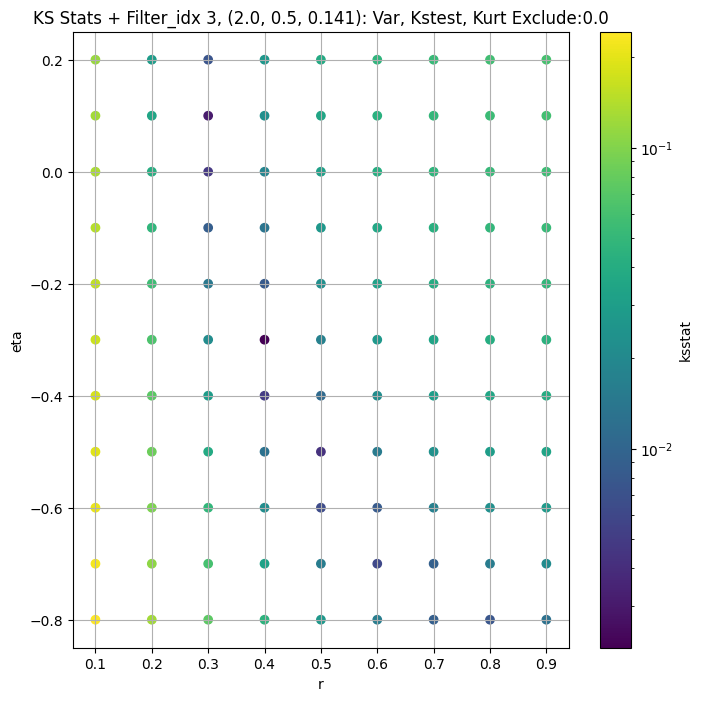

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.0023076306591348628 0.9589084


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.004291147589162991 0.89198965


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.0032739042636033 0.85759467


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.005091972806434031 0.80834943
Number of samples: 100000, Without approximation : 16384000.0


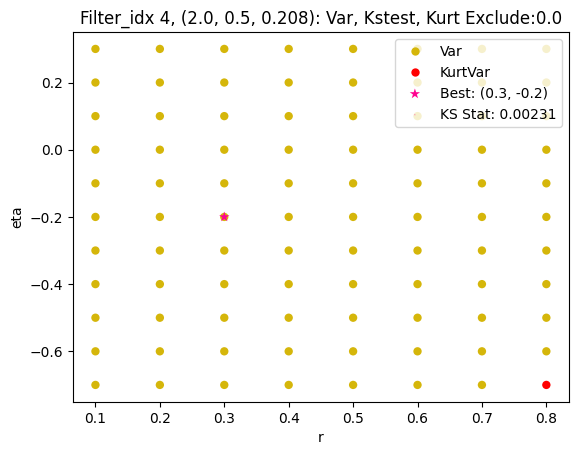

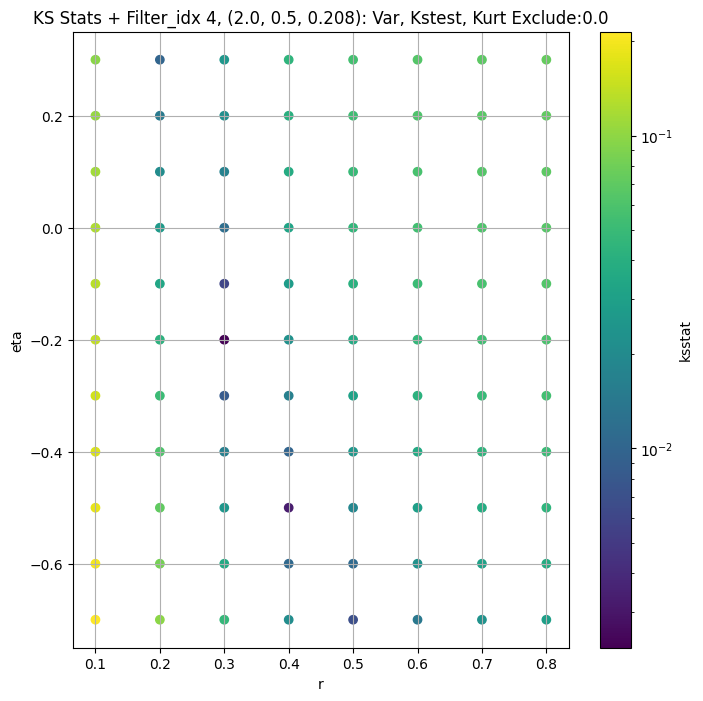

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.002862529056964158 0.2790556


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.003963782918378296 0.255167


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.004353943123348136 0.2440149


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.0053940699777127454 0.22844721
Number of samples: 100000, Without approximation : 16384000.0


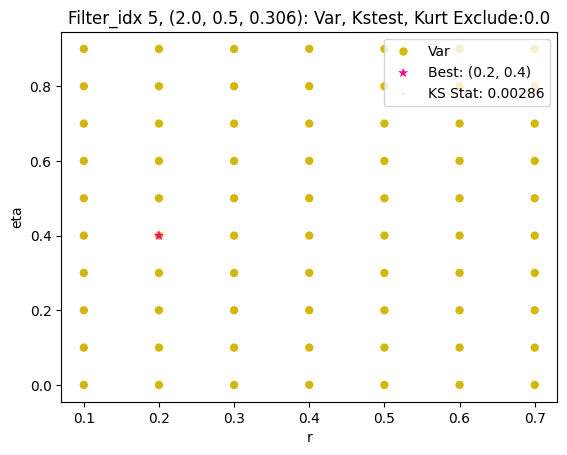

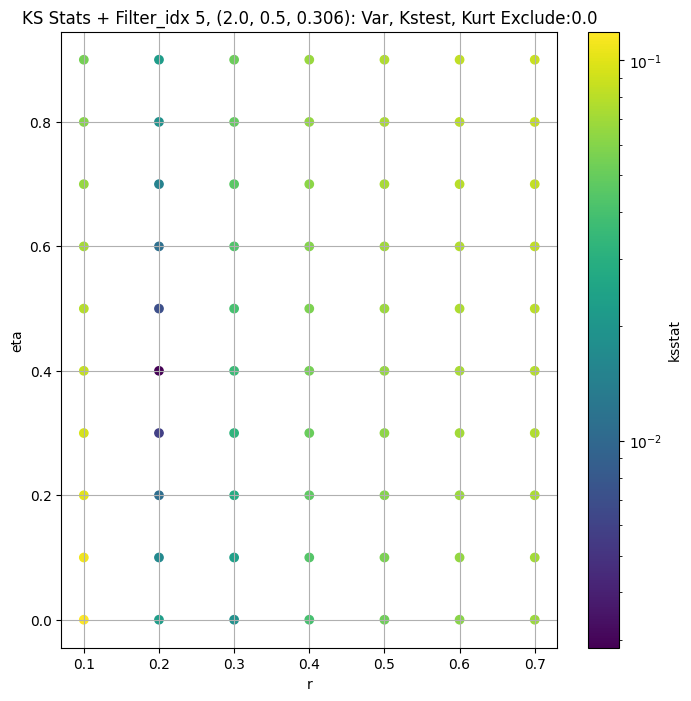

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.0024829728355250102 0.15572727


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.0035251297713065413 0.14105506


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.004641359190549539 0.13459155


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.0051713736530223375 0.12573957
Number of samples: 100000, Without approximation : 16384000.0


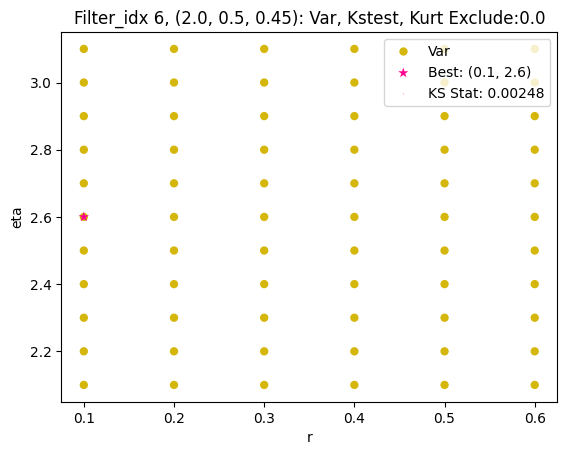

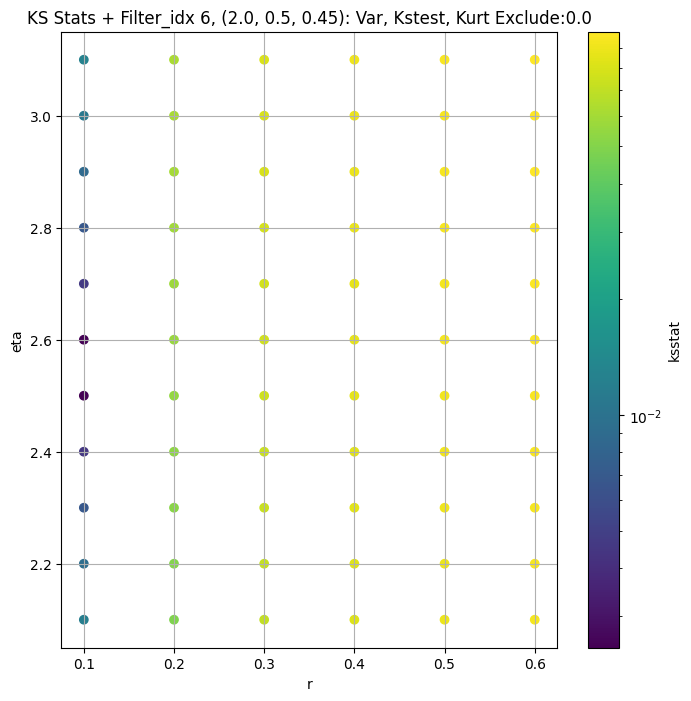

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.0006336024787663708 59.56448


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.0016096753492657045 57.1082


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.0023110562313251246 55.572624


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.0036701969614387833 53.231068
Number of samples: 100000, Without approximation : 16384000.0


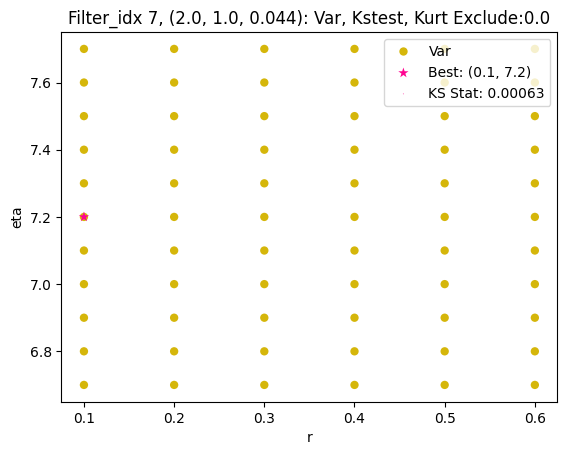

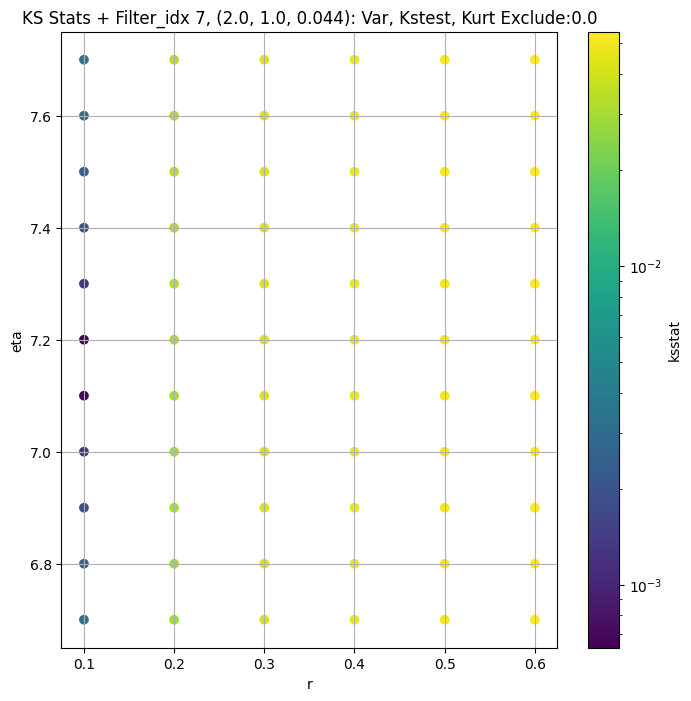

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.000662577016372845 23.811407


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.0015330589157795775 22.769539


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.0023225912393075587 22.145113


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.003713158163356215 21.177603
Number of samples: 100000, Without approximation : 16384000.0


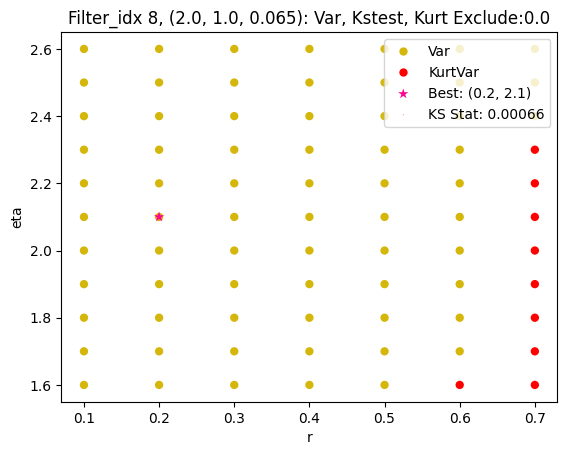

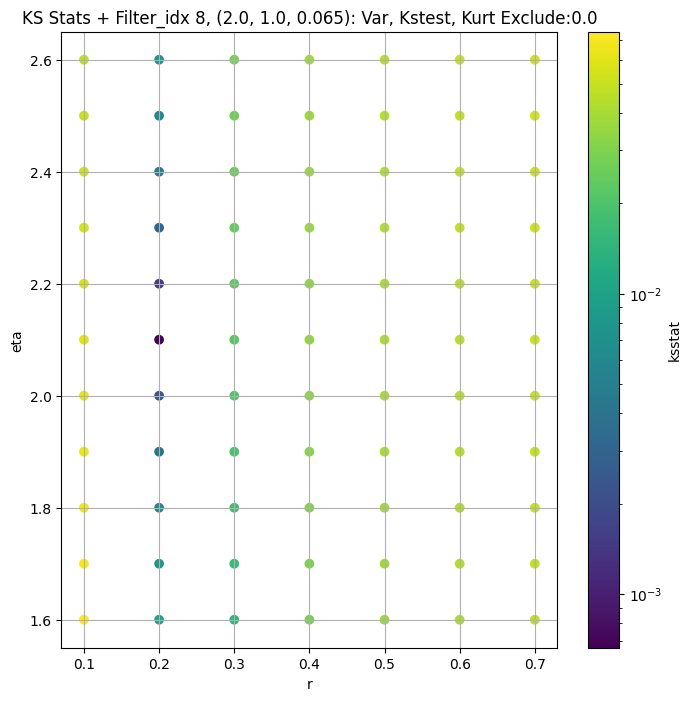

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.0007905946780014661 9.405065


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.0015784780485083236 8.939737


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.0027160536910271205 8.679417


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.003758384901334004 8.283473
Number of samples: 100000, Without approximation : 16384000.0


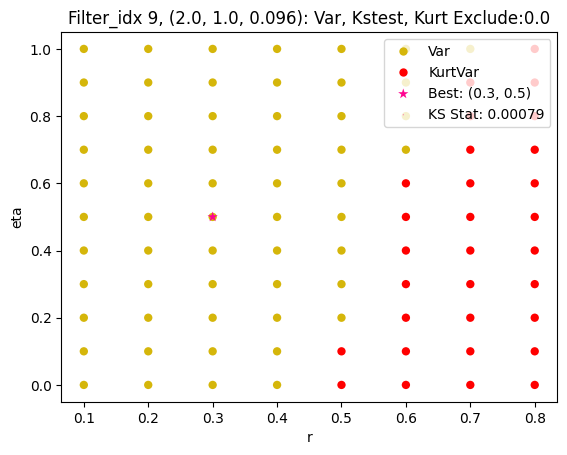

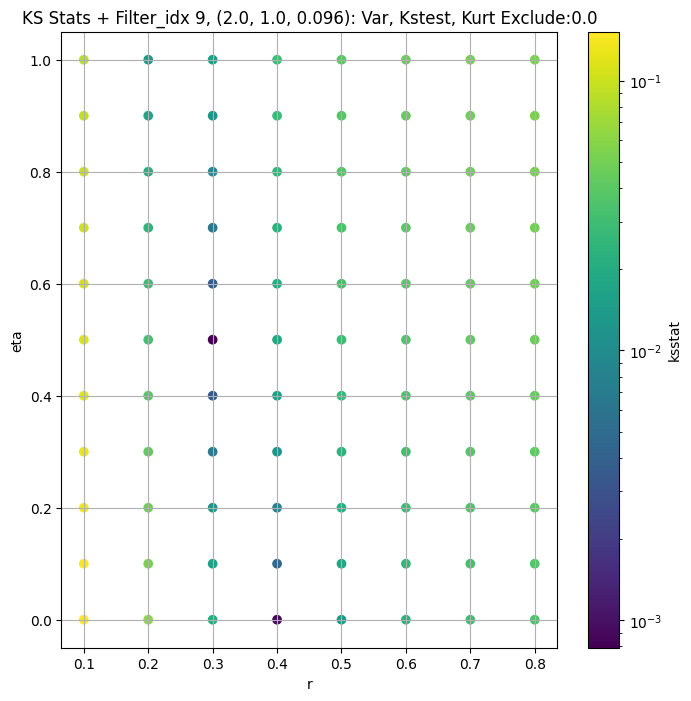

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.0018619744051759923 3.6657112


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.0021254525264414736 3.45509


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.002665843470456286 3.3378959


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.003794351419994846 3.1650236
Number of samples: 100000, Without approximation : 16384000.0


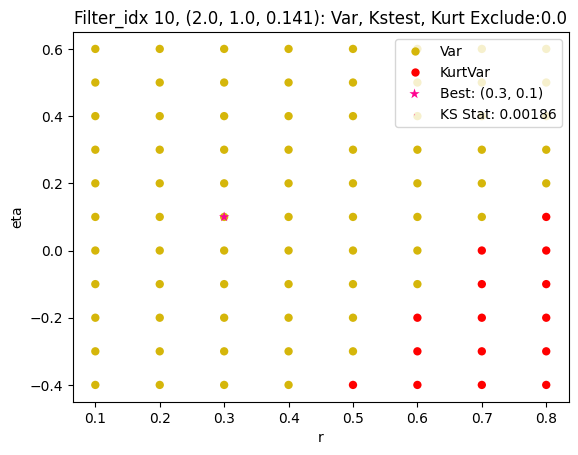

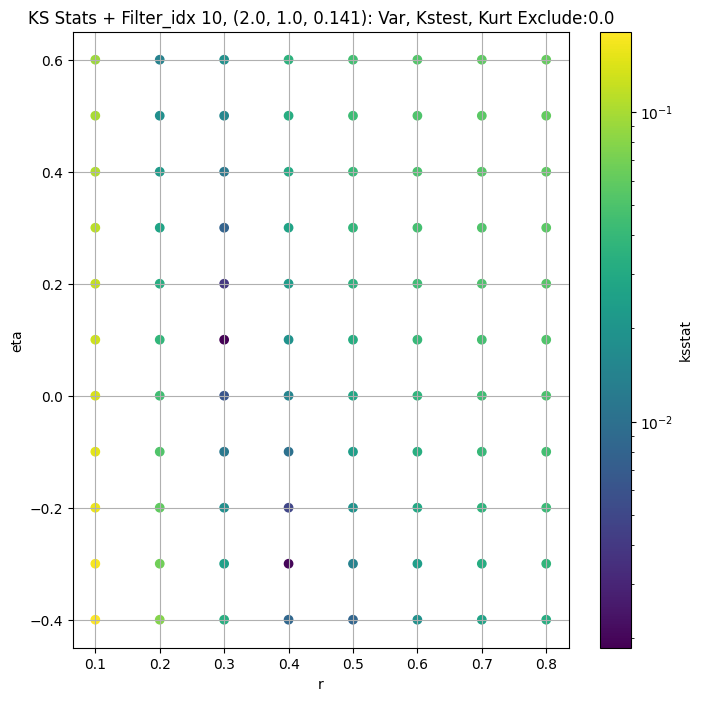

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.002287283960093145 1.3499298


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.0024614702233780594 1.2593298


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.004109135807731756 1.2114172


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.0050277392607988025 1.1419132
Number of samples: 100000, Without approximation : 16384000.0


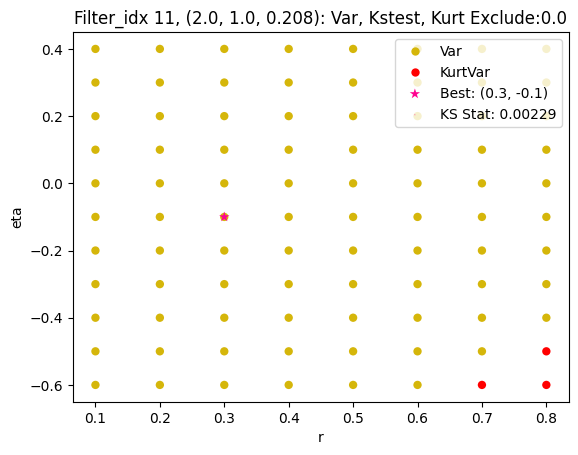

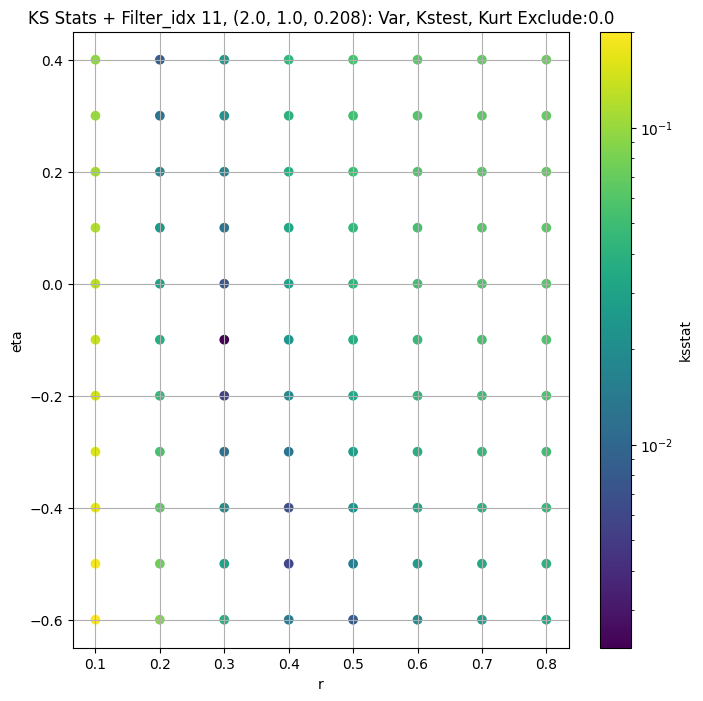

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.0027421105778078214 0.45173845


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.0033516883297579902 0.4146143


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.004042099713398084 0.3968135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.004981522660311155 0.37172934
Number of samples: 100000, Without approximation : 16384000.0


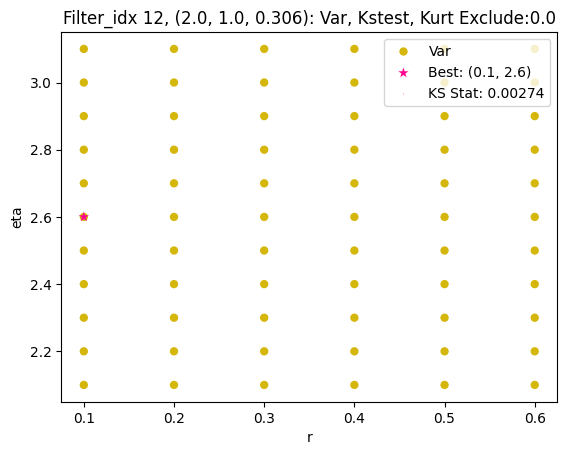

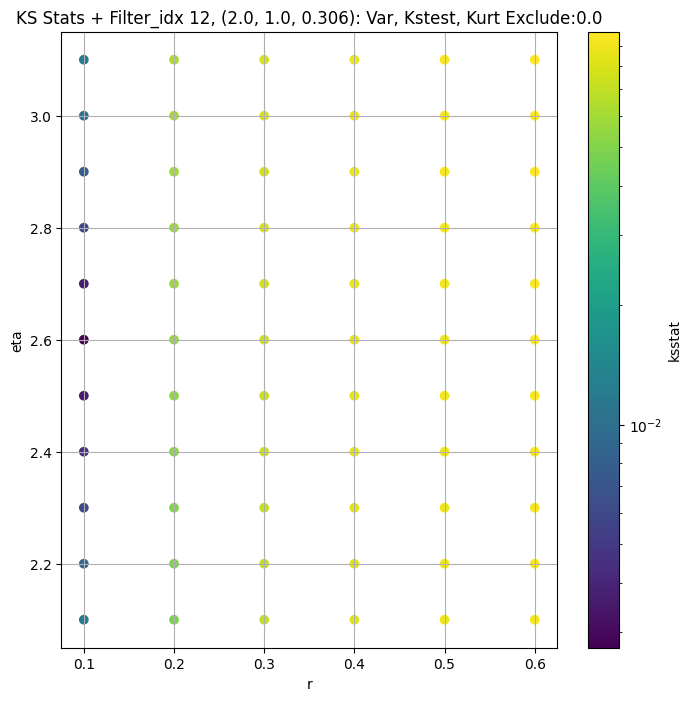

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.0036949385387349265 0.16542232


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.003386208288165049 0.14887649


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.003882506948770334 0.14159043


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.005201347473088425 0.13161324
Number of samples: 100000, Without approximation : 16384000.0


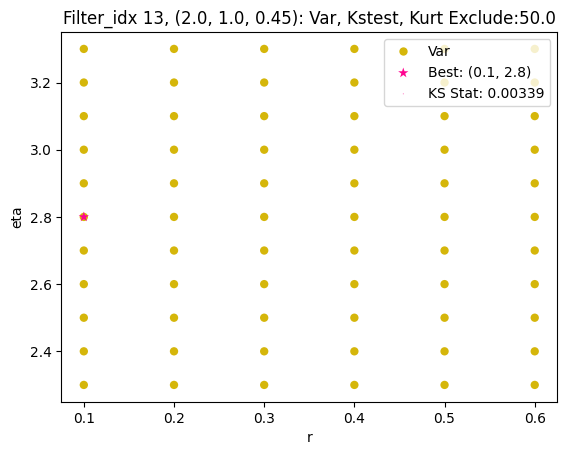

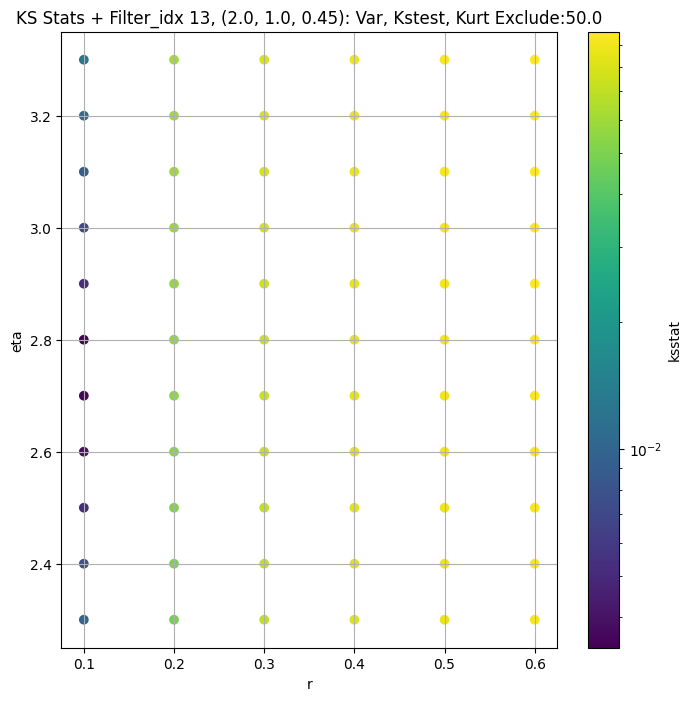

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.0008129979670984389 42.88917


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.0016309598816664564 41.08235


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.0023096913290168164 39.980083


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.003745492467334466 38.275345
Number of samples: 100000, Without approximation : 16384000.0


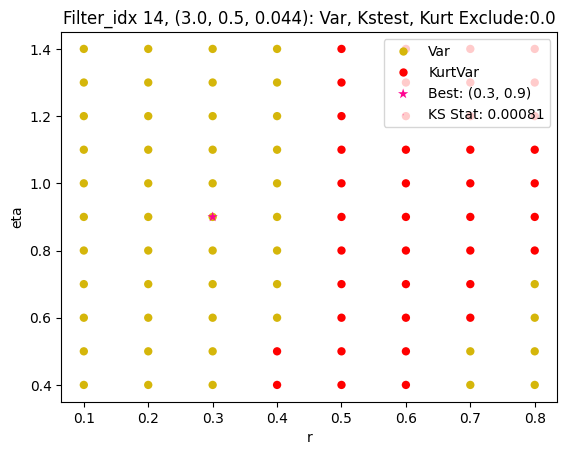

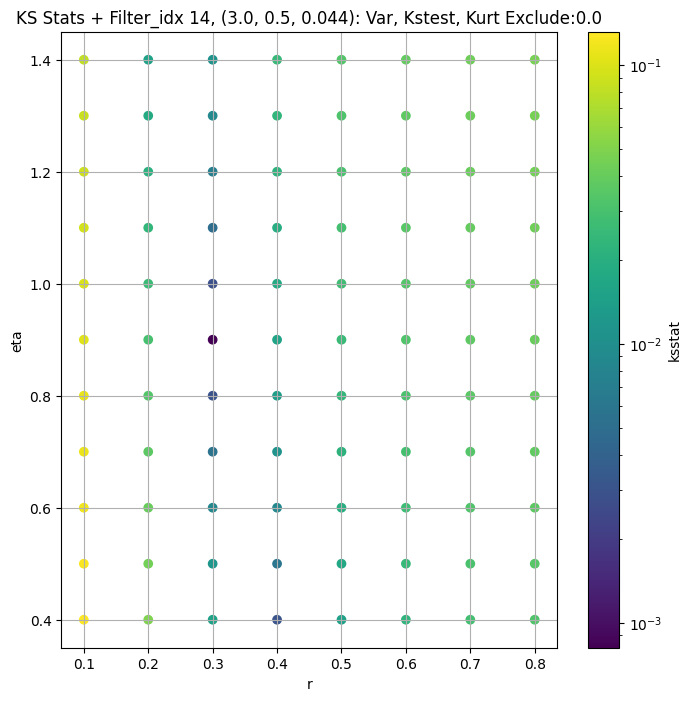

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.001936978969433123 16.928555


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.002254908576109549 16.114779


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.002398668412609186 15.639998


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.00387389972682739 14.919138
Number of samples: 100000, Without approximation : 16384000.0


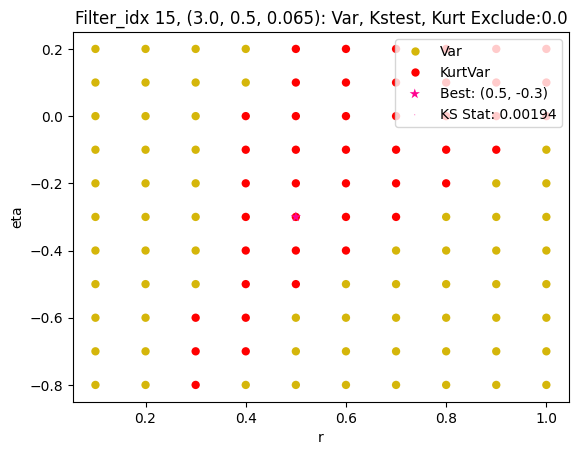

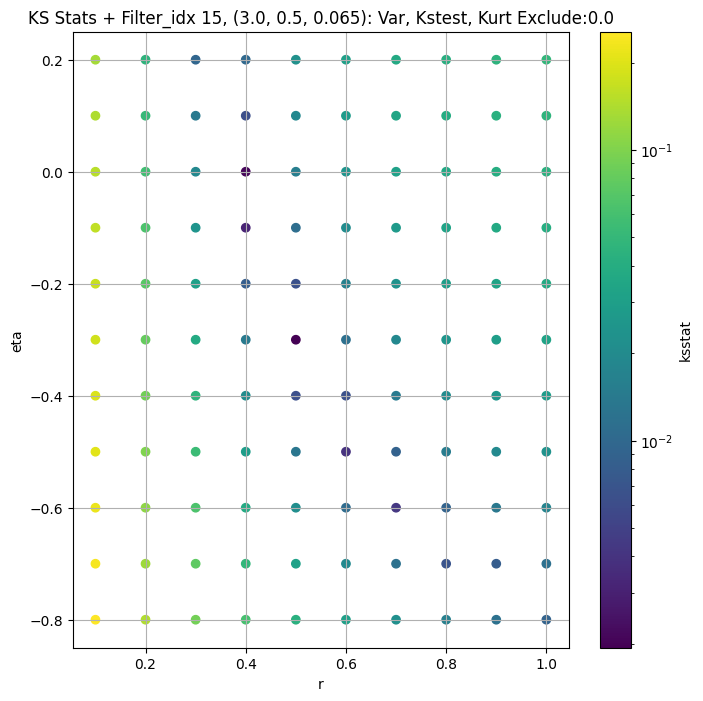

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.00229248948908517 6.561116


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.00305885153187746 6.2307186


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.003622542831915959 6.0373535


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.00409180346584442 5.7446575
Number of samples: 100000, Without approximation : 16384000.0


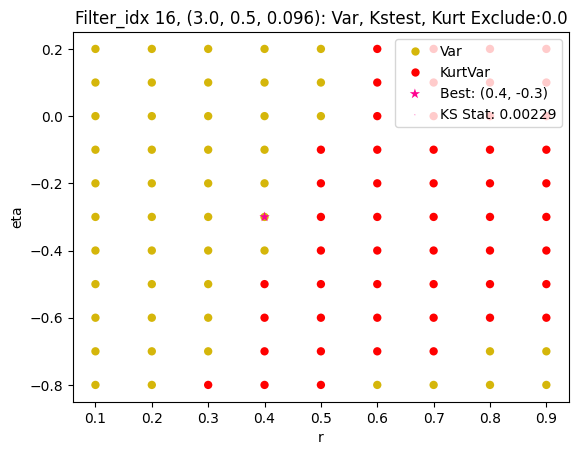

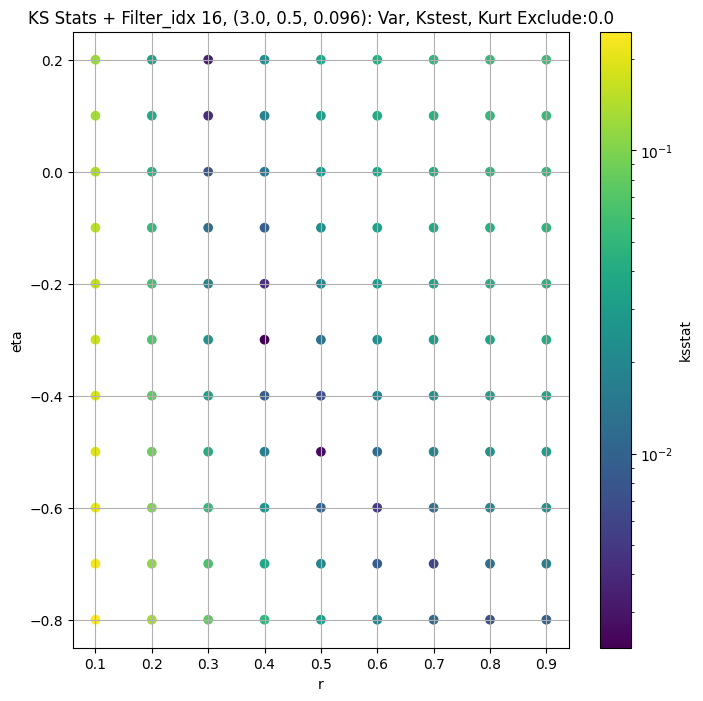

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.0030377017791334837 2.4277604


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.004027068757200047 2.279047


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.003438513324337547 2.1975002


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.0050006497326431434 2.076399
Number of samples: 100000, Without approximation : 16384000.0


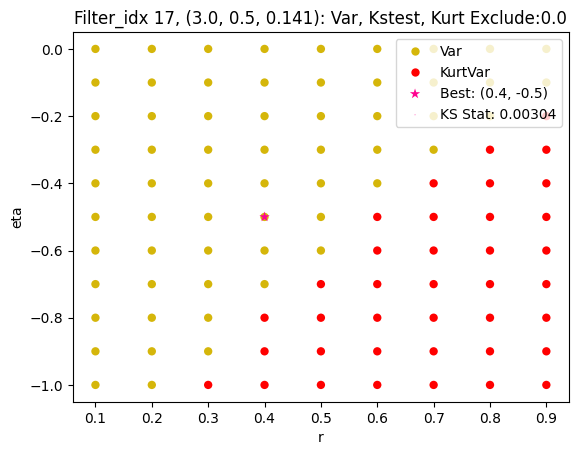

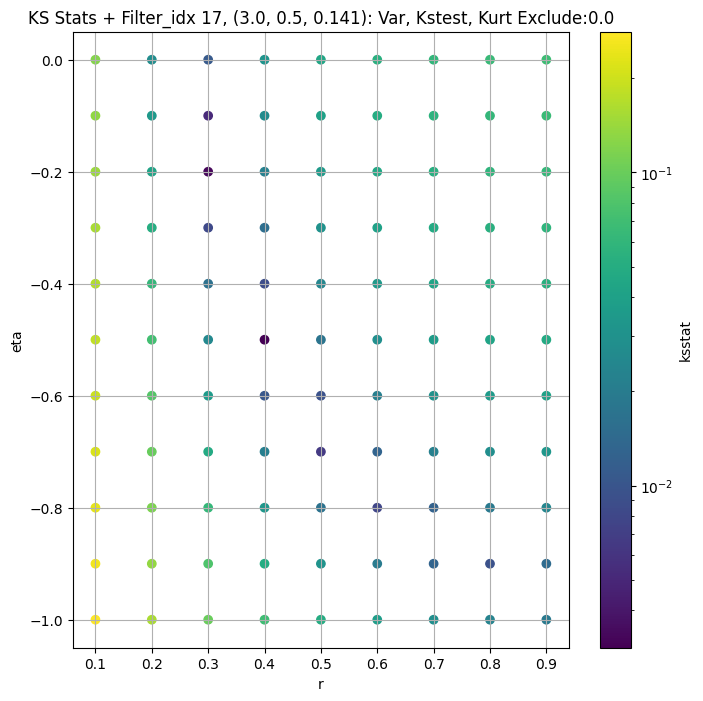

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.005106134193478162 0.89144206


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.004931005137438049 0.8282112


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.005666877925823988 0.79503536


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.006271191217888716 0.746795
Number of samples: 100000, Without approximation : 16384000.0


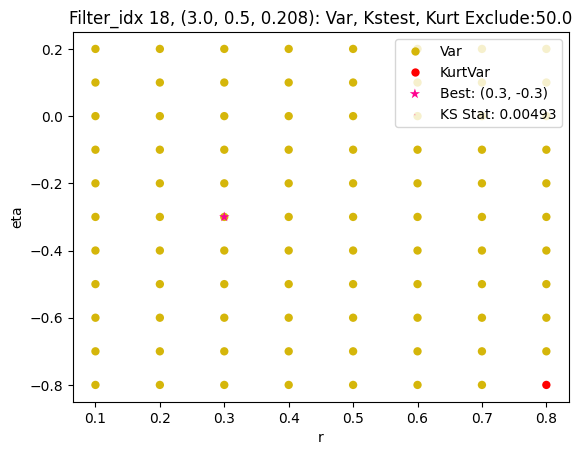

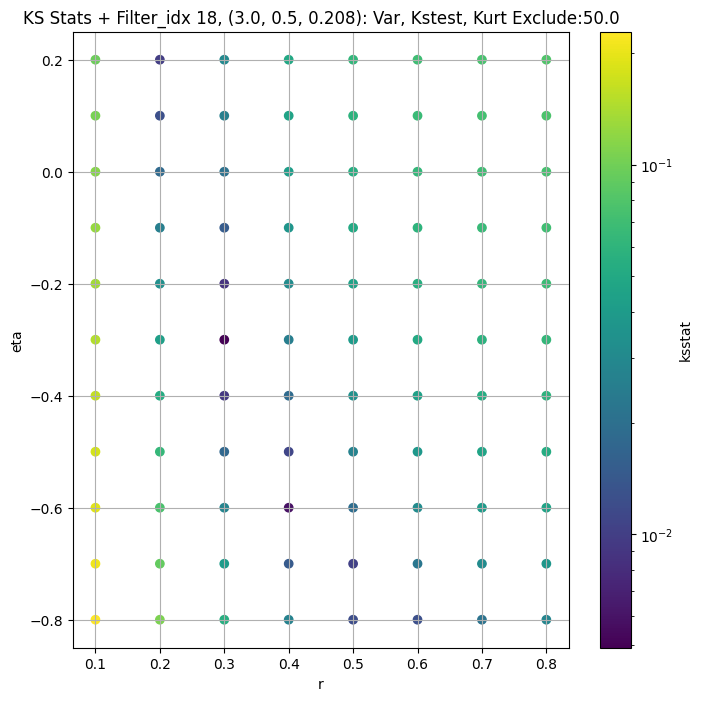

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.003782654026859067 0.27487868


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.004871155236103486 0.25148198


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.004940134626296153 0.23987815


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.006080567883948063 0.22328912
Number of samples: 100000, Without approximation : 16384000.0


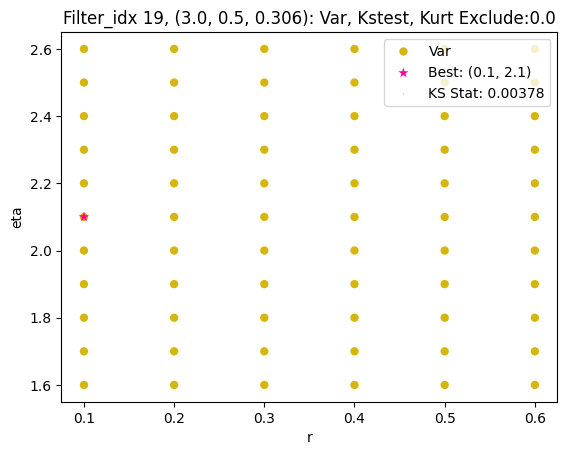

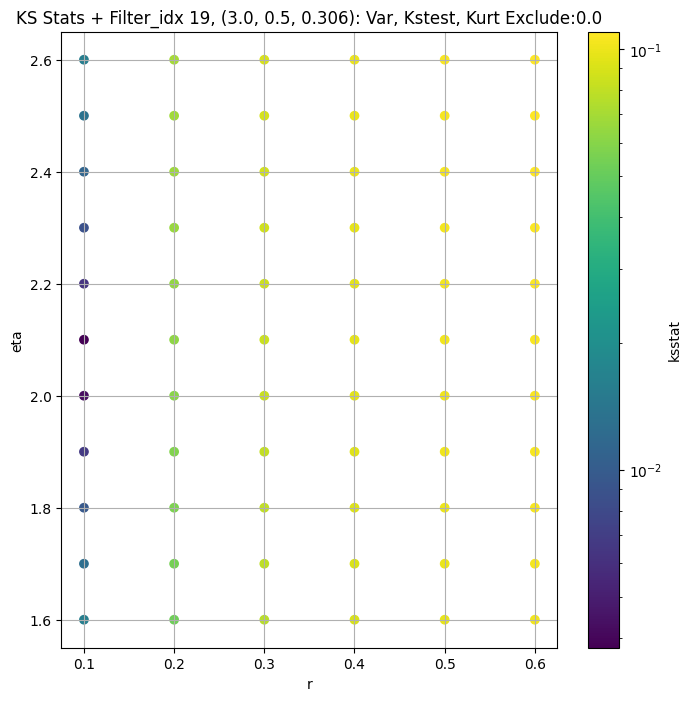

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.007012739307626359 0.08999341


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.004299132076484552 0.08038508


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.0040924575041260125 0.07607011


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.00535595365051101 0.070162214
Number of samples: 100000, Without approximation : 16384000.0


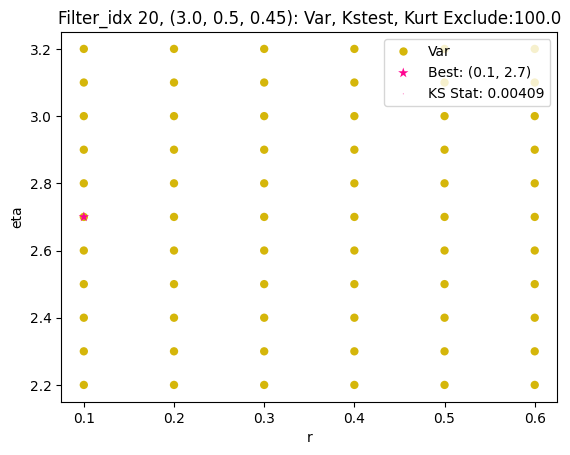

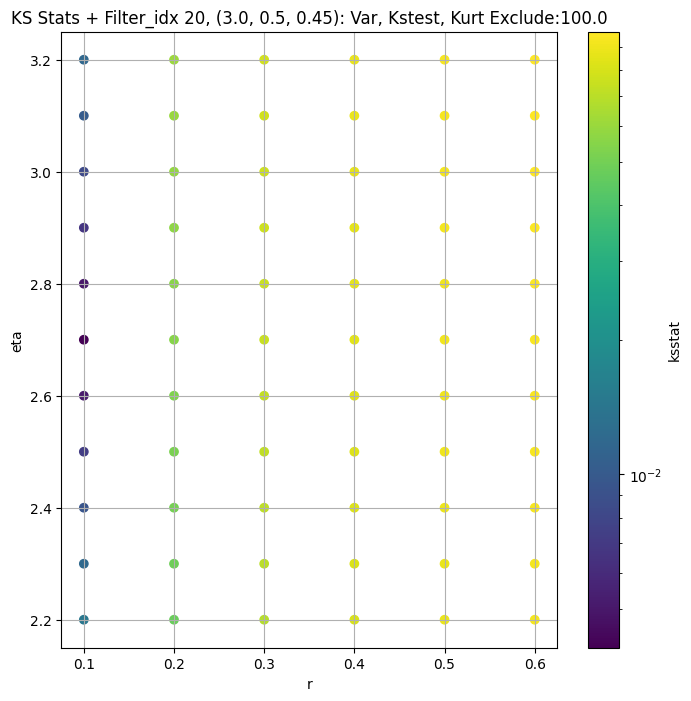

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.0009195410914656088 50.252575


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.0014115187985627164 48.03686


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.0022698248137409394 46.70764


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.0035610061768179824 44.698463
Number of samples: 100000, Without approximation : 16384000.0


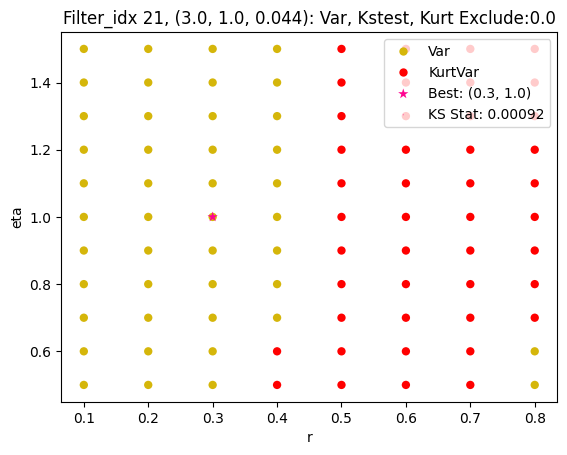

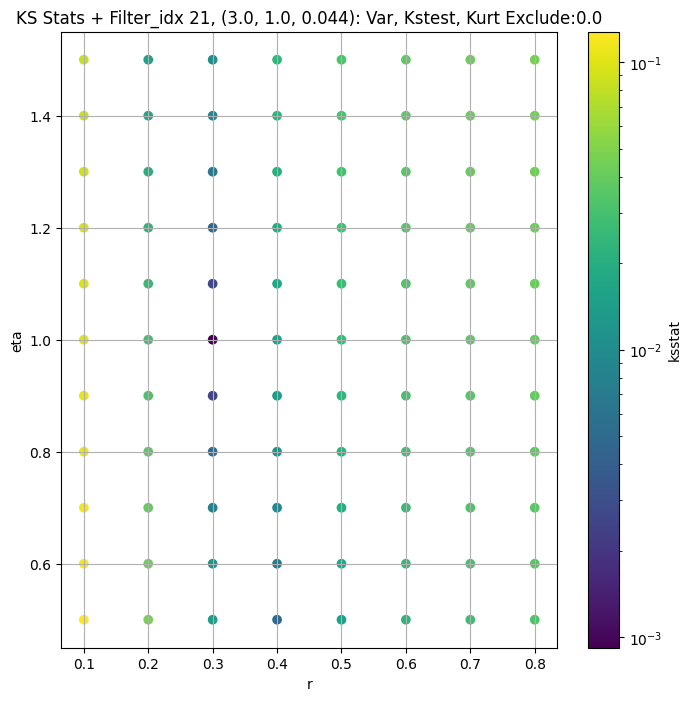

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.0009654825992266858 19.24732


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.0013421616750986139 18.291624


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.0021577766771895164 17.746113


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.0035874314539142485 16.934977
Number of samples: 100000, Without approximation : 16384000.0


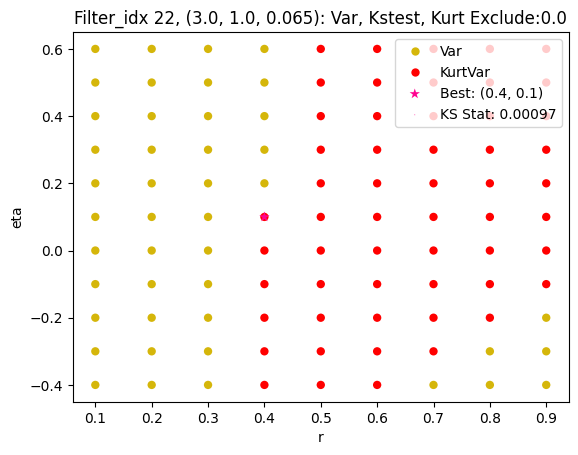

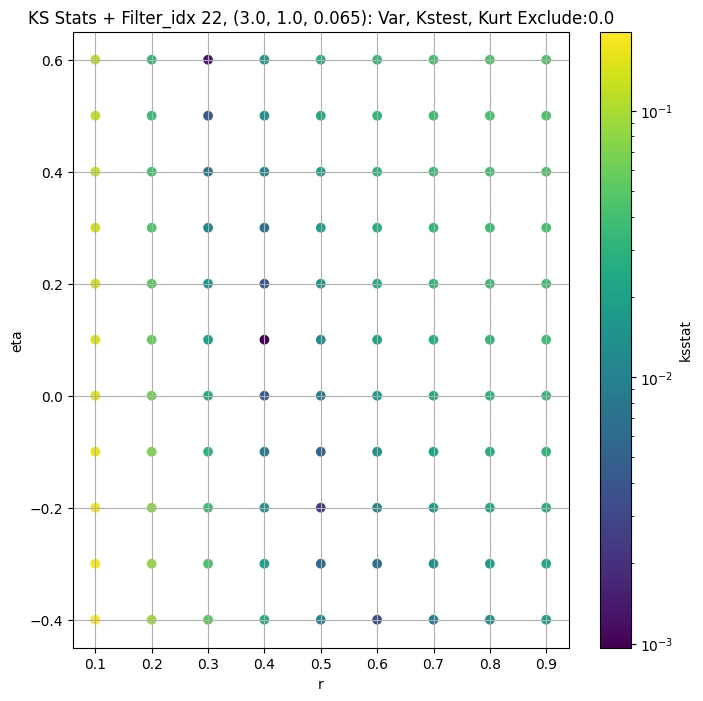

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.0008243563322365421 7.60454


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.0020426520783900504 7.1755185


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.0024099423660115527 6.9385247


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.003849457532086209 6.586826
Number of samples: 100000, Without approximation : 16384000.0


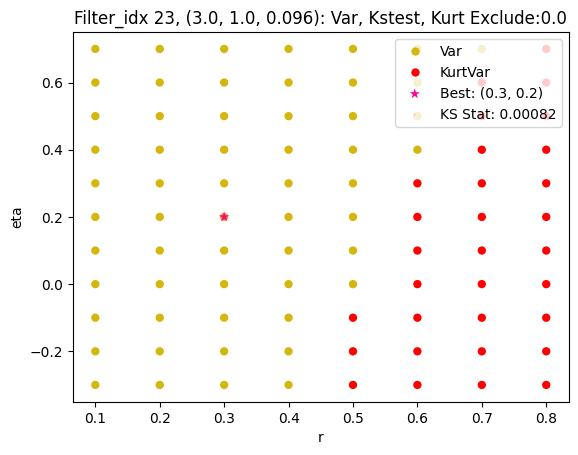

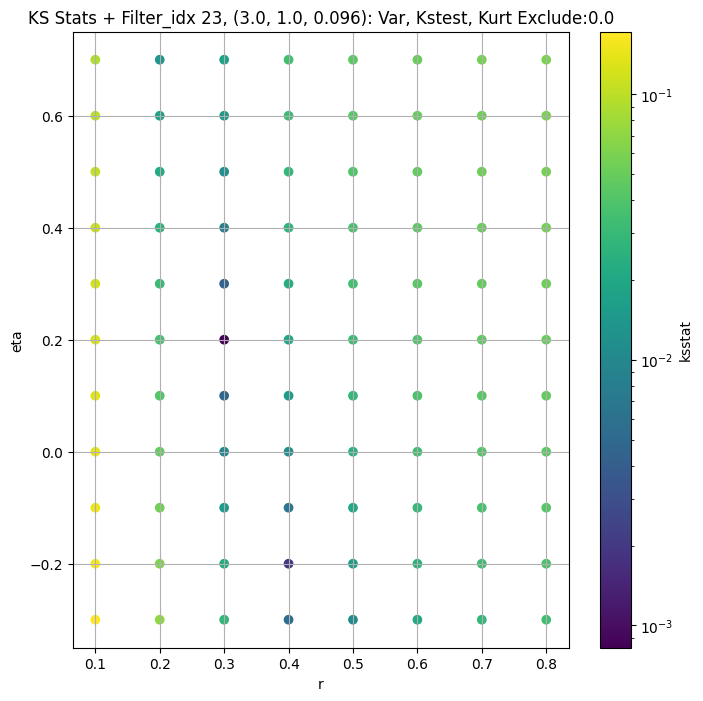

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.0014997774184295487 2.919205


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.003835385750280751 2.7279477


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.002955997906211382 2.626367


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.0045374664414618016 2.4762163
Number of samples: 100000, Without approximation : 16384000.0


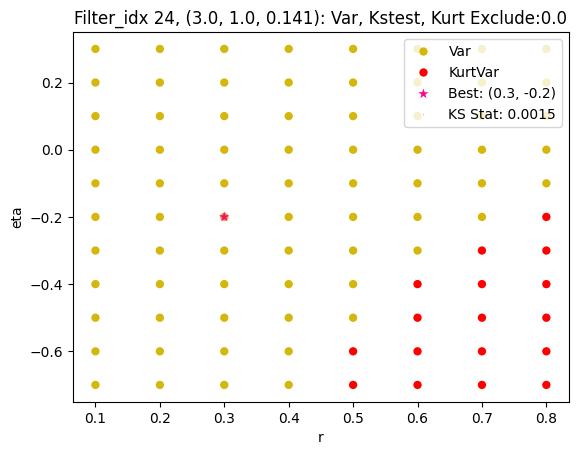

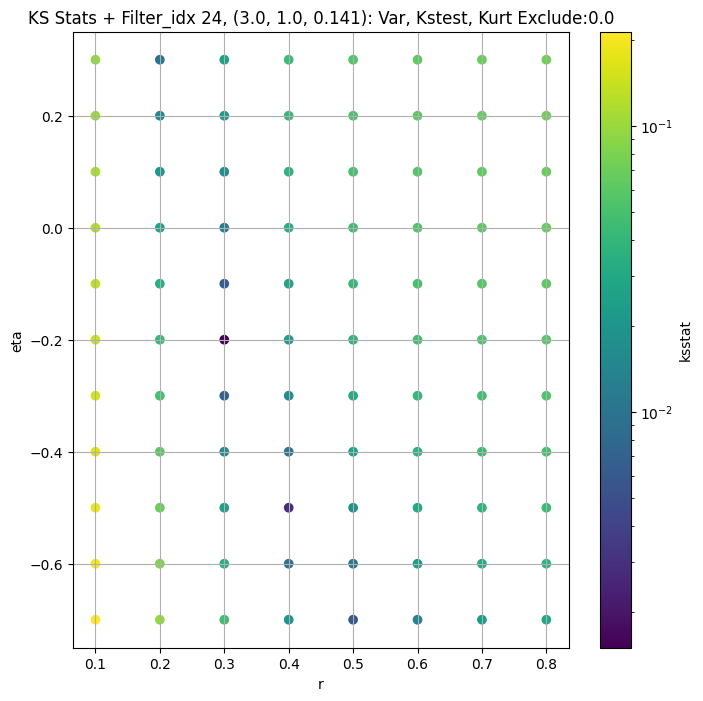

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.0024604103529773935 1.0830297


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.004265704154032268 1.0005598


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.004950588537545819 0.9582659


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.005734287357866033 0.8966604
Number of samples: 100000, Without approximation : 16384000.0


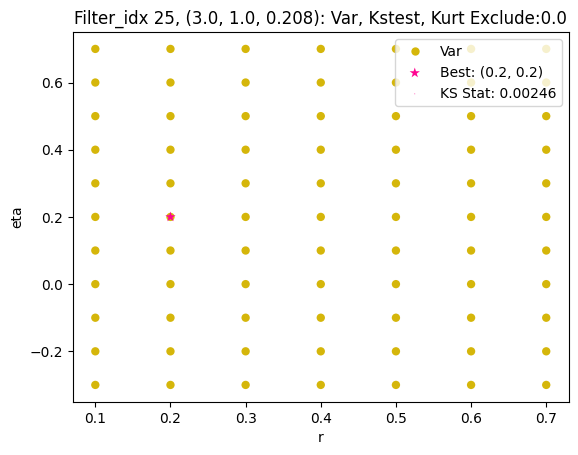

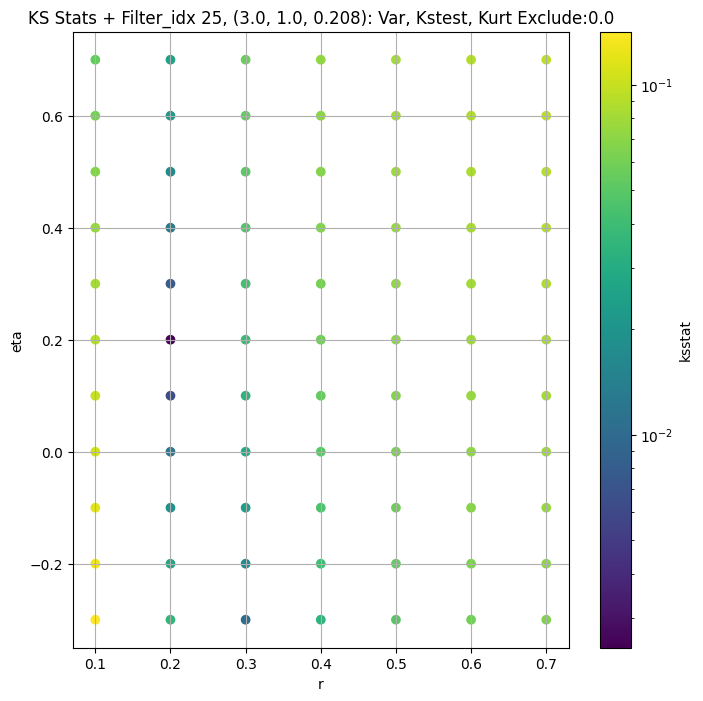

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.005109384823936303 0.34488


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.00441003400850648 0.313247


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.004752034411413003 0.2978


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.00647540613279441 0.27595907
Number of samples: 100000, Without approximation : 16384000.0


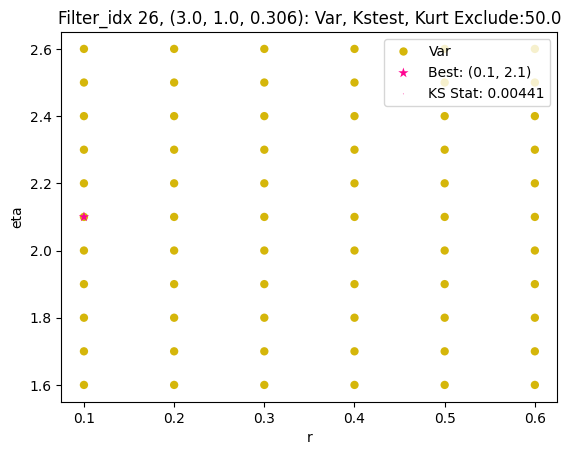

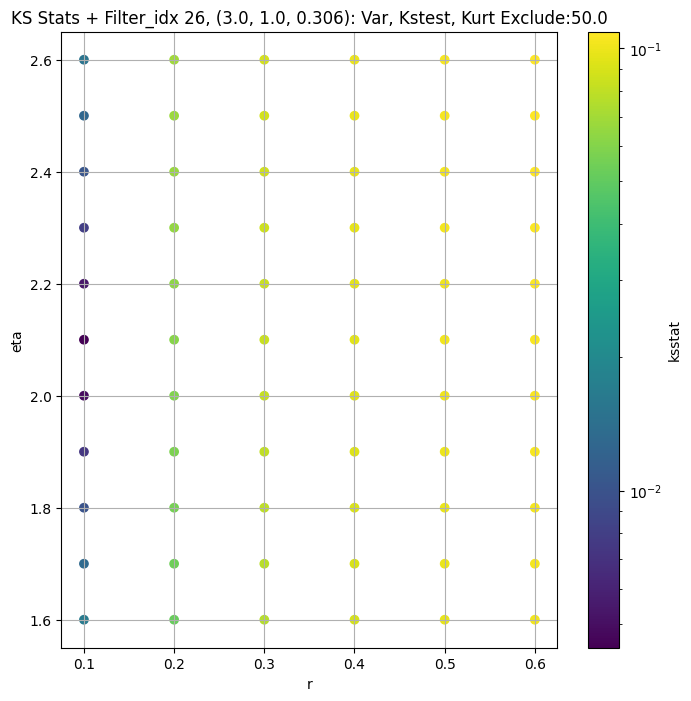

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.00817754314410557 0.09697406


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.006159839146071655 0.086109


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.004957547070716051 0.08128587


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.005334926298453224 0.074801475
Number of samples: 100000, Without approximation : 16384000.0


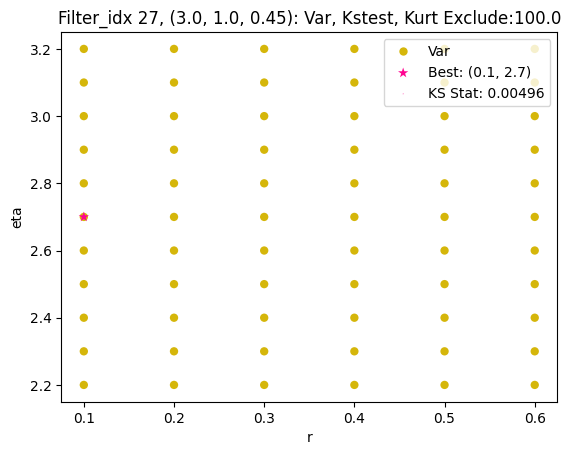

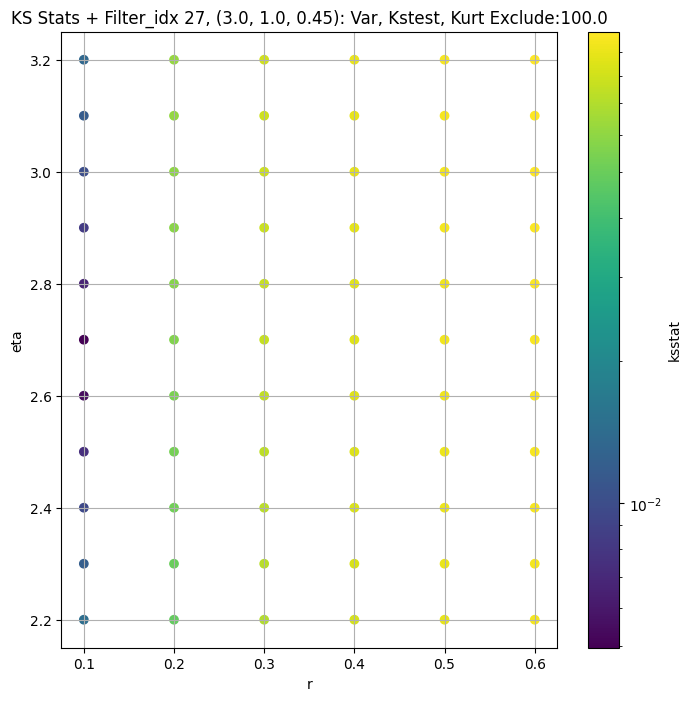

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.0008366965541102833 39.024323


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.0017097036005504183 37.635754


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.0026349412607566958 36.754185


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.003935666094149415 35.382828
Number of samples: 100000, Without approximation : 16384000.0


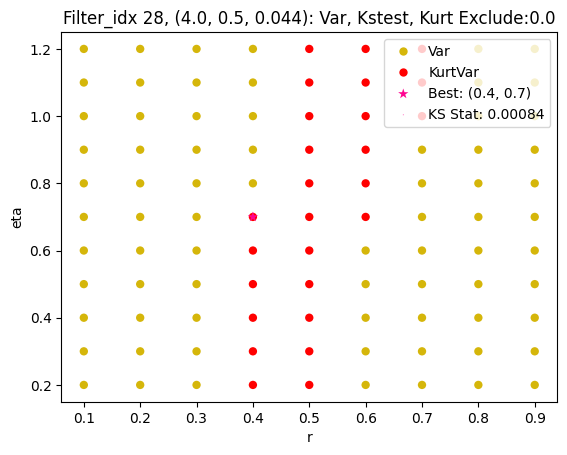

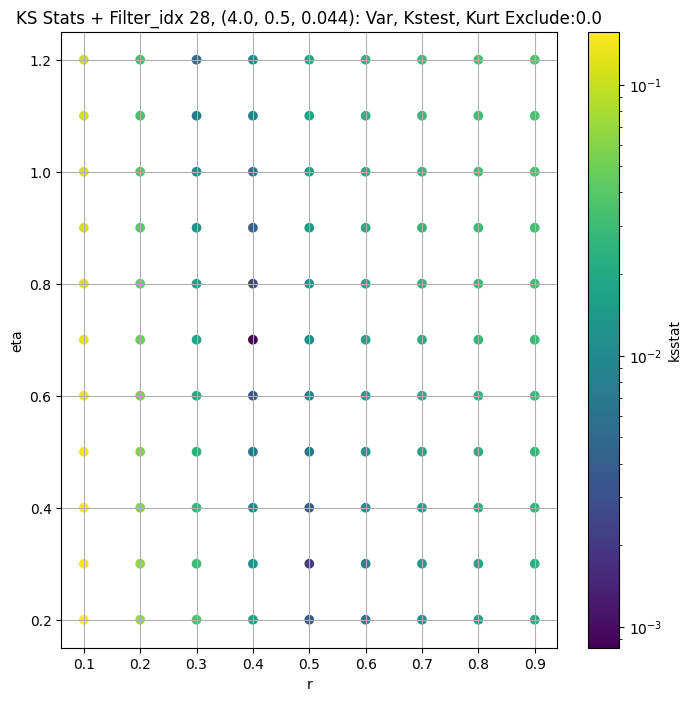

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.0010348408445034485 16.513273


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.0012808695421617812 15.719527


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.0020697220601604283 15.266776


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.0035419089137548668 14.586671
Number of samples: 100000, Without approximation : 16384000.0


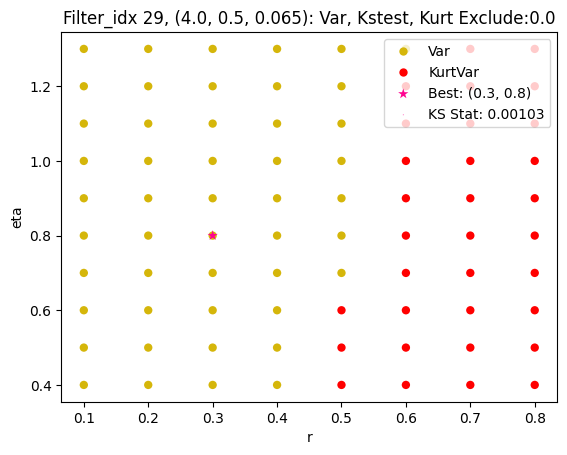

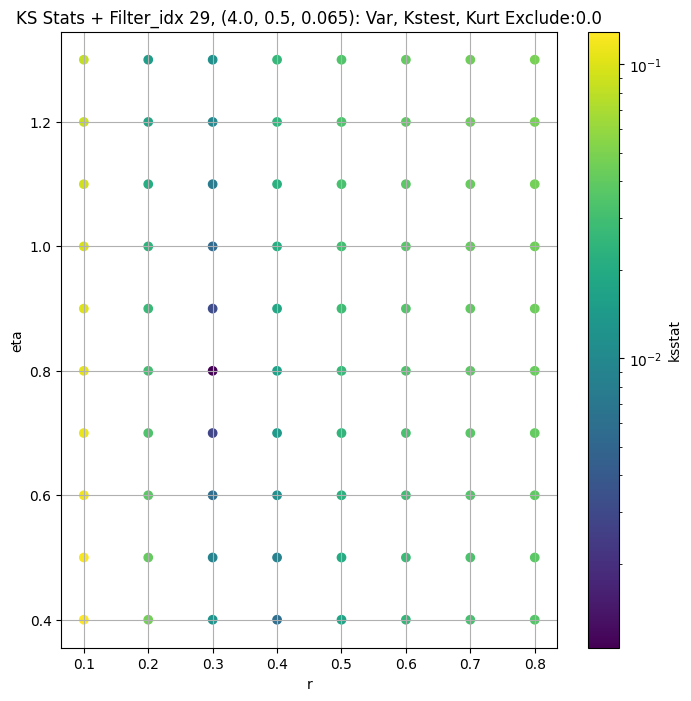

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.0011840908855822452 6.377927


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.0020586775003736194 6.0625525


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.0026282457234999904 5.8830566


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.0039516556960759175 5.6131525
Number of samples: 100000, Without approximation : 16384000.0


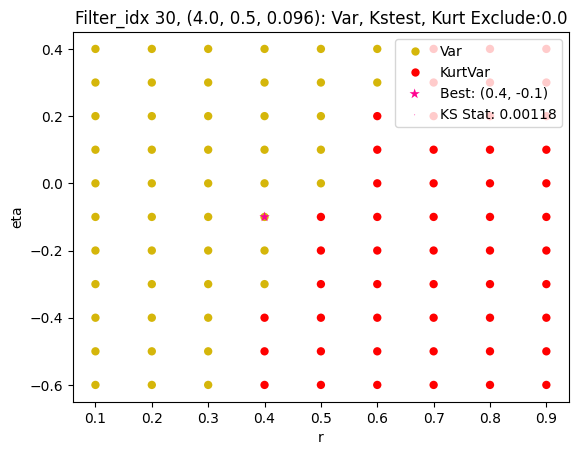

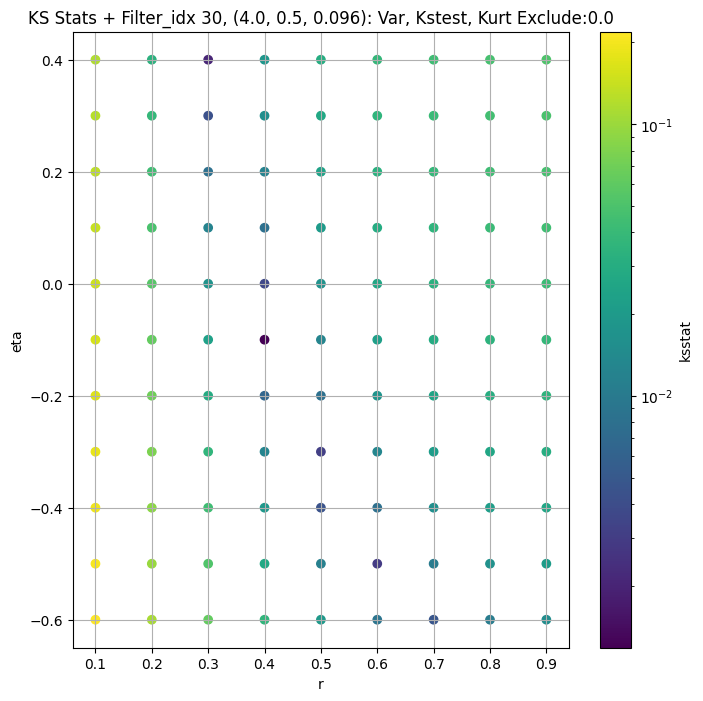

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.002729046891568665 2.331385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.0020656529736868823 2.1982572


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.0027301296995171503 2.126303


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.004628469058796603 2.0183532
Number of samples: 100000, Without approximation : 16384000.0


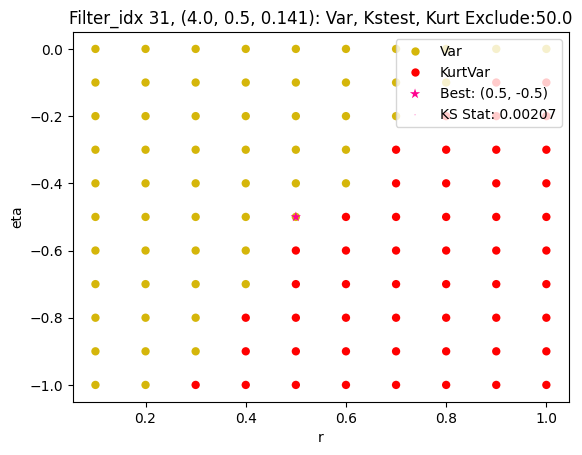

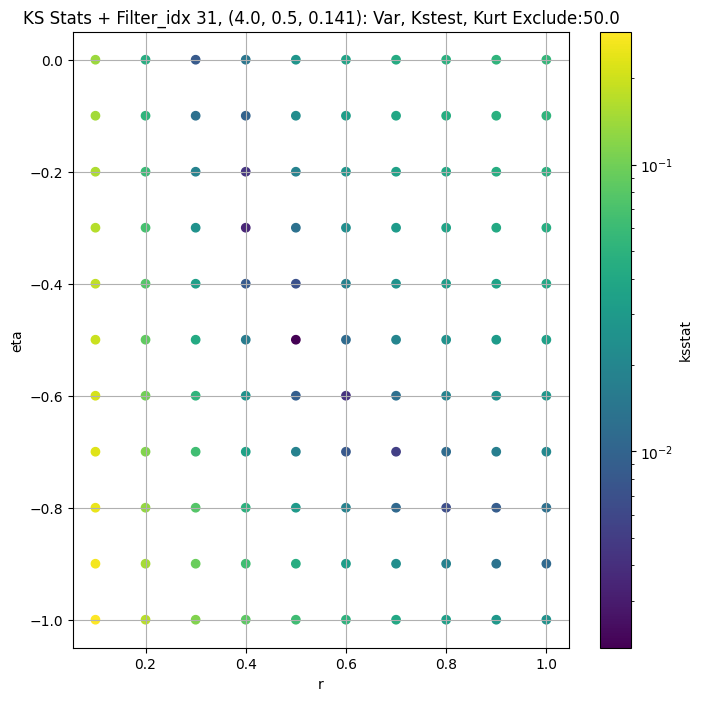

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.0031627717827563684 0.82677805


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.004210479824948099 0.76903844


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.004691906992274175 0.7382056


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.005561220362174768 0.6935644
Number of samples: 100000, Without approximation : 16384000.0


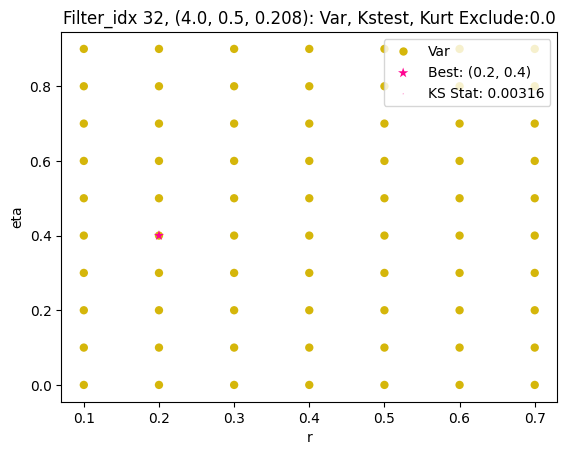

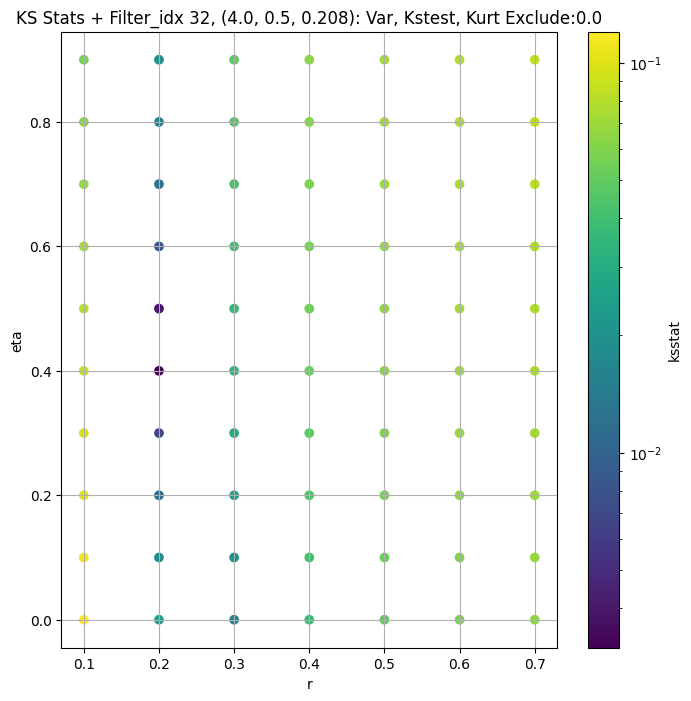

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.0037075752725360678 0.27373427


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.0042664693808936865 0.25170586


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.004434592626077059 0.24024212


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.005557621839573257 0.22389565
Number of samples: 100000, Without approximation : 16384000.0


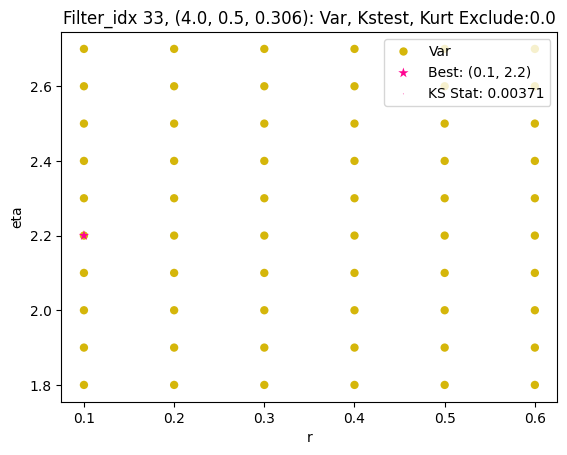

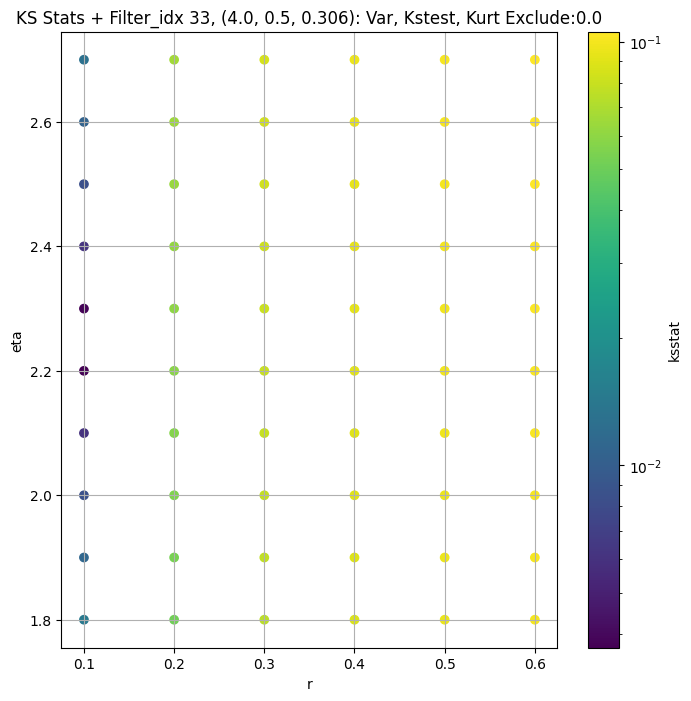

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.007248313188527616 0.071296915


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.005276316716935486 0.06320848


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.0036452898280074364 0.059823748


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.0047953939677307655 0.055263102
Number of samples: 100000, Without approximation : 16384000.0


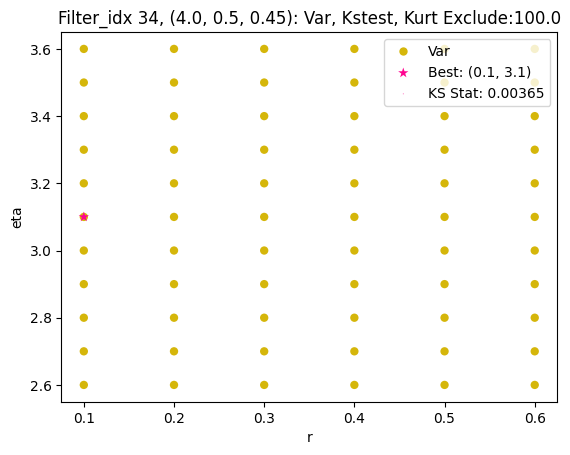

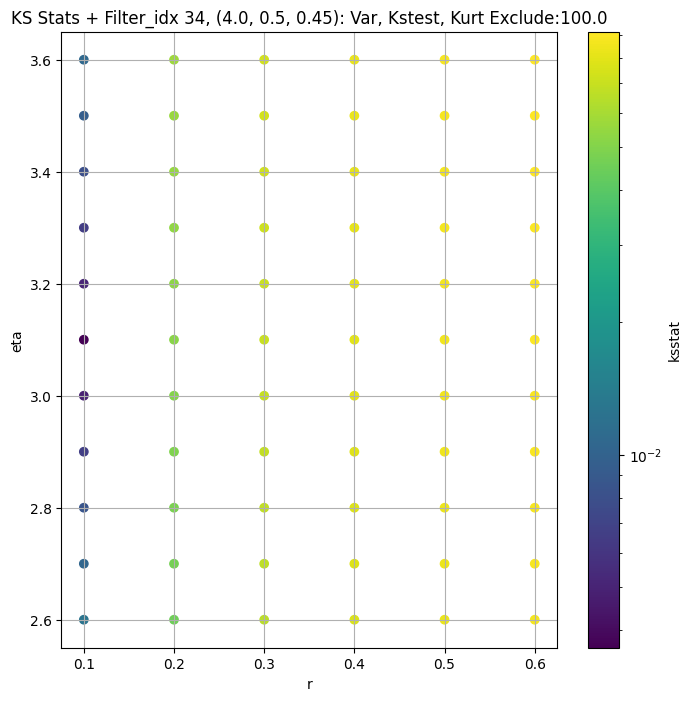

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.0006444816570047585 45.61281


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.0015676713045544854 43.83298


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.0022489676188145458 42.726875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.0036555916713024335 41.01121
Number of samples: 100000, Without approximation : 16384000.0


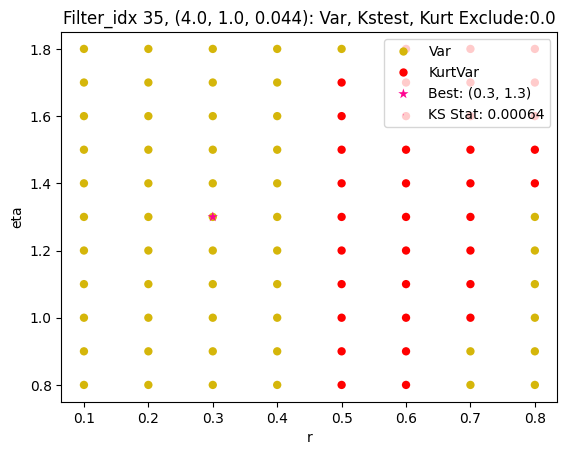

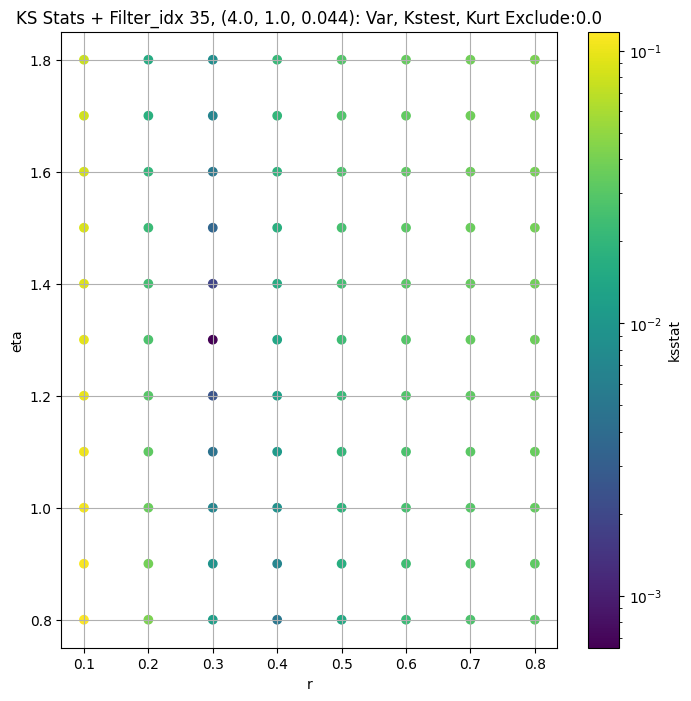

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.000715705990685378 17.962212


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.0010982153024329463 17.054998


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.00206310994464598 16.55872


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.0035248620441846734 15.82444
Number of samples: 100000, Without approximation : 16384000.0


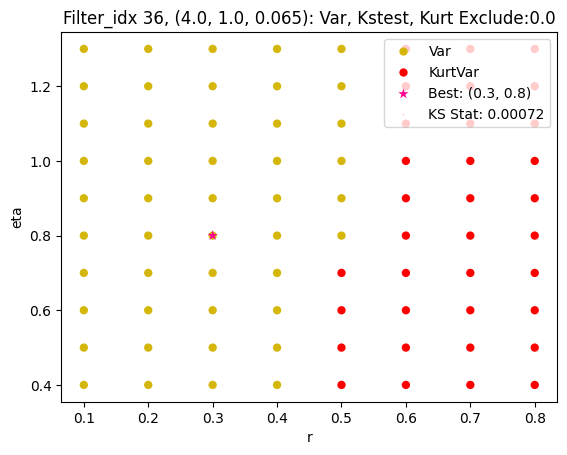

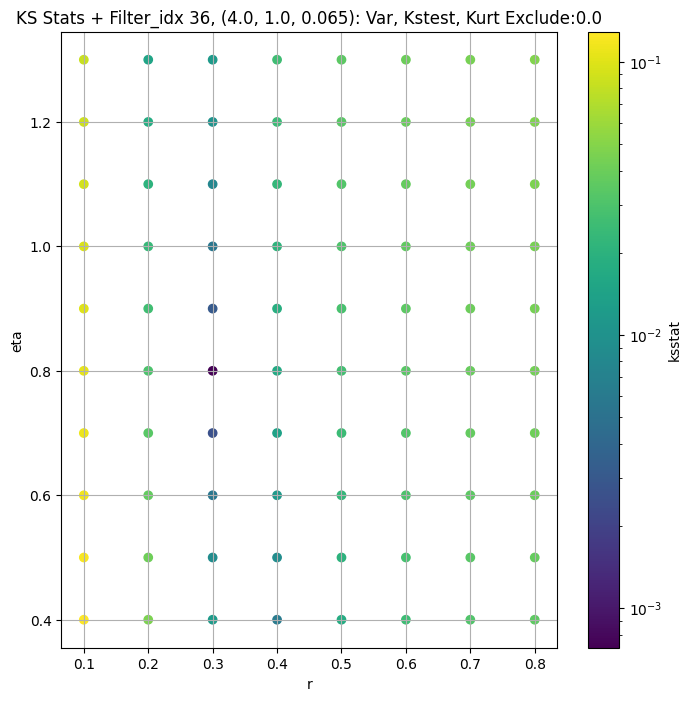

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.0017161228500311154 6.4984436


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.002255787384512903 6.1790266


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.0023915757310459286 5.997539


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.0038077490266781658 5.7246842
Number of samples: 100000, Without approximation : 16384000.0


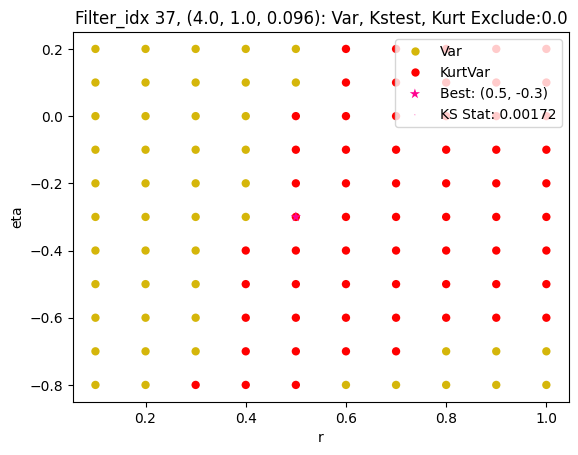

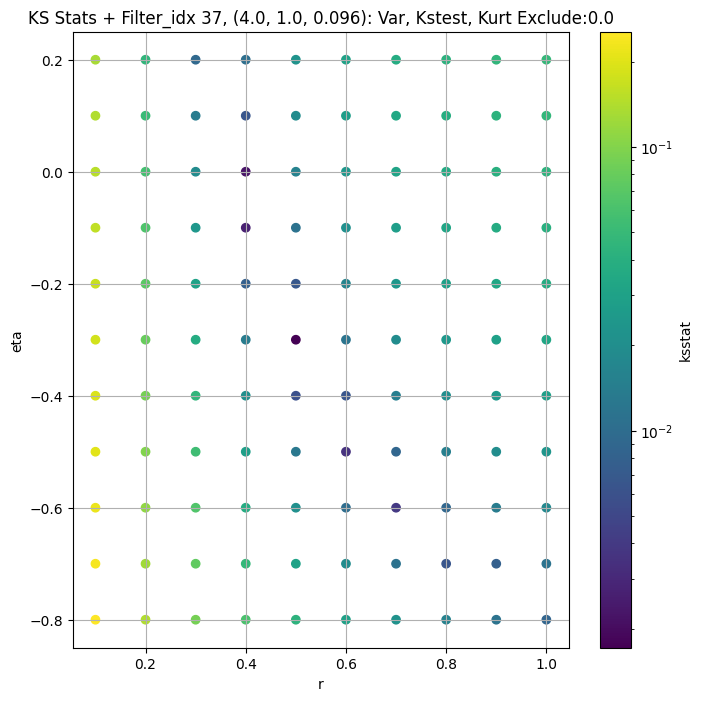

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.002065358386500557 2.5873678


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.0035430639232101324 2.4071403


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.0034171627203947175 2.31677


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.004091399631194981 2.185182
Number of samples: 100000, Without approximation : 16384000.0


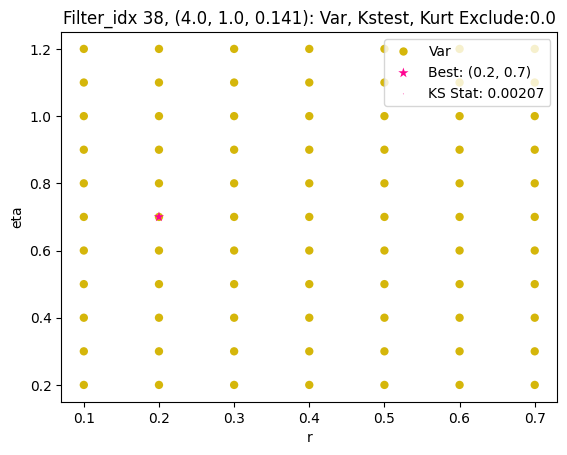

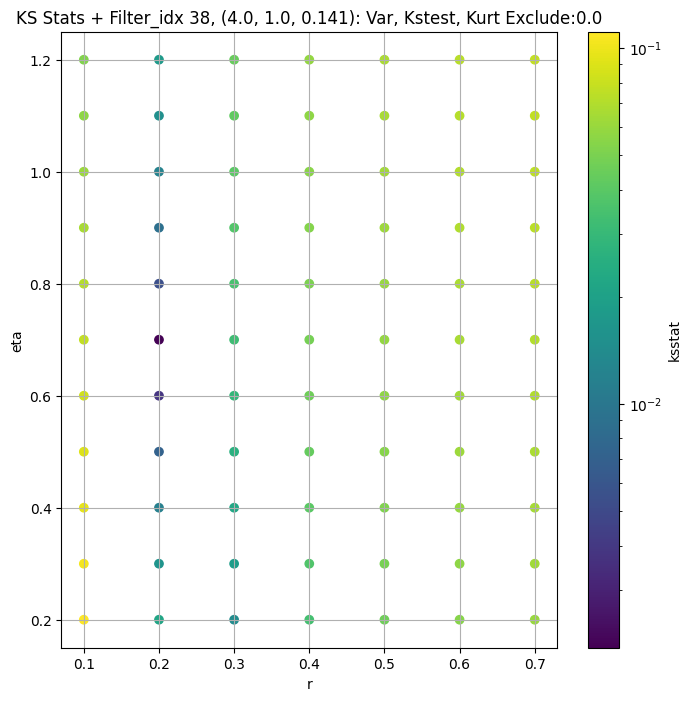

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.003167649762268576 0.95037735


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.003698204214236056 0.8818121


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.004581487936420103 0.845562


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.004972526916345227 0.7931447
Number of samples: 100000, Without approximation : 16384000.0


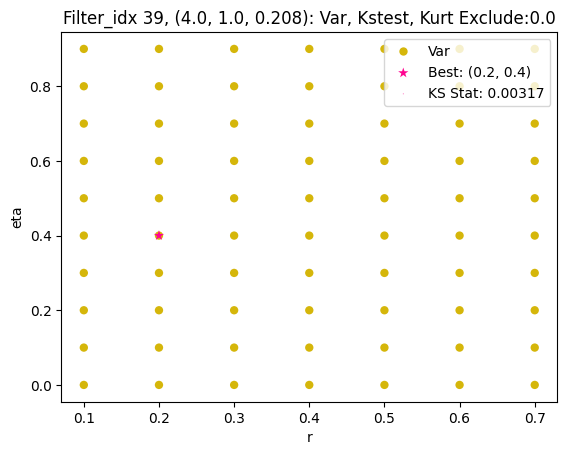

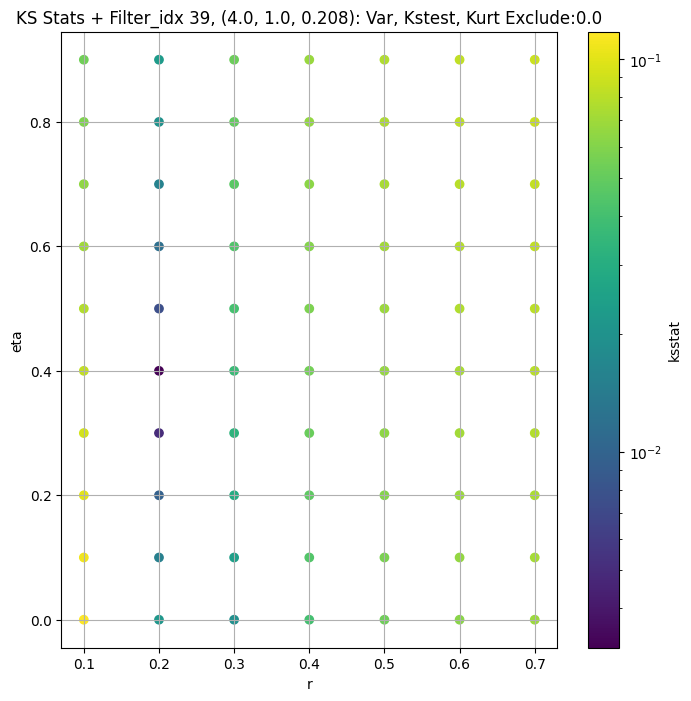

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.0038676499996320723 0.30052027


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.004100518018589905 0.2743244


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.005057790644307114 0.26131976


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.006232428419218922 0.24289133
Number of samples: 100000, Without approximation : 16384000.0


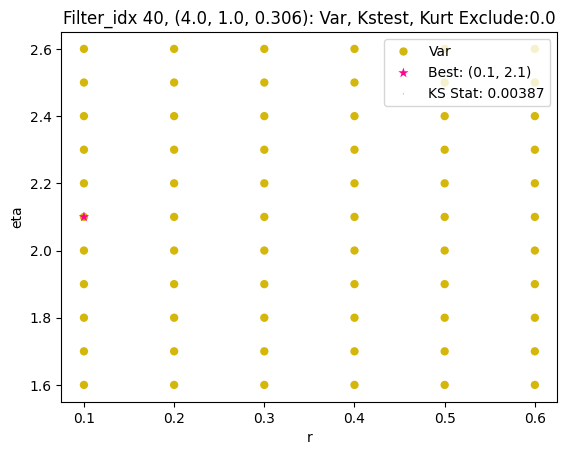

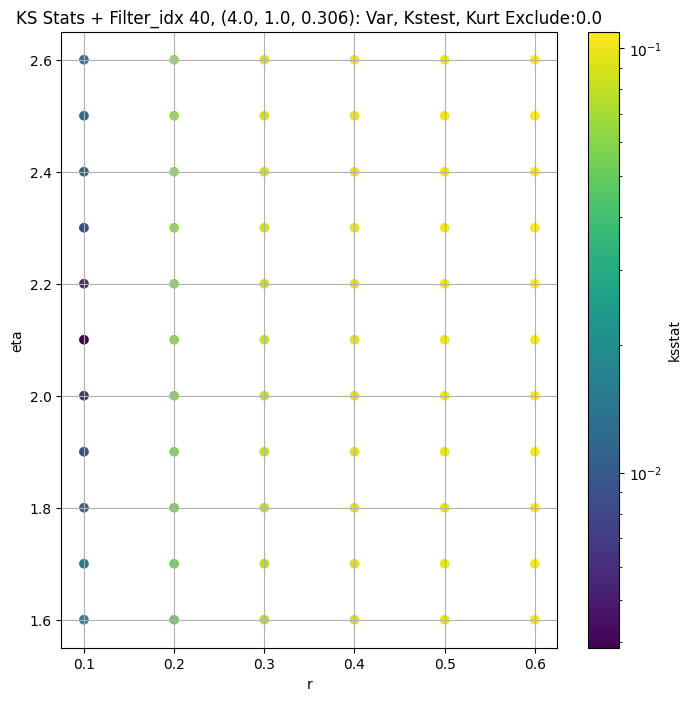

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.009305486117865289 0.07947232


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.006798291827767616 0.0695894


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.005344814199826076 0.06557873


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.004701807854396552 0.060175437
Number of samples: 100000, Without approximation : 16384000.0


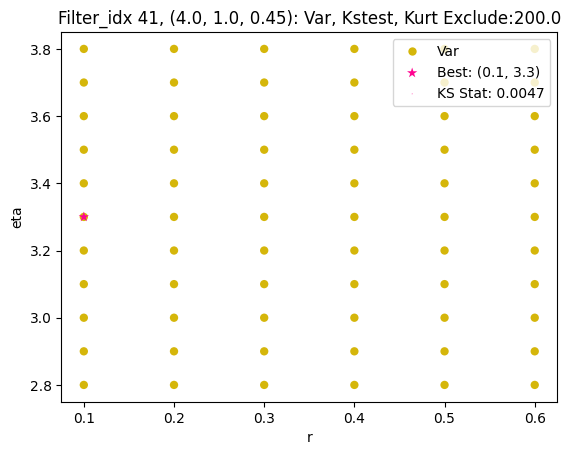

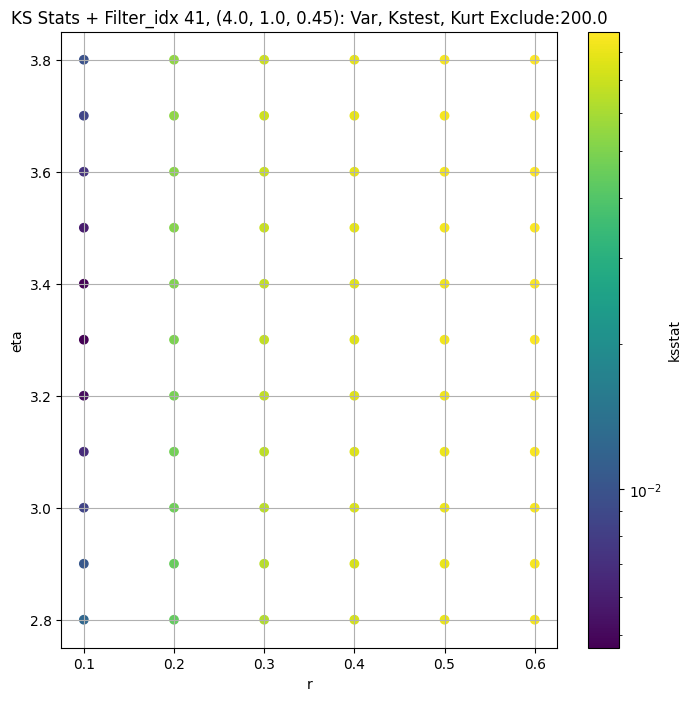

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",45.685776,36.681442,56.196175,4.554366,1.936449,13.453730,16384000.0,"(2.0, 0.5, 0.044)",0.001023,0.2,2.5,8.957152e-06,0.0,45.685776,0.000336
1,"(2.0, 0.5, 0.065)",18.020935,14.297063,22.832045,5.192763,2.020806,22.338587,16384000.0,"(2.0, 0.5, 0.065)",0.001461,0.7,-0.4,7.684188e+00,50.0,17.255861,0.000336
2,"(2.0, 0.5, 0.096)",6.863085,5.496876,8.647962,6.144894,2.256978,31.258554,16384000.0,"(2.0, 0.5, 0.096)",0.001335,0.5,-0.3,8.410643e-01,0.0,6.863085,0.000336
3,"(2.0, 0.5, 0.141)",2.609329,2.021814,3.562779,8.296274,2.903663,39.319584,16384000.0,"(2.0, 0.5, 0.141)",0.002179,0.4,-0.3,9.970157e-02,0.0,2.609329,0.000336
4,"(2.0, 0.5, 0.208)",0.958908,0.720444,1.315991,11.451014,3.967390,63.742058,16384000.0,"(2.0, 0.5, 0.208)",0.002308,0.3,-0.2,3.423856e-03,0.0,0.958908,0.000336
5,"(2.0, 0.5, 0.306)",0.279056,0.203140,0.397355,16.405006,3.913536,98.954480,16384000.0,"(2.0, 0.5, 0.306)",0.002863,0.2,0.4,1.441572e-06,0.0,0.279056,0.000336
6,"(2.0, 0.5, 0.45)",0.155727,0.112684,0.251911,20.012684,4.327563,133.719500,16384000.0,"(2.0, 0.5, 0.45)",0.002483,0.1,2.6,4.177677e-18,0.0,0.155727,0.000336
7,"(2.0, 1.0, 0.044)",59.564480,48.876278,73.659966,4.723526,2.010139,13.899191,16384000.0,"(2.0, 1.0, 0.044)",0.000634,0.1,7.2,1.455184e-18,0.0,59.564480,0.000336
8,"(2.0, 1.0, 0.065)",23.811407,19.124970,30.636597,5.541320,2.173217,28.138935,16384000.0,"(2.0, 1.0, 0.065)",0.000663,0.2,2.1,7.535065e-06,0.0,23.811407,0.000336


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.002948228088749949, var: 42.7258415222168


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.0024759135988454695, var: 43.262569427490234


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.001958954515650504, var: 43.86625289916992


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.0013510819952883071, var: 44.58195114135742


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.000920950900906381, var: 45.68577575683594
Number of samples: 100000, Without approximation : 16384000.0


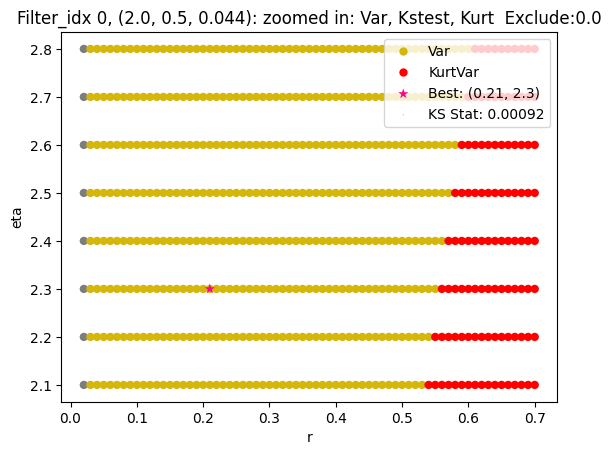

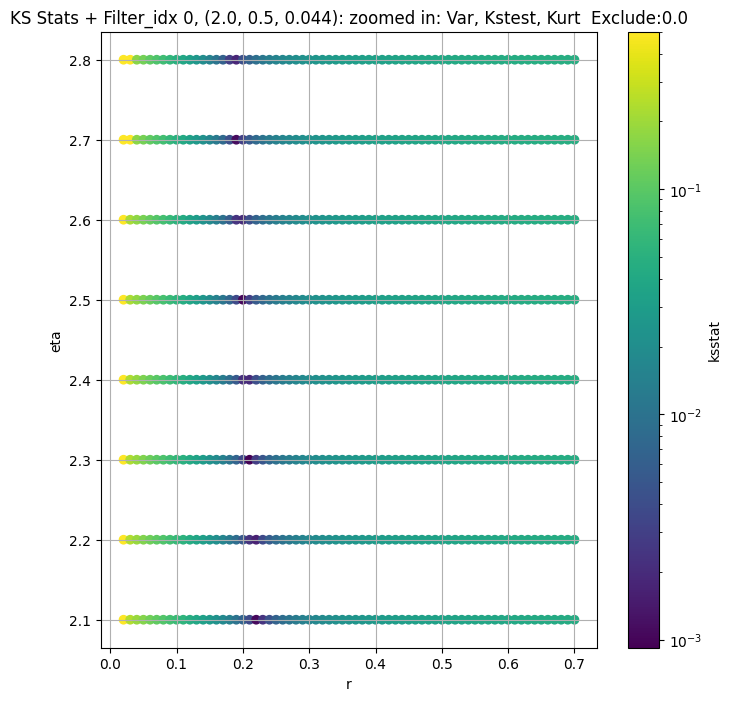

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 1, 50.0 + 100 = 150, ksstat: 0.0028656603802319665, var: 16.40777587890625


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 1, 50.0 + 75 = 125, ksstat: 0.002521221418076279, var: 16.592294692993164


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 1, 50.0 + 50 = 100, ksstat: 0.0021751795192529455, var: 16.791645050048828


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 1, 50.0 + 25 = 75, ksstat: 0.0017753488958295316, var: 17.010282516479492


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 1, 50.0 + 0 = 50, ksstat: 0.0013713595829835112, var: 17.255861282348633


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 1, 50.0 + -25 = 25, ksstat: 0.0009300780518223042, var: 17.547367095947266


  0%|          | 0/1710 [00:00<?, ?it/s]

Finding Minimum after computing 1710 CDFs
filter_idx 1, 50.0 + -50 = 0, ksstat: 0.0007711329901740616, var: 18.02093505859375
Number of samples: 100000, Without approximation : 16384000.0


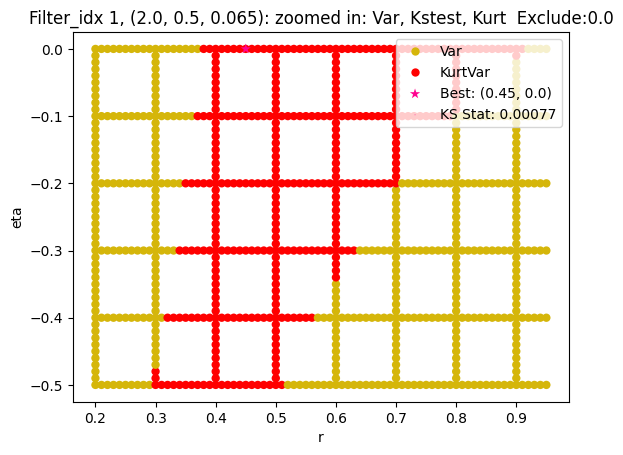

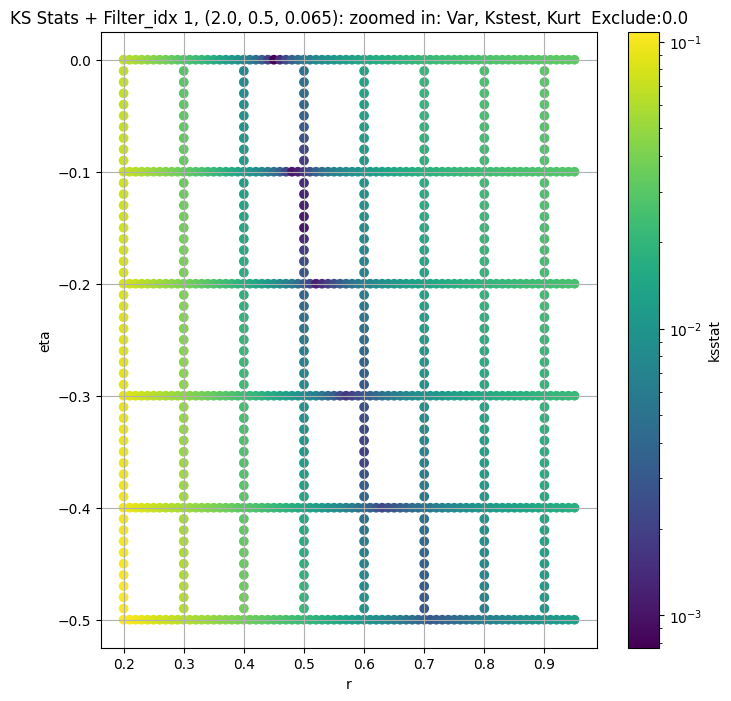

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 2, 0.0 + 100 = 100, ksstat: 0.0022441480936421267, var: 6.3526482582092285


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 2, 0.0 + 75 = 75, ksstat: 0.0018338365753247654, var: 6.439538478851318


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 2, 0.0 + 50 = 50, ksstat: 0.0014225789611020355, var: 6.538116931915283


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 2, 0.0 + 25 = 25, ksstat: 0.0009011429869374421, var: 6.657533645629883


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 2, 0.0 + 0 = 0, ksstat: 0.00024583587702453613, var: 6.86308479309082
Number of samples: 100000, Without approximation : 16384000.0


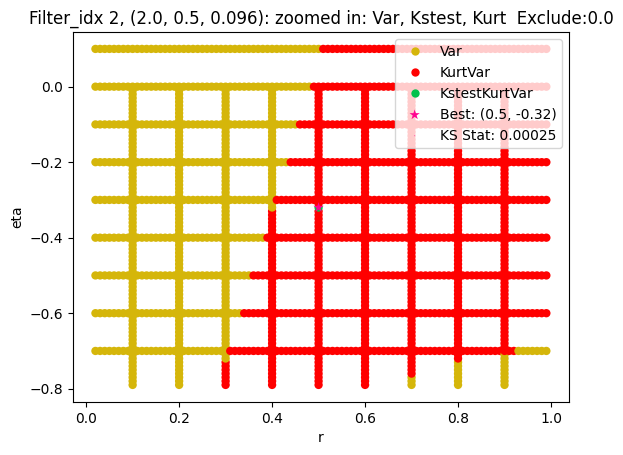

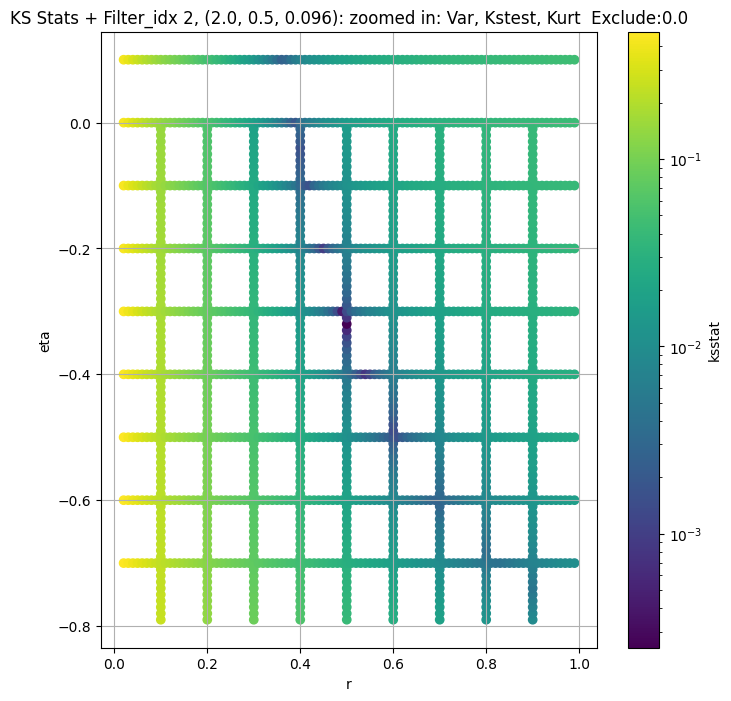

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.0026292758424733, var: 2.379793643951416


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.0021000472261393233, var: 2.417668104171753


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.0019875376296597524, var: 2.4611387252807617


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.0014649155932385804, var: 2.514530658721924


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.0009267381878388381, var: 2.609328508377075
Number of samples: 100000, Without approximation : 16384000.0


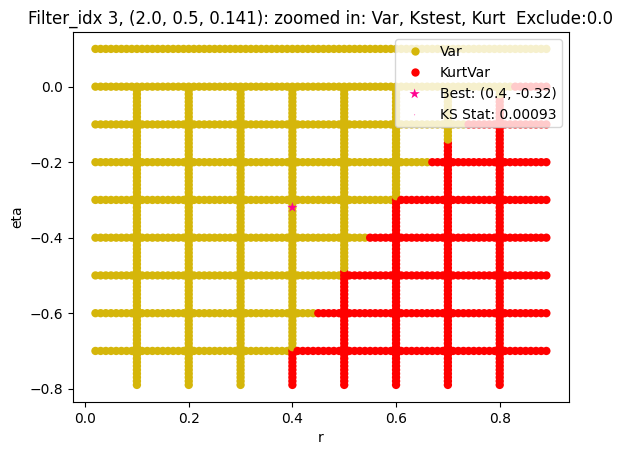

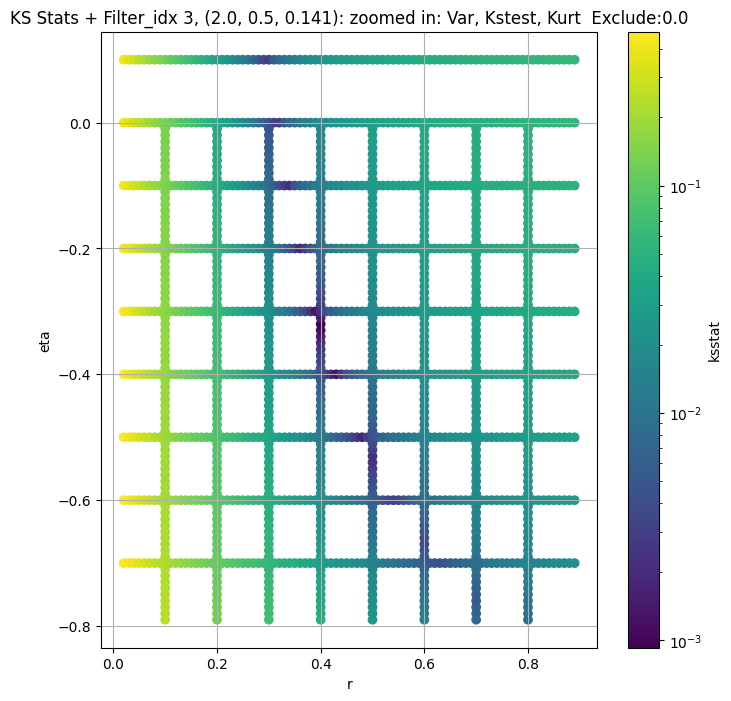

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 4, 0.0 + 100 = 100, ksstat: 0.00298549732337023, var: 0.8575946688652039


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 4, 0.0 + 75 = 75, ksstat: 0.0029096554121133267, var: 0.8734322786331177


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 4, 0.0 + 50 = 50, ksstat: 0.0023869746926340474, var: 0.8919896483421326


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 4, 0.0 + 25 = 25, ksstat: 0.002333687127729578, var: 0.9153661131858826


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 4, 0.0 + 0 = 0, ksstat: 0.001697282722065152, var: 0.9589083790779114
Number of samples: 100000, Without approximation : 16384000.0


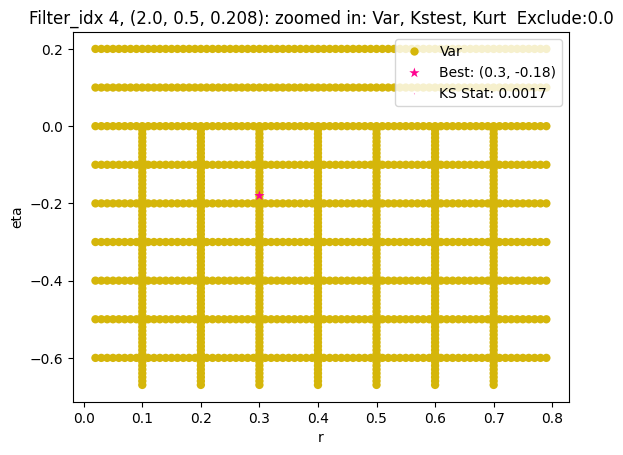

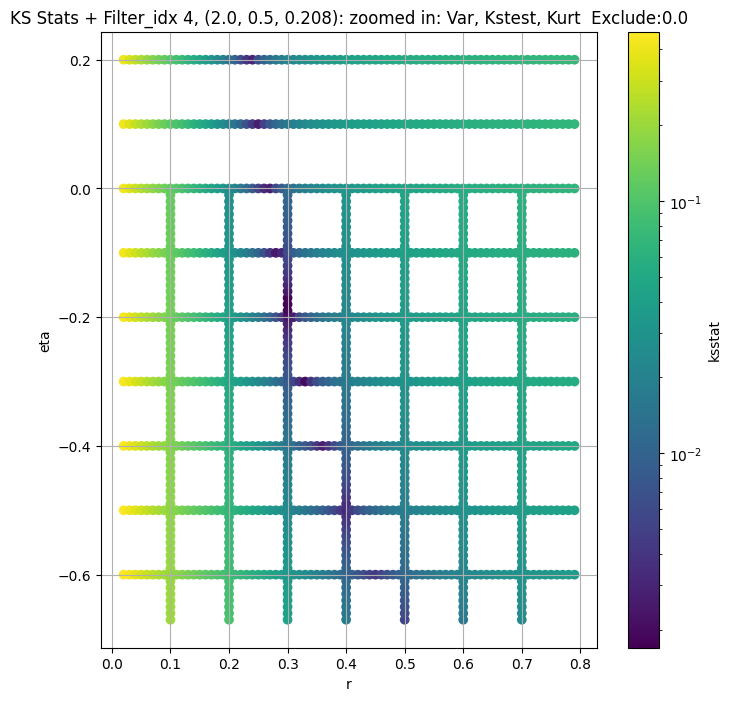

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.004251527929741927, var: 0.2440149039030075


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.00396617632283236, var: 0.24911528825759888


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.0031731291869666334, var: 0.25516700744628906


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.0028700061256051734, var: 0.2629941999912262


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.002121407288002808, var: 0.2790555953979492
Number of samples: 100000, Without approximation : 16384000.0


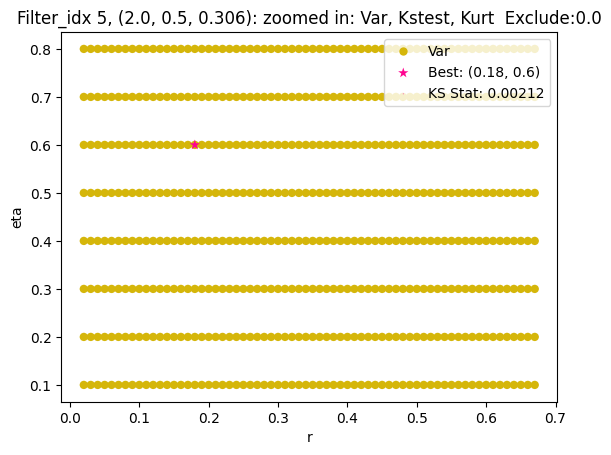

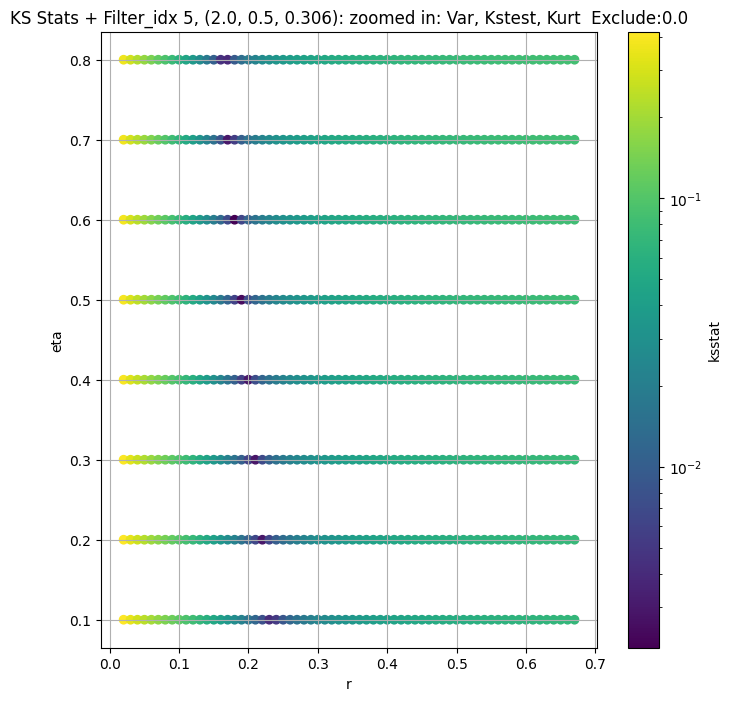

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 100 = 100, ksstat: 0.005592805514232357, var: 0.13459154963493347


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 75 = 75, ksstat: 0.005134516968559488, var: 0.13753199577331543


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 50 = 50, ksstat: 0.004487045022631642, var: 0.14105506241321564


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 25 = 25, ksstat: 0.003636707710489892, var: 0.14566782116889954


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 0 = 0, ksstat: 0.002323194417600871, var: 0.15572726726531982
Number of samples: 100000, Without approximation : 16384000.0


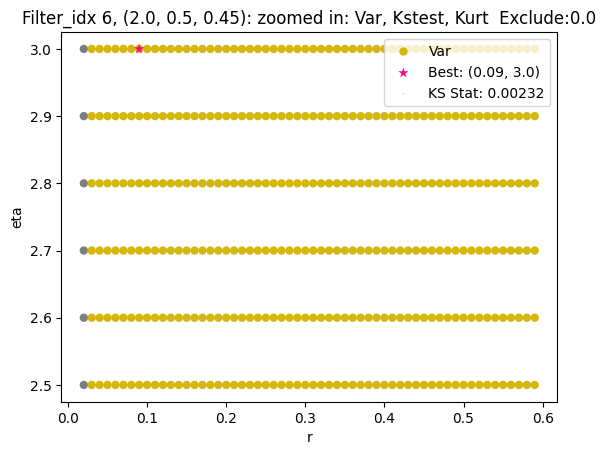

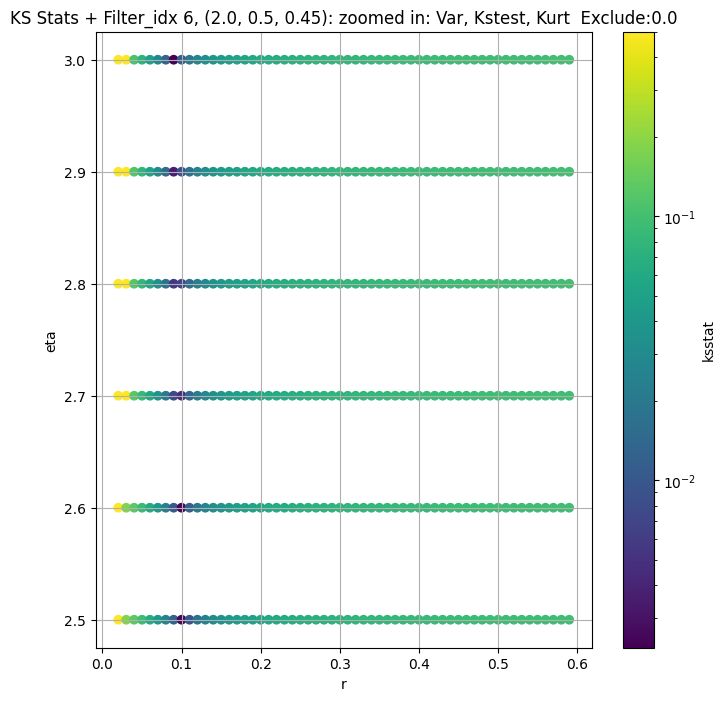

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.0028578360352221575, var: 55.57262420654297


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.002380608661581074, var: 56.292457580566406


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.0018428795708451545, var: 57.10820007324219


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.0013323950666281892, var: 58.07750701904297


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.0006336024787663708, var: 59.56447982788086
Number of samples: 100000, Without approximation : 16384000.0


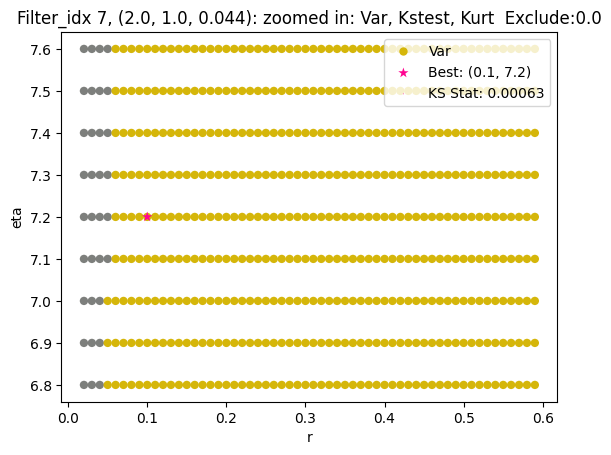

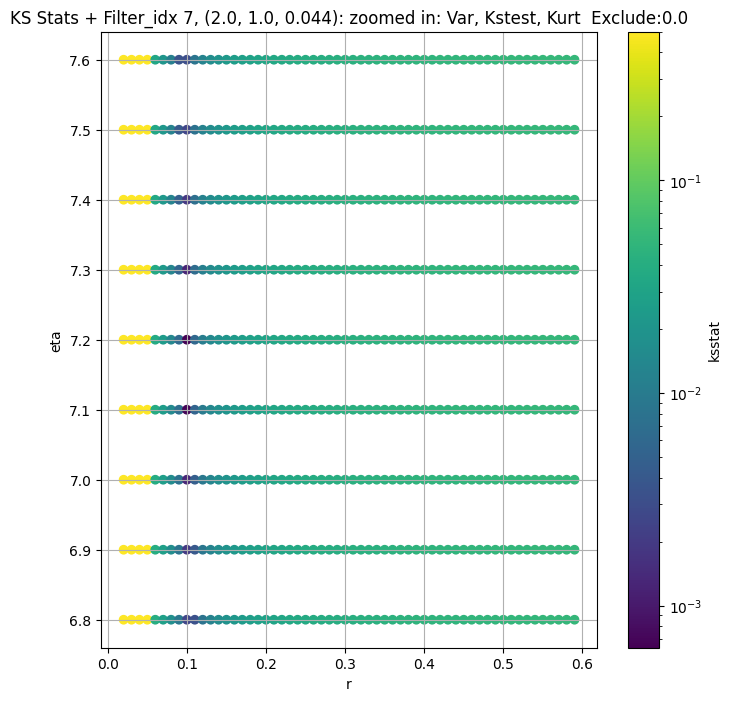

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 8, 0.0 + 100 = 100, ksstat: 0.0029438318150184495, var: 22.145112991333008


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 8, 0.0 + 75 = 75, ksstat: 0.002469867799148484, var: 22.43872833251953


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 8, 0.0 + 50 = 50, ksstat: 0.0019576337468429073, var: 22.76953887939453


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 8, 0.0 + 25 = 25, ksstat: 0.0013495534081771551, var: 23.163681030273438


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 8, 0.0 + 0 = 0, ksstat: 0.0005598847336453217, var: 23.8114070892334
Number of samples: 100000, Without approximation : 16384000.0


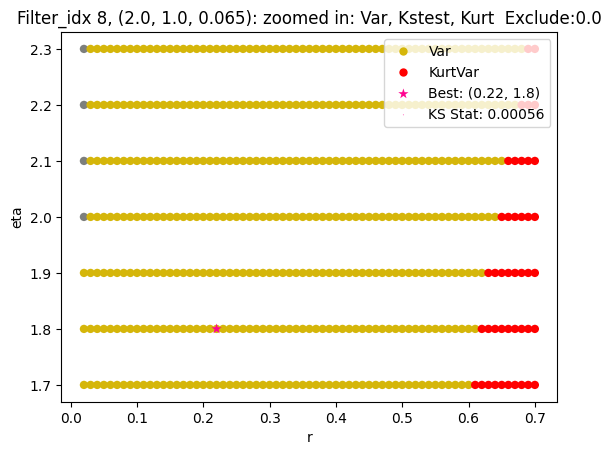

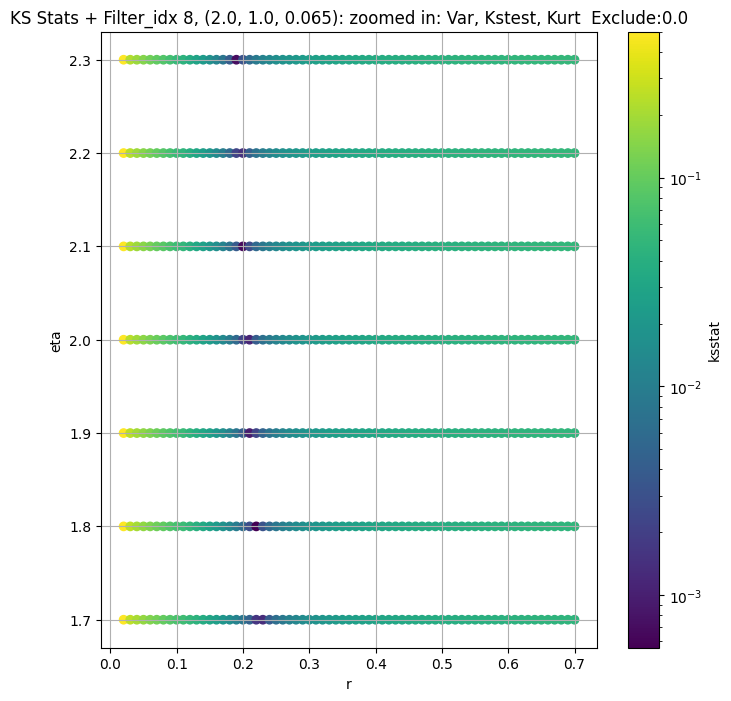

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 100 = 100, ksstat: 0.0029674700670205834, var: 8.67941665649414


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 75 = 75, ksstat: 0.0024419847415656504, var: 8.801252365112305


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 50 = 50, ksstat: 0.001887842825479491, var: 8.939737319946289


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 25 = 25, ksstat: 0.0012722289104046686, var: 9.105966567993164


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 0 = 0, ksstat: 0.00046349808004675364, var: 9.405064582824707
Number of samples: 100000, Without approximation : 16384000.0


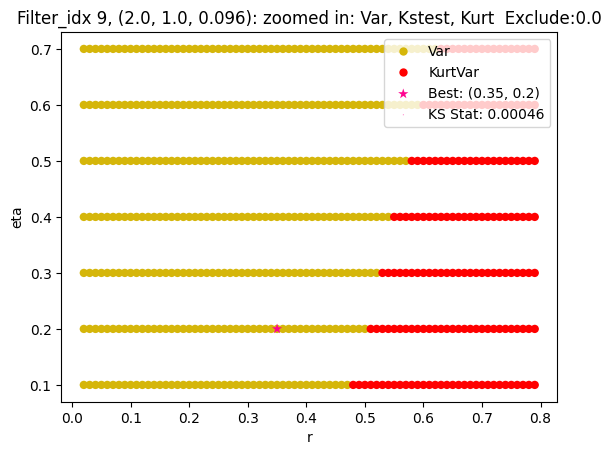

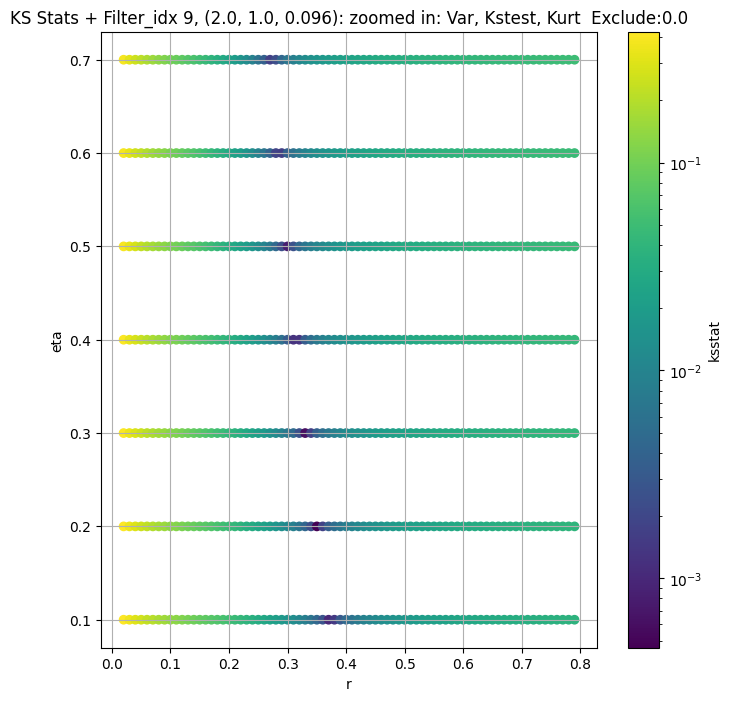

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.002646702532502987, var: 3.3378958702087402


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.002316041547667562, var: 3.3922712802886963


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.0016800371961580851, var: 3.455090045928955


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.0010915188832789635, var: 3.532132387161255


  0%|          | 0/954 [00:00<?, ?it/s]

Finding Minimum after computing 954 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.0005993569822185796, var: 3.6657111644744873
Number of samples: 100000, Without approximation : 16384000.0


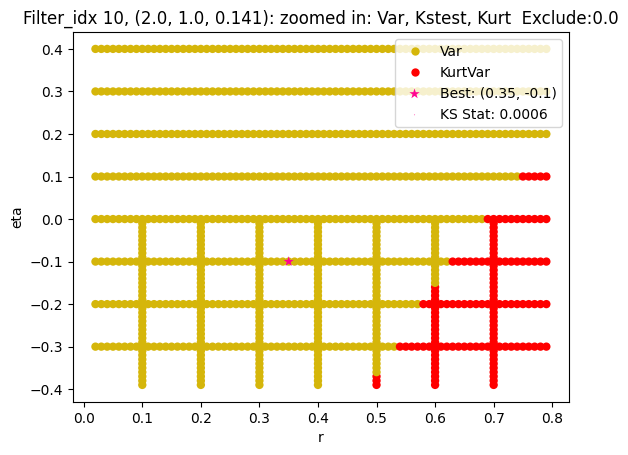

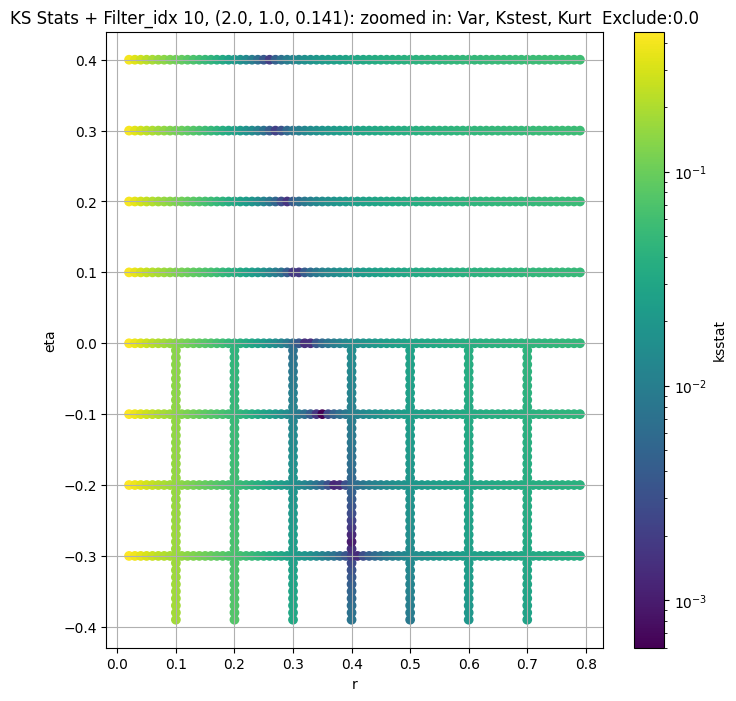

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.002919904118272948, var: 1.2114171981811523


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.002398793650504244, var: 1.233589768409729


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.002112719483603809, var: 1.2593297958374023


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.0016319812811927958, var: 1.2913036346435547


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.0012967707901687664, var: 1.3499298095703125
Number of samples: 100000, Without approximation : 16384000.0


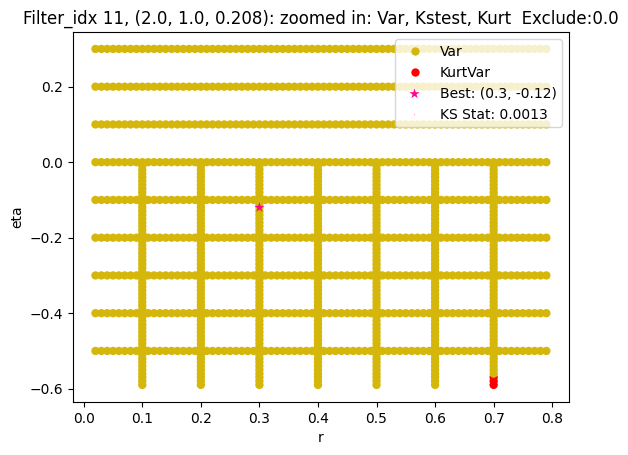

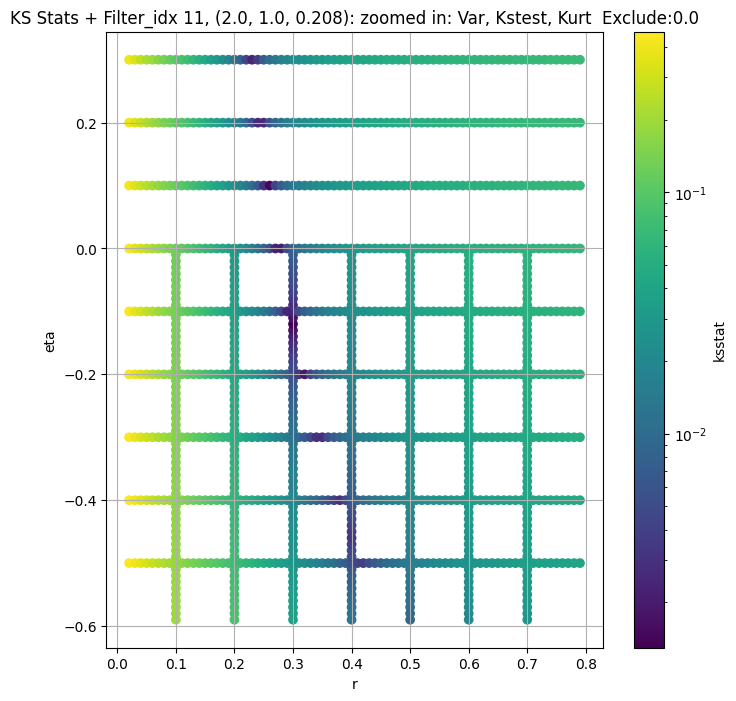

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.005989869298451356, var: 0.3968135118484497


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.005430445409977183, var: 0.4049764573574066


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.00470166589560761, var: 0.4146142899990082


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.0040047846340591775, var: 0.4269235134124756


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.0025564565082751844, var: 0.4517384469509125
Number of samples: 100000, Without approximation : 16384000.0


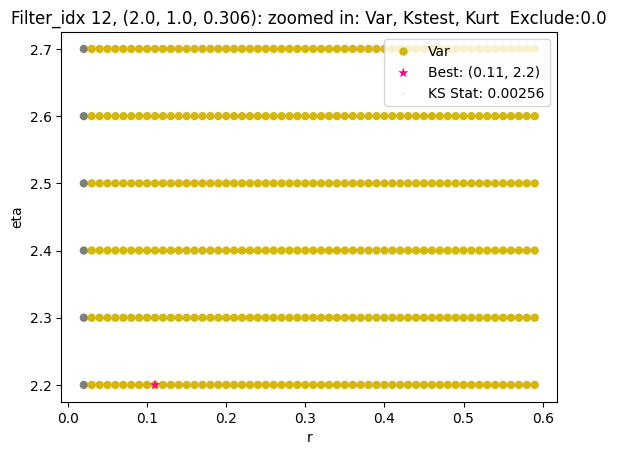

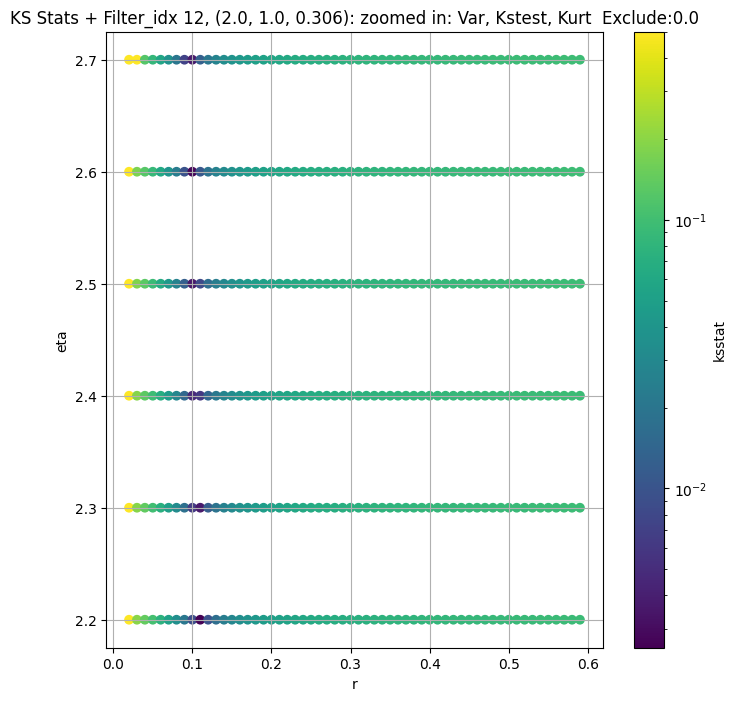

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 100 = 150, ksstat: 0.0056737569659467135, var: 0.13611222803592682


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 75 = 125, ksstat: 0.0052217388924519215, var: 0.138697549700737


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 50 = 100, ksstat: 0.004648111660252877, var: 0.1415904313325882


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 25 = 75, ksstat: 0.003998857637082964, var: 0.14490608870983124


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + 0 = 50, ksstat: 0.003386208288165049, var: 0.14887648820877075


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + -25 = 25, ksstat: 0.0025878641688868997, var: 0.1540546715259552


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 50.0 + -50 = 0, ksstat: 0.0025940681591238024, var: 0.16542232036590576
Number of samples: 100000, Without approximation : 16384000.0


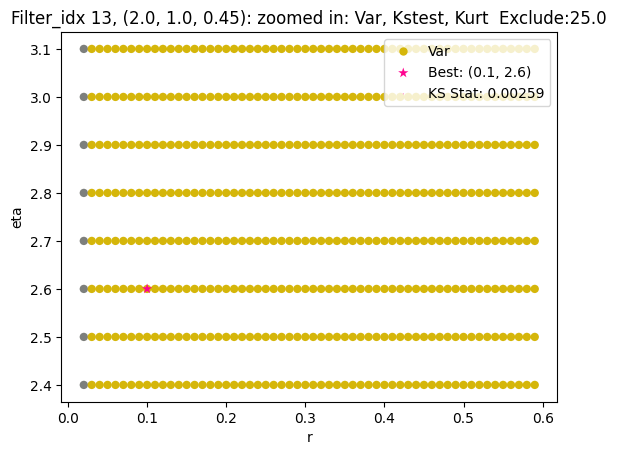

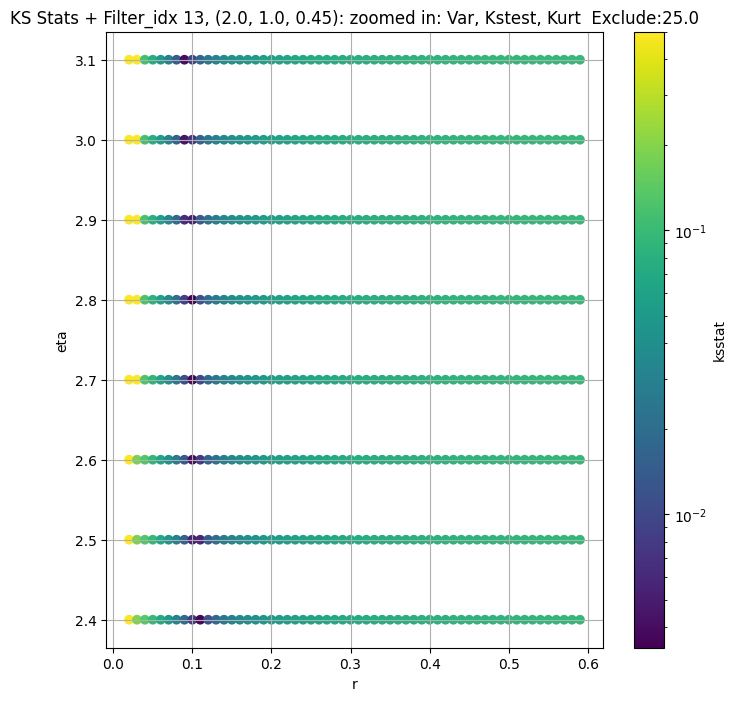

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.0026259724301410103, var: 39.98008346557617


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.002167427694429947, var: 40.49786376953125


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.0016725216583665312, var: 41.08235168457031


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.001123505427076104, var: 41.781429290771484


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.0008129979670984389, var: 42.8891716003418
Number of samples: 100000, Without approximation : 16384000.0


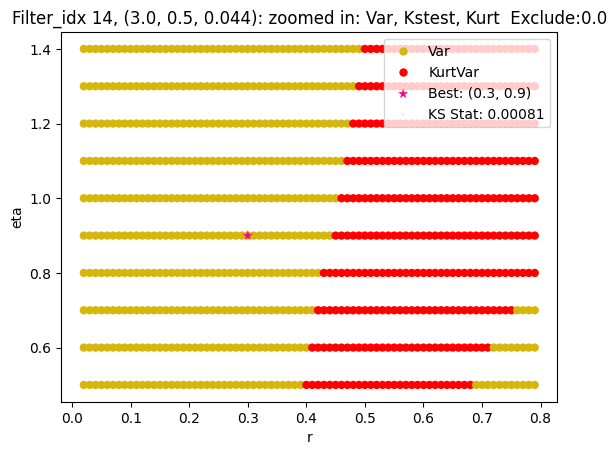

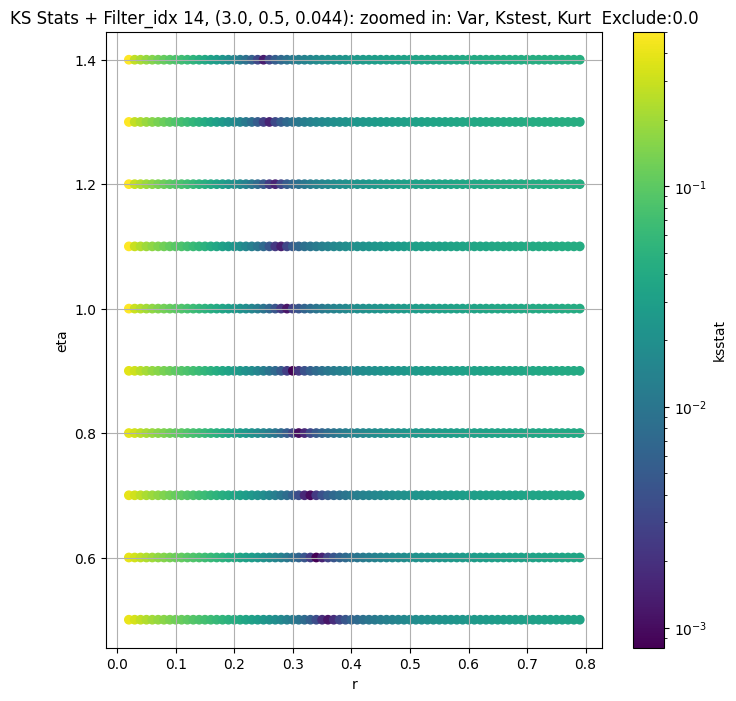

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 15, 0.0 + 100 = 100, ksstat: 0.002366041653207307, var: 15.639998435974121


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 15, 0.0 + 75 = 75, ksstat: 0.0019837516909047073, var: 15.862388610839844


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 15, 0.0 + 50 = 50, ksstat: 0.001542004416146714, var: 16.114778518676758


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 15, 0.0 + 25 = 25, ksstat: 0.00106464979611276, var: 16.419952392578125


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 15, 0.0 + 0 = 0, ksstat: 0.00039844845564929177, var: 16.92855453491211
Number of samples: 100000, Without approximation : 16384000.0


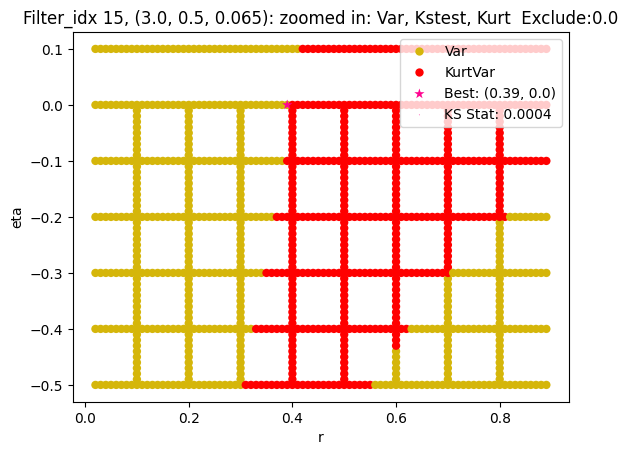

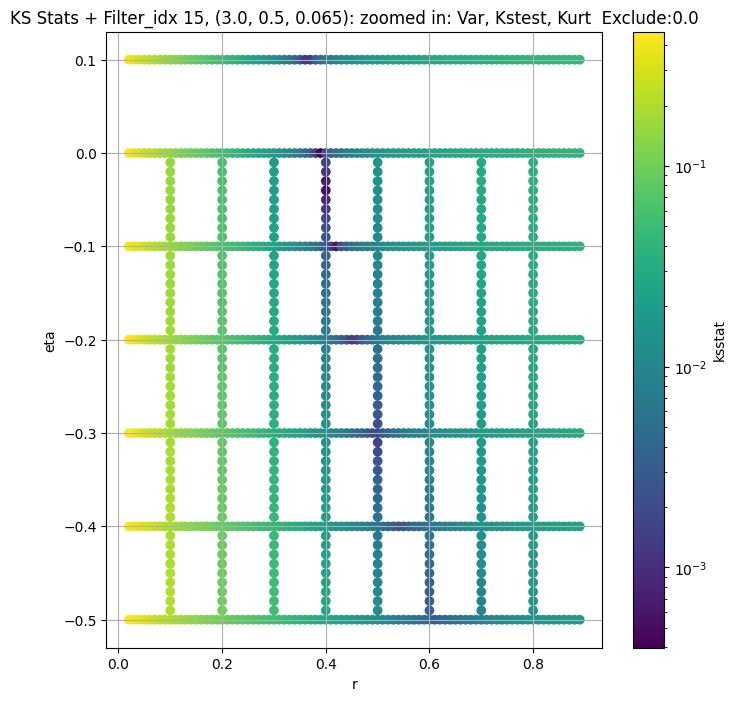

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 16, 0.0 + 100 = 100, ksstat: 0.00261017315083412, var: 6.037353515625


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 16, 0.0 + 75 = 75, ksstat: 0.0022178740113380294, var: 6.127833843231201


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 16, 0.0 + 50 = 50, ksstat: 0.0018541593847235527, var: 6.230718612670898


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 16, 0.0 + 25 = 25, ksstat: 0.0013607067549289975, var: 6.354529857635498


  0%|          | 0/1368 [00:00<?, ?it/s]

Finding Minimum after computing 1368 CDFs
filter_idx 16, 0.0 + 0 = 0, ksstat: 0.0012187832921460862, var: 6.5611162185668945
Number of samples: 100000, Without approximation : 16384000.0


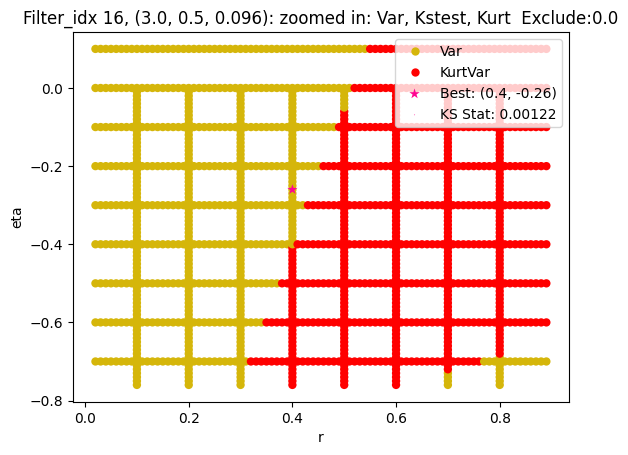

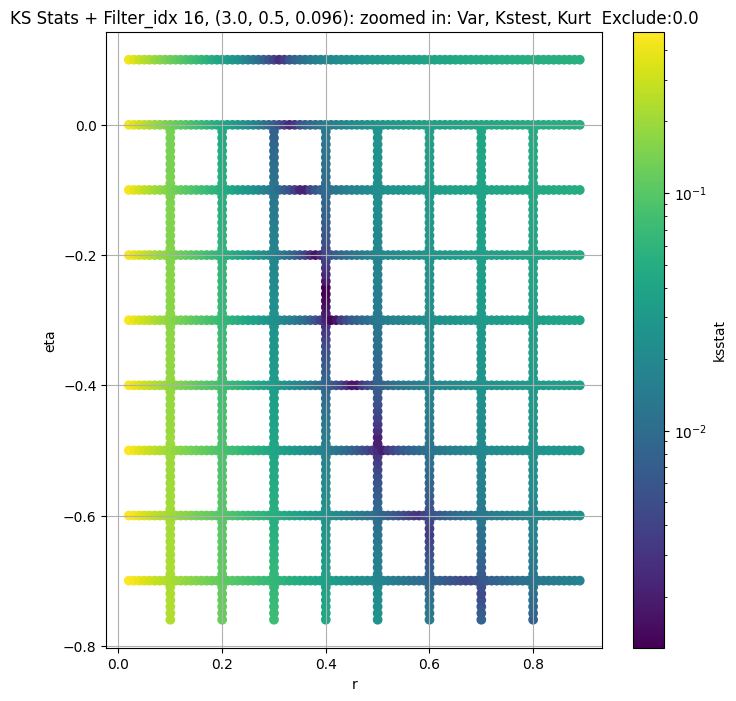

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.0032487115367222374, var: 2.197500228881836


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.0028905383192643908, var: 2.235456705093384


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.0027184071368542284, var: 2.2790470123291016


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.002167512329163901, var: 2.3324265480041504


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.002142901839125494, var: 2.427760362625122
Number of samples: 100000, Without approximation : 16384000.0


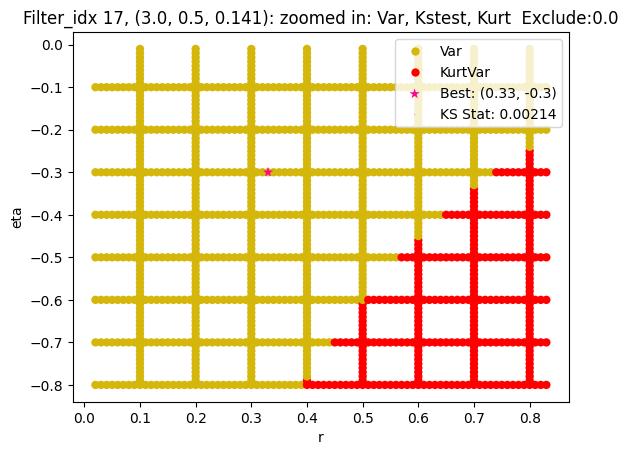

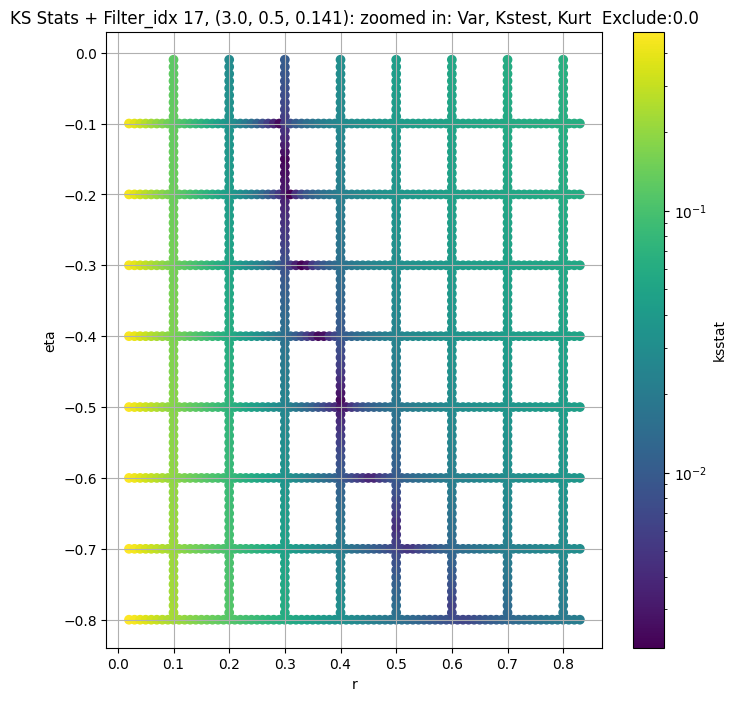

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.005193921295569615, var: 0.7689350843429565


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.004767846423500255, var: 0.7813674807548523


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.0044902181602846855, var: 0.7950353622436523


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.004302052456527573, var: 0.8103941679000854


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.004168163031637931, var: 0.8282111883163452


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.0037180451281429994, var: 0.8502972722053528


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.0036441352374189107, var: 0.891442060470581
Number of samples: 100000, Without approximation : 16384000.0


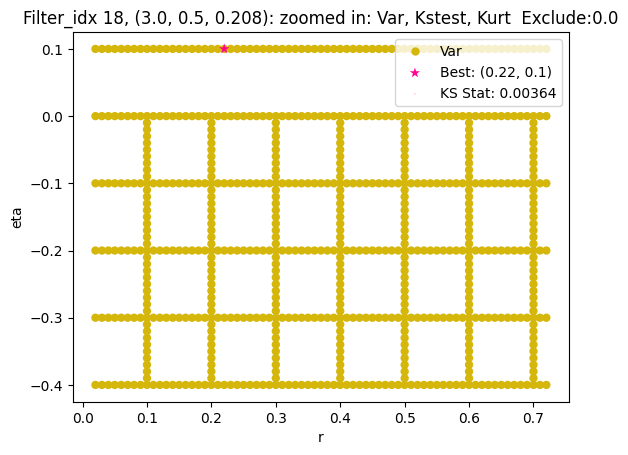

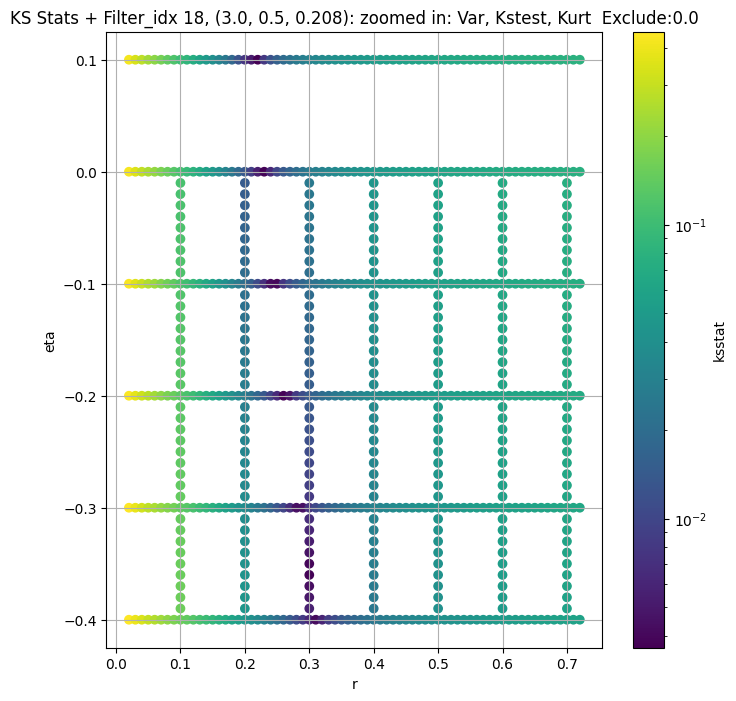

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.005723810418830411, var: 0.23987814784049988


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.005204096259215363, var: 0.24521832168102264


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.004592142209405736, var: 0.2514819800853729


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.0039673135451568295, var: 0.25941404700279236


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.0029977541335685087, var: 0.27487868070602417
Number of samples: 100000, Without approximation : 16384000.0


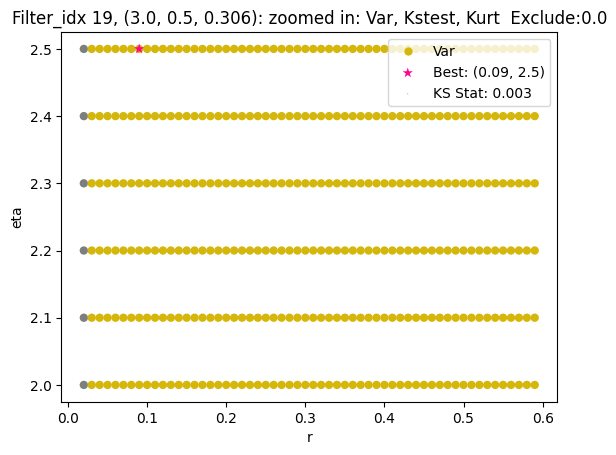

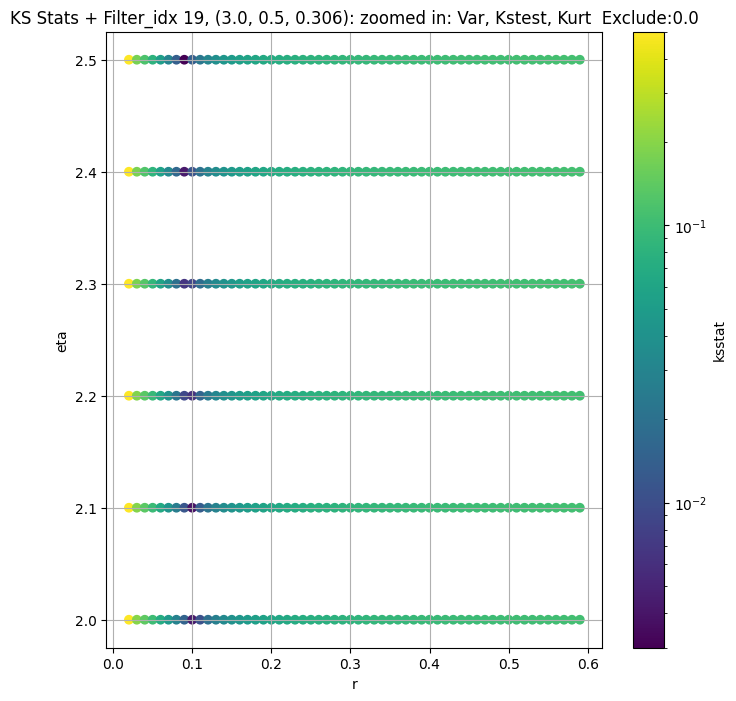

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 100 = 200, ksstat: 0.005794273690570971, var: 0.07016221433877945


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 75 = 175, ksstat: 0.005363922397267202, var: 0.07143464684486389


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 50 = 150, ksstat: 0.005012239028123422, var: 0.07282307744026184


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 25 = 125, ksstat: 0.0045310699935389165, var: 0.07435374706983566


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + 0 = 100, ksstat: 0.004013290072885825, var: 0.07607010751962662


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + -25 = 75, ksstat: 0.0036800998380750183, var: 0.078037790954113


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + -50 = 50, ksstat: 0.004299132076484552, var: 0.08038508147001266


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + -75 = 25, ksstat: 0.005126870215919177, var: 0.08343738317489624


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 100.0 + -100 = 0, ksstat: 0.005913010589463474, var: 0.08999340981245041
Number of samples: 100000, Without approximation : 16384000.0


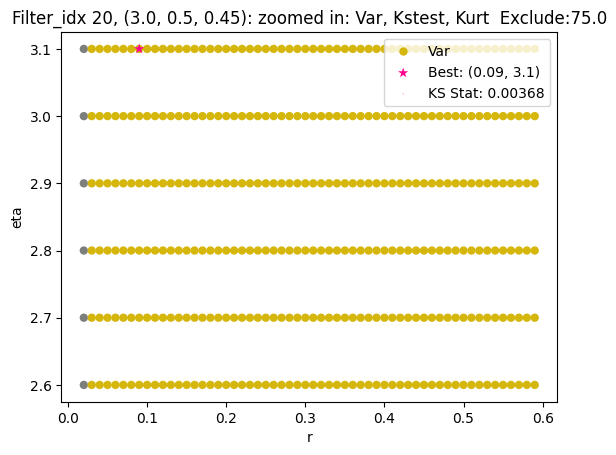

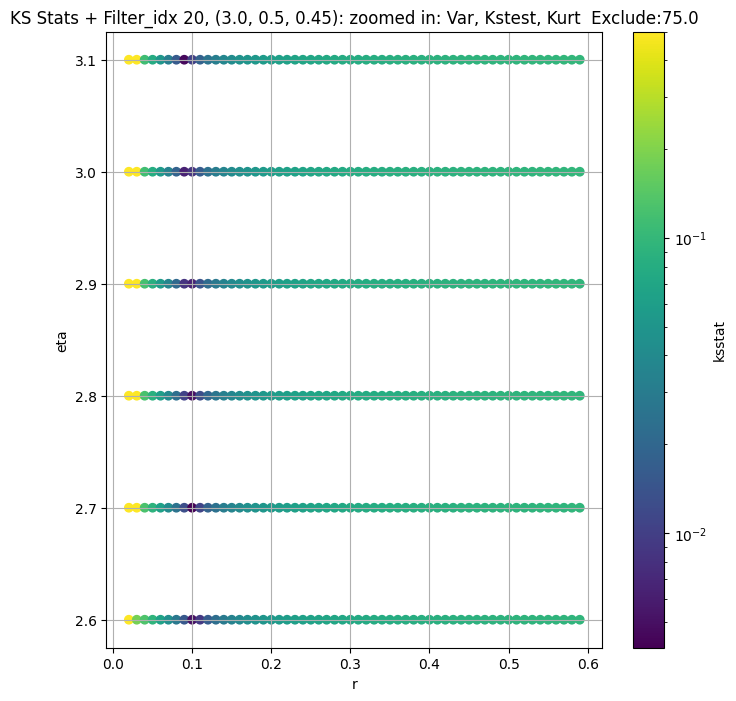

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 0.0 + 100 = 100, ksstat: 0.0025255690090953443, var: 46.7076416015625


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 0.0 + 75 = 75, ksstat: 0.0020241485759024958, var: 47.328025817871094


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 0.0 + 50 = 50, ksstat: 0.001485442189460895, var: 48.036861419677734


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 0.0 + 25 = 25, ksstat: 0.0009023403118452178, var: 48.88768005371094


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 0.0 + 0 = 0, ksstat: 0.0006752665597825613, var: 50.2525749206543
Number of samples: 100000, Without approximation : 16384000.0


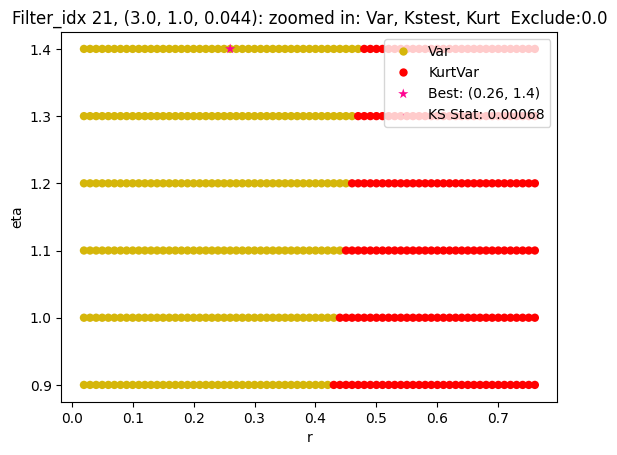

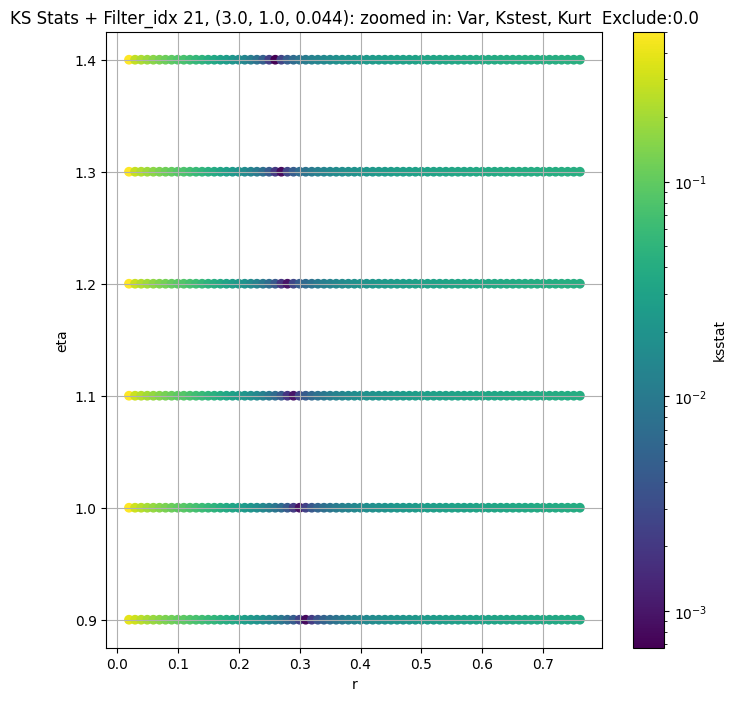

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.002180965412309832, var: 17.746112823486328


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.0016970262380411327, var: 18.00010108947754


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.0012395634577958559, var: 18.291624069213867


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.0007367799909405726, var: 18.64629364013672


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.0008224864381037866, var: 19.2473201751709
Number of samples: 100000, Without approximation : 16384000.0


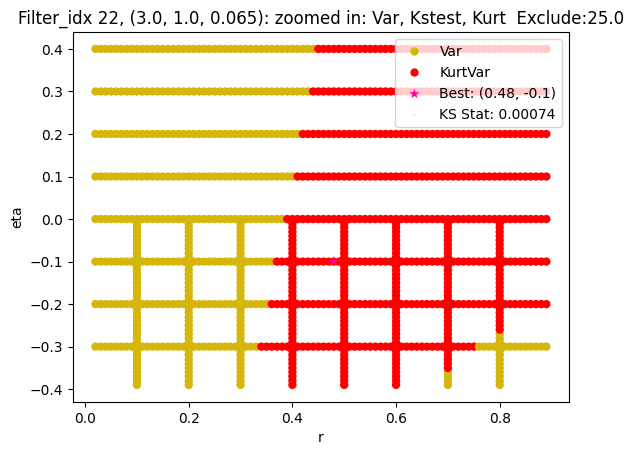

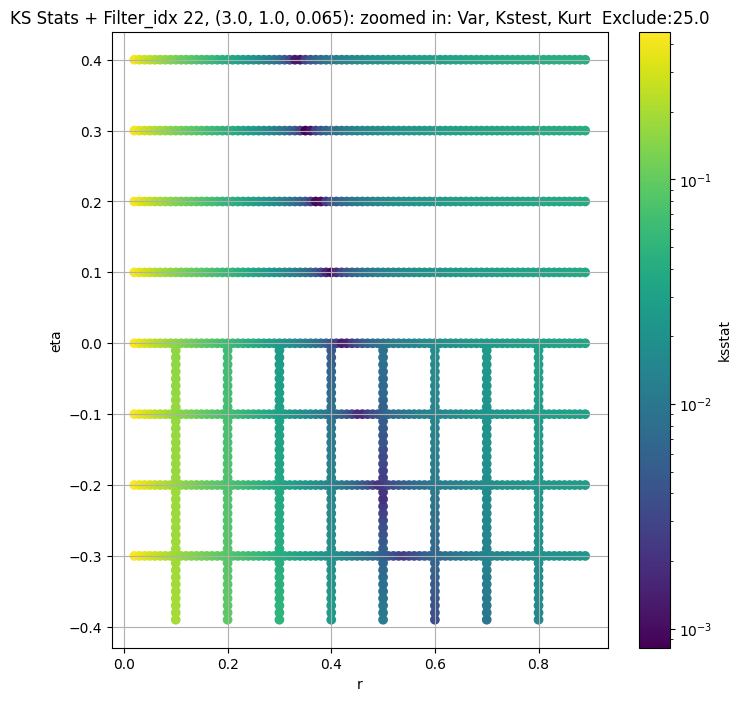

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.00291609786642566, var: 6.9385247230529785


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.0023576170527440446, var: 7.048730373382568


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.0017564207594992463, var: 7.17551851272583


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.001105151615933192, var: 7.330540180206299


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.00035197513155982296, var: 7.60453987121582
Number of samples: 100000, Without approximation : 16384000.0


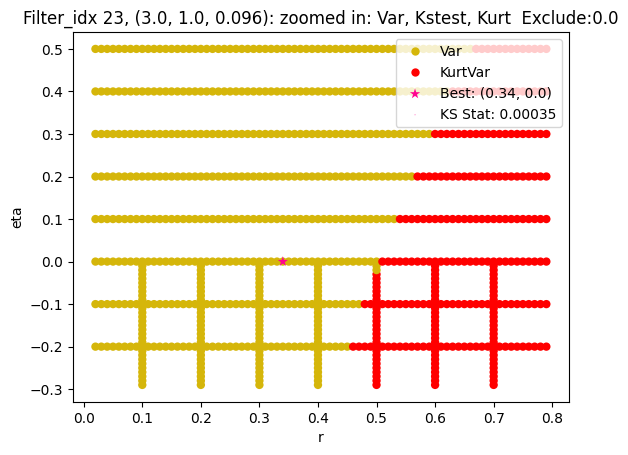

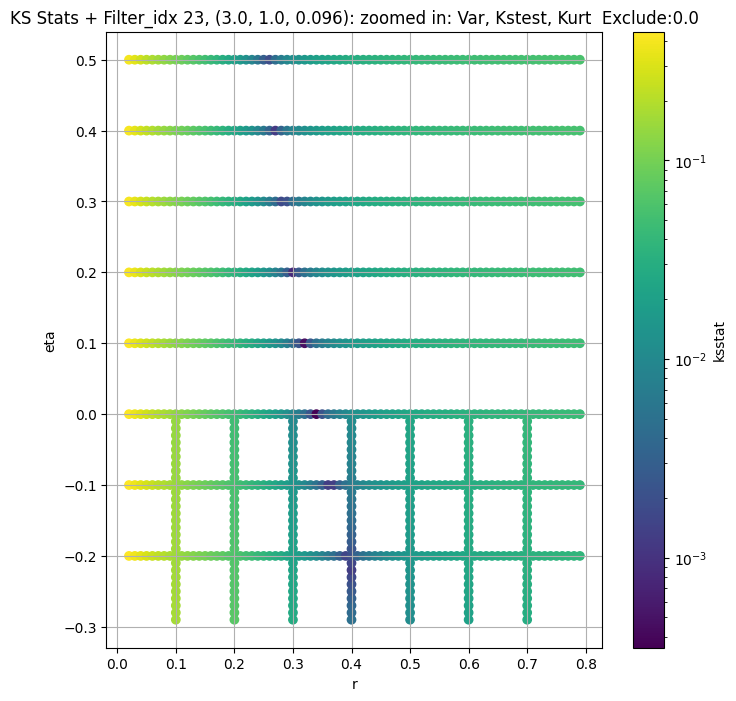

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.002955997906211382, var: 2.6263670921325684


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.002719994280948601, var: 2.673511266708374


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.002361471728206596, var: 2.72794771194458


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.0020208071787535253, var: 2.79487681388855


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.0013276411869952986, var: 2.9192049503326416
Number of samples: 100000, Without approximation : 16384000.0


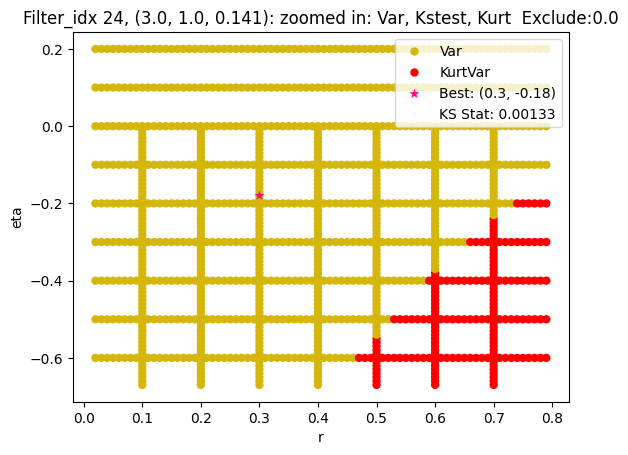

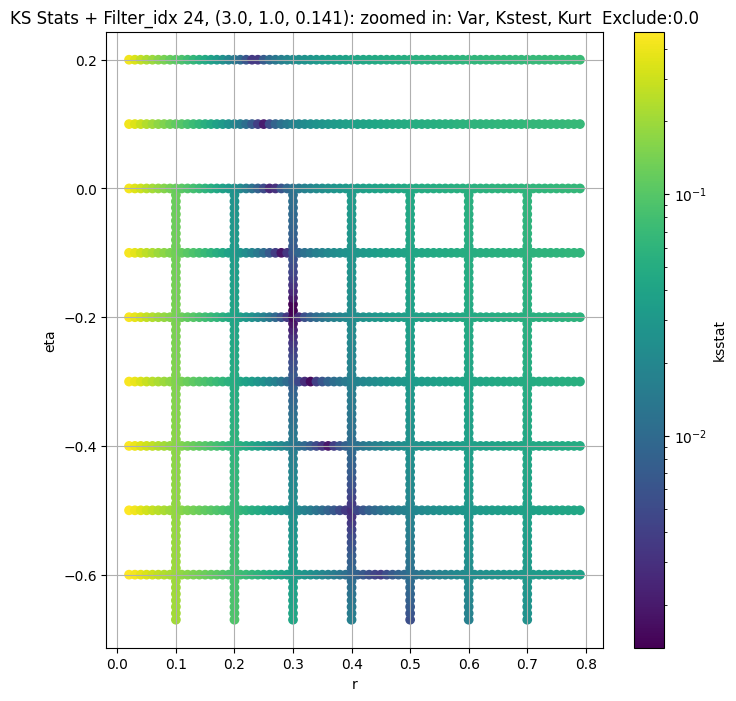

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 25, 0.0 + 100 = 100, ksstat: 0.004596832288226271, var: 0.9582659006118774


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 25, 0.0 + 75 = 75, ksstat: 0.00399057625323862, var: 0.9778083562850952


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 25, 0.0 + 50 = 50, ksstat: 0.003911345200543918, var: 1.0005598068237305


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 25, 0.0 + 25 = 25, ksstat: 0.0031556549055248295, var: 1.0288984775543213


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 25, 0.0 + 0 = 0, ksstat: 0.0024604103529773935, var: 1.0830297470092773
Number of samples: 100000, Without approximation : 16384000.0


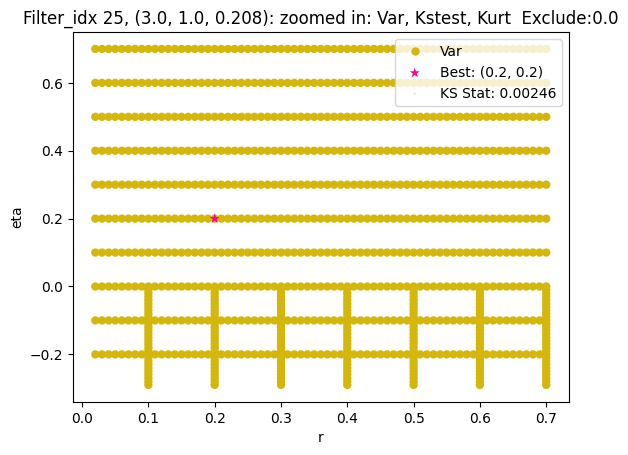

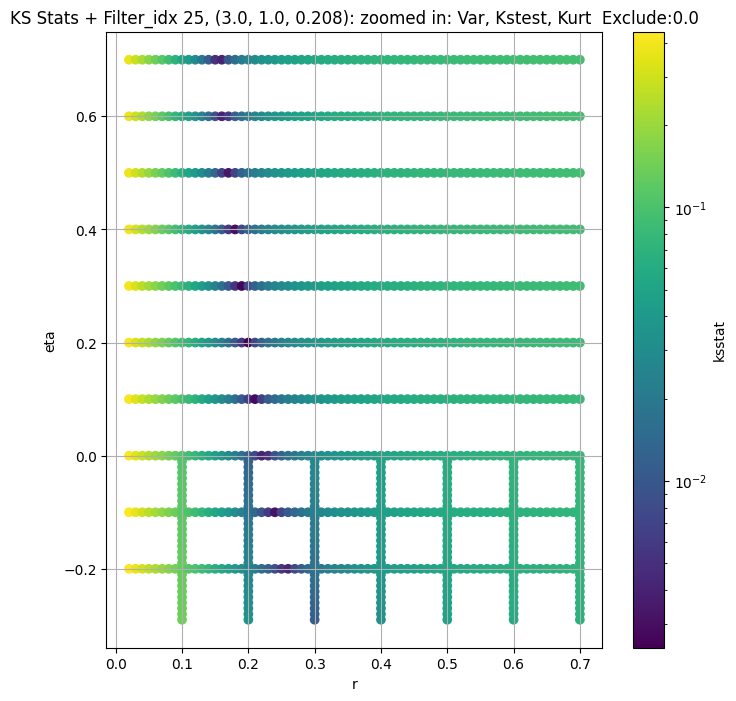

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 50.0 + 100 = 150, ksstat: 0.00622943053048175, var: 0.28588974475860596


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 50.0 + 75 = 125, ksstat: 0.005821992975622109, var: 0.2915343940258026


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 50.0 + 50 = 100, ksstat: 0.005546365642622786, var: 0.2978000044822693


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 50.0 + 25 = 75, ksstat: 0.004904430051847403, var: 0.3049032986164093


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 50.0 + 0 = 50, ksstat: 0.004302074869679817, var: 0.3132469952106476


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 50.0 + -25 = 25, ksstat: 0.0035758123110628884, var: 0.32386958599090576


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 50.0 + -50 = 0, ksstat: 0.004809530854496785, var: 0.34488001465797424
Number of samples: 100000, Without approximation : 16384000.0


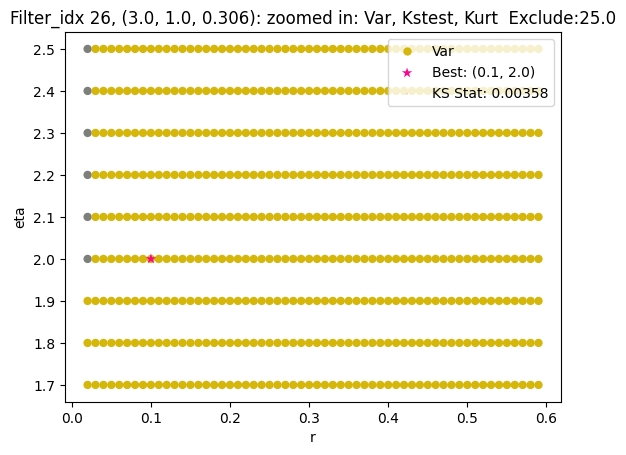

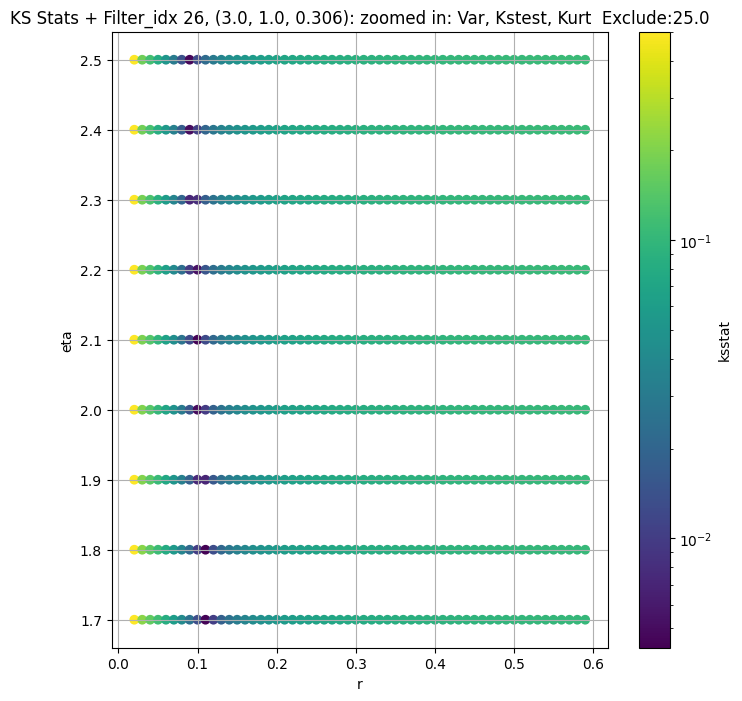

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + 100 = 200, ksstat: 0.00520378856865257, var: 0.0748014748096466


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + 75 = 175, ksstat: 0.004868463901667508, var: 0.07619617879390717


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + 50 = 150, ksstat: 0.0044179581683959634, var: 0.07771717011928558


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + 25 = 125, ksstat: 0.004697438051503244, var: 0.07939703017473221


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + 0 = 100, ksstat: 0.004900620780245335, var: 0.08128587156534195


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + -25 = 75, ksstat: 0.005255880343448149, var: 0.08346843719482422


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + -50 = 50, ksstat: 0.005445097757083461, var: 0.08610899746417999


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + -75 = 25, ksstat: 0.006328918967659525, var: 0.08959705382585526


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 100.0 + -100 = 0, ksstat: 0.007455920315701414, var: 0.09697405993938446
Number of samples: 100000, Without approximation : 16384000.0


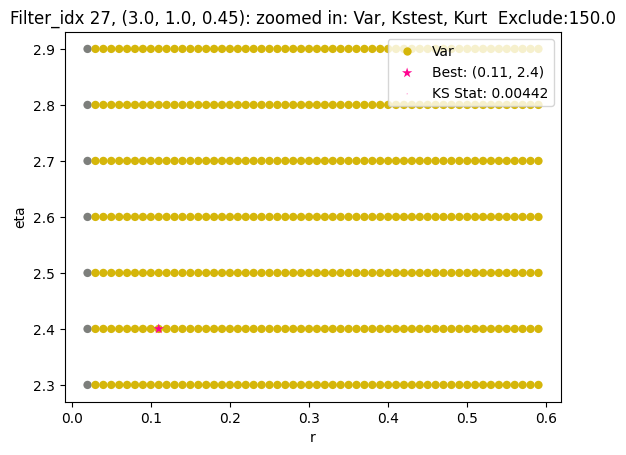

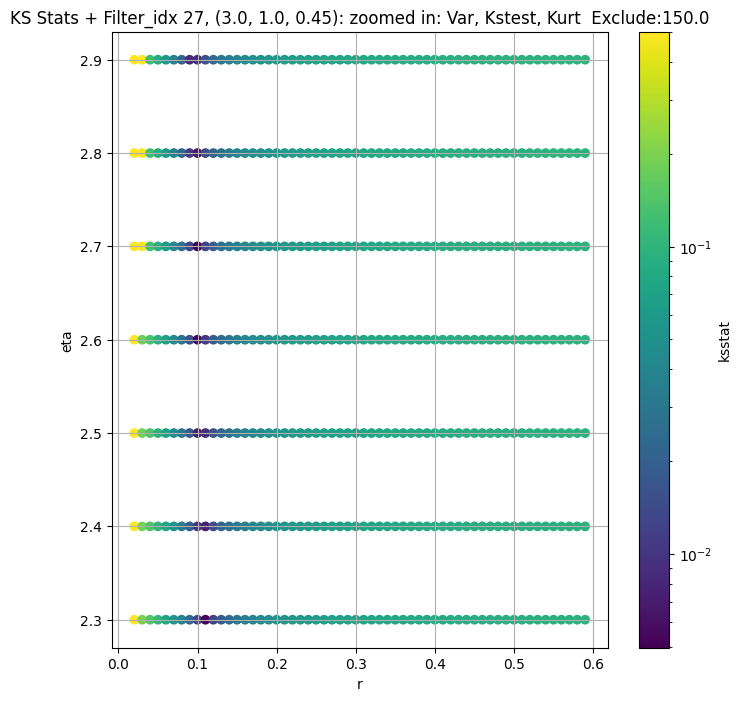

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.0026654432538344673, var: 36.75418472290039


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.0021997992423526645, var: 37.16893768310547


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.0017471736670141638, var: 37.6357536315918


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.0013106304311907534, var: 38.187599182128906


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.0007286736465141885, var: 39.024322509765625
Number of samples: 100000, Without approximation : 16384000.0


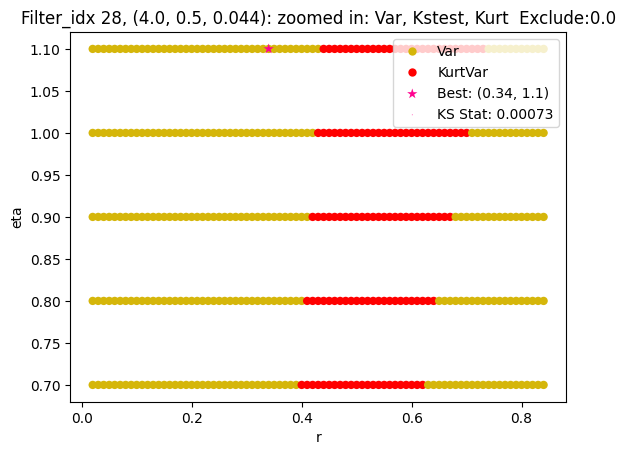

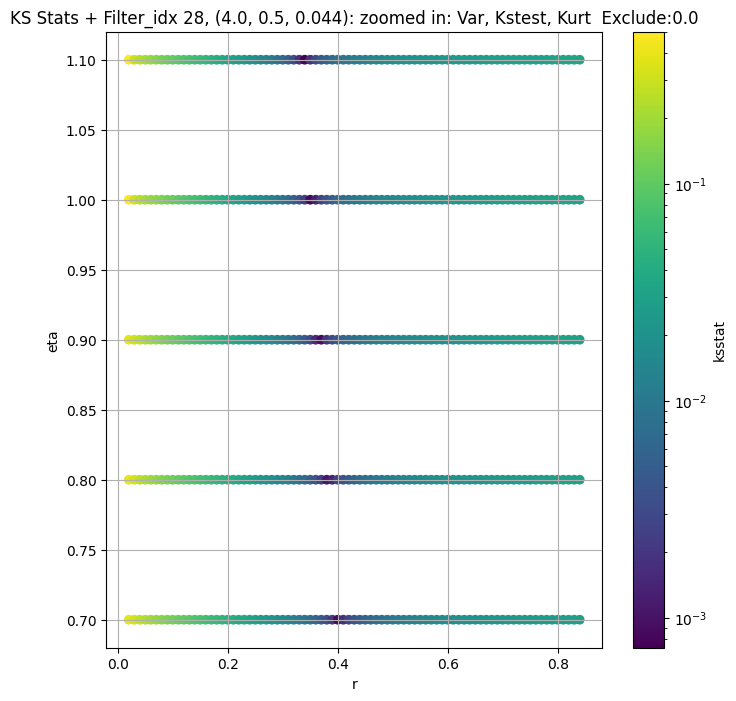

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 100 = 100, ksstat: 0.002568404539049718, var: 15.266776084899902


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 75 = 75, ksstat: 0.002034582453008957, var: 15.478240013122559


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 50 = 50, ksstat: 0.0014593110600886854, var: 15.719527244567871


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 25 = 25, ksstat: 0.000871505240251591, var: 16.012136459350586


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 0 = 0, ksstat: 0.0007612460199197812, var: 16.513273239135742
Number of samples: 100000, Without approximation : 16384000.0


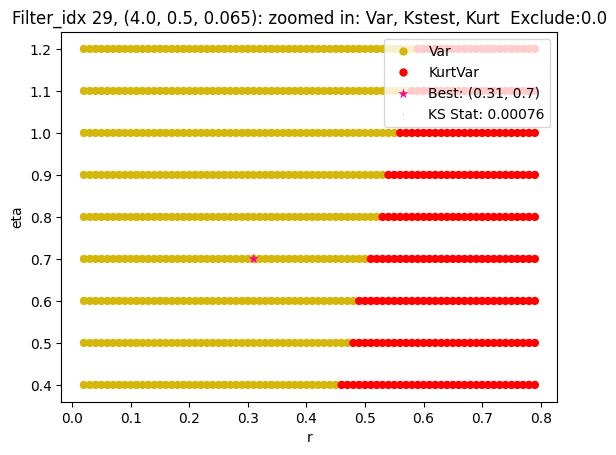

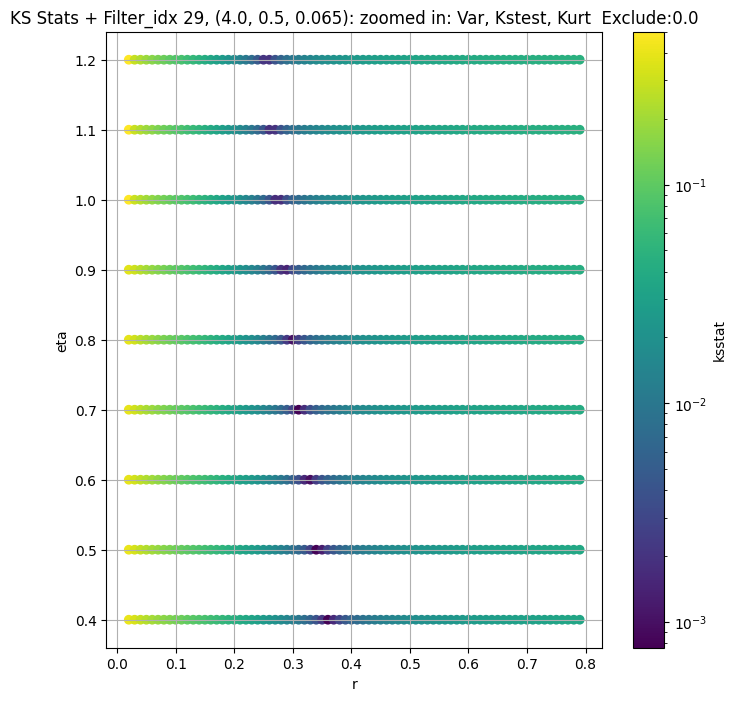

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.002385045709383138, var: 5.883056640625


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.0019489215512558111, var: 5.966819763183594


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.0015153718624405788, var: 6.062552452087402


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.0010893260945469274, var: 6.178182125091553


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.0004956422649320391, var: 6.377926826477051
Number of samples: 100000, Without approximation : 16384000.0


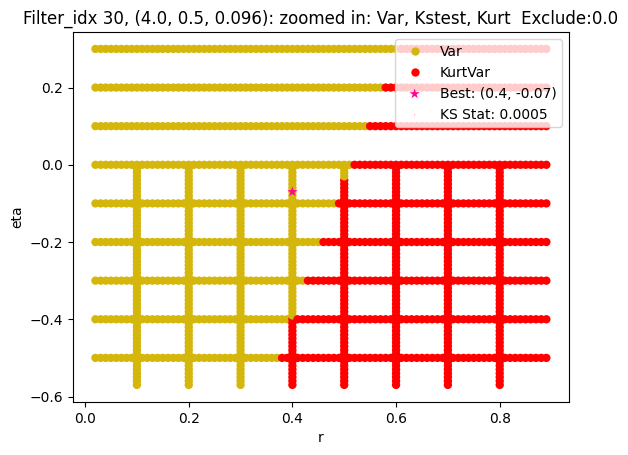

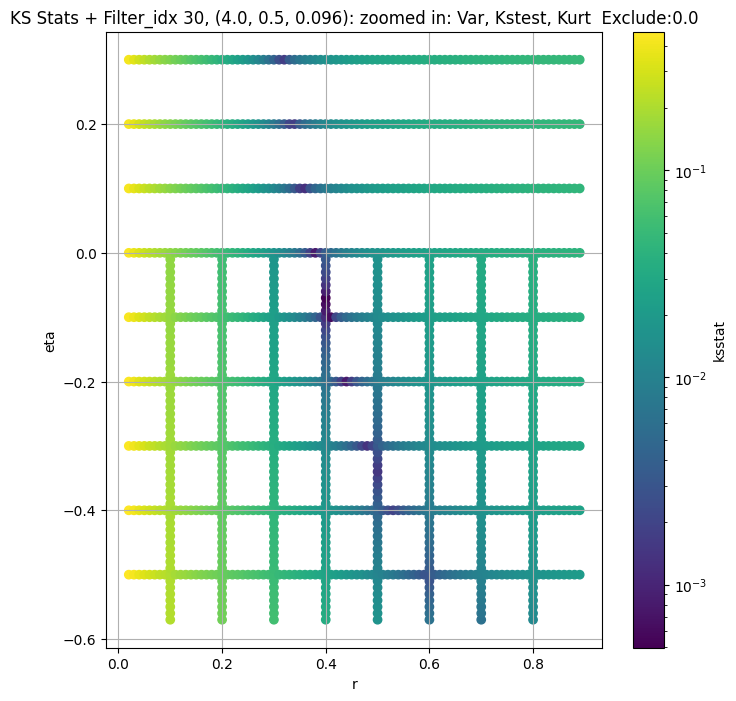

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 31, 50.0 + 100 = 150, ksstat: 0.0033513100496965764, var: 2.068289279937744


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 31, 50.0 + 75 = 125, ksstat: 0.002961935995421515, var: 2.0960538387298584


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 31, 50.0 + 50 = 100, ksstat: 0.0026992856825386324, var: 2.12630295753479


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 31, 50.0 + 25 = 75, ksstat: 0.0023603599045970425, var: 2.1598660945892334


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 31, 50.0 + 0 = 50, ksstat: 0.0019097545246848924, var: 2.1982572078704834


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 31, 50.0 + -25 = 25, ksstat: 0.0016196428958256126, var: 2.2450265884399414


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 31, 50.0 + -50 = 0, ksstat: 0.0008890946209845763, var: 2.3313848972320557
Number of samples: 100000, Without approximation : 16384000.0


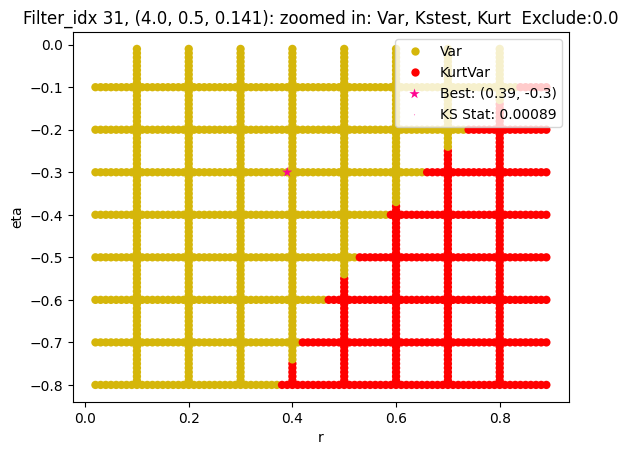

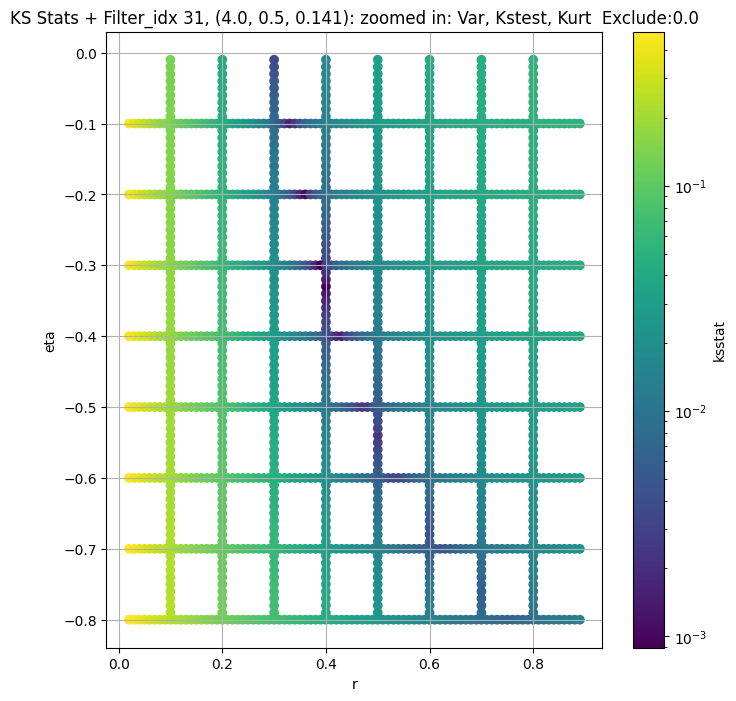

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 32, 0.0 + 100 = 100, ksstat: 0.004245830018795971, var: 0.73820561170578


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 32, 0.0 + 75 = 75, ksstat: 0.0036412398524277023, var: 0.7524826526641846


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 32, 0.0 + 50 = 50, ksstat: 0.0034661258446759824, var: 0.7690384387969971


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 32, 0.0 + 25 = 25, ksstat: 0.0028662966751162866, var: 0.7895387411117554


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 32, 0.0 + 0 = 0, ksstat: 0.002392796214118309, var: 0.8267780542373657
Number of samples: 100000, Without approximation : 16384000.0


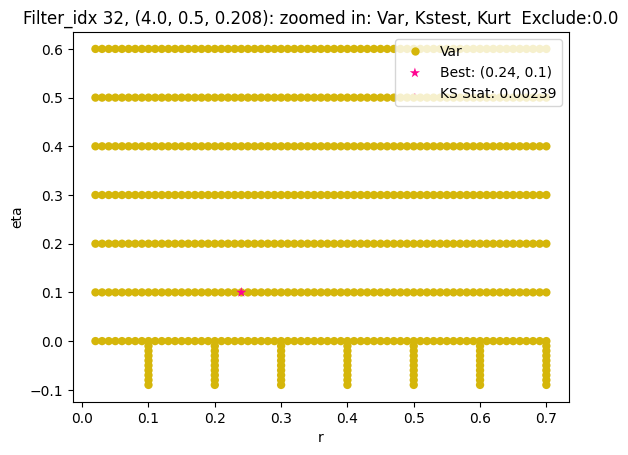

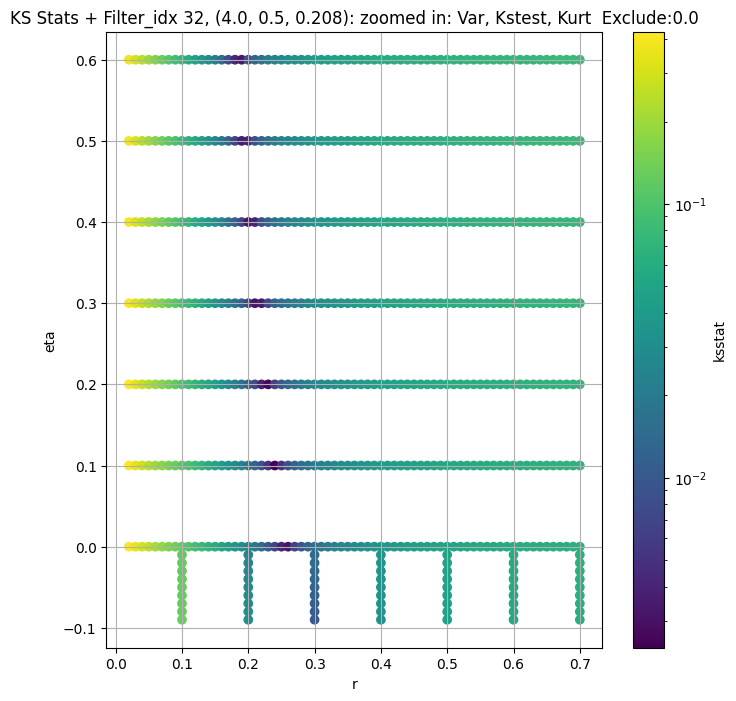

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 0.0 + 100 = 100, ksstat: 0.005370871955203138, var: 0.2402421236038208


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 0.0 + 75 = 75, ksstat: 0.0047999507304968825, var: 0.24552768468856812


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 0.0 + 50 = 50, ksstat: 0.004130421011440455, var: 0.2517058551311493


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 0.0 + 25 = 25, ksstat: 0.0036401670639524264, var: 0.25941842794418335


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 0.0 + 0 = 0, ksstat: 0.0030925797342519767, var: 0.27373427152633667
Number of samples: 100000, Without approximation : 16384000.0


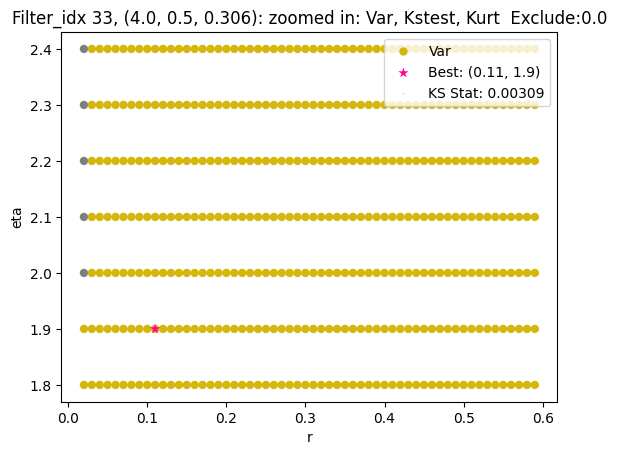

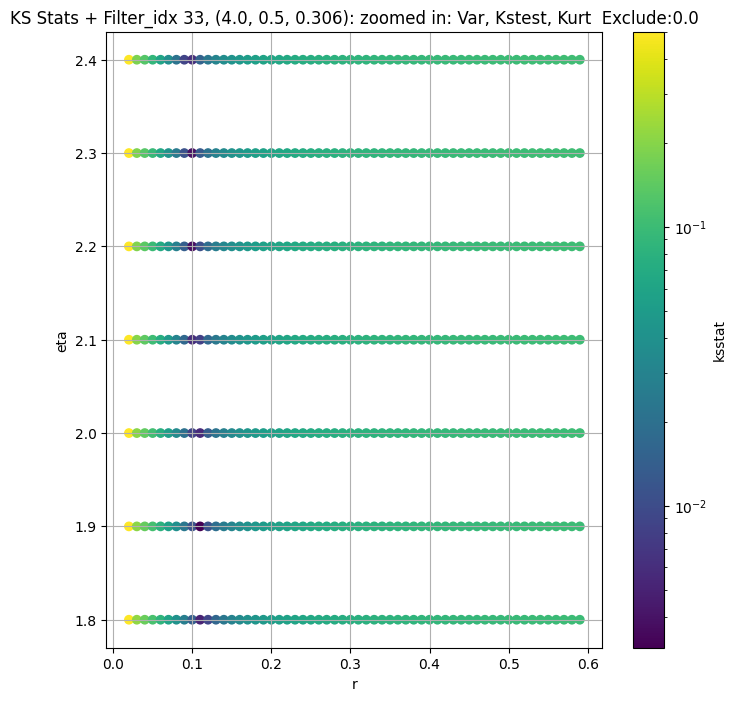

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + 100 = 200, ksstat: 0.005176524603770168, var: 0.05526310205459595


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + 75 = 175, ksstat: 0.00479857161525421, var: 0.05624401196837425


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + 50 = 150, ksstat: 0.004341230414477027, var: 0.05731279402971268


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + 25 = 125, ksstat: 0.003927070598740978, var: 0.05849488079547882


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + 0 = 100, ksstat: 0.0036452898280074364, var: 0.05982374772429466


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + -25 = 75, ksstat: 0.003757945735099577, var: 0.06135799363255501


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + -50 = 50, ksstat: 0.004849868579812677, var: 0.06320848315954208


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + -75 = 25, ksstat: 0.00521402768241519, var: 0.06563152372837067


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 100.0 + -100 = 0, ksstat: 0.006898528382643598, var: 0.07129691541194916
Number of samples: 100000, Without approximation : 16384000.0


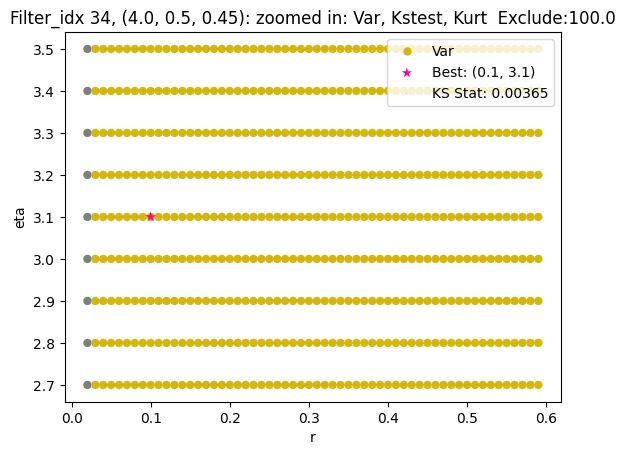

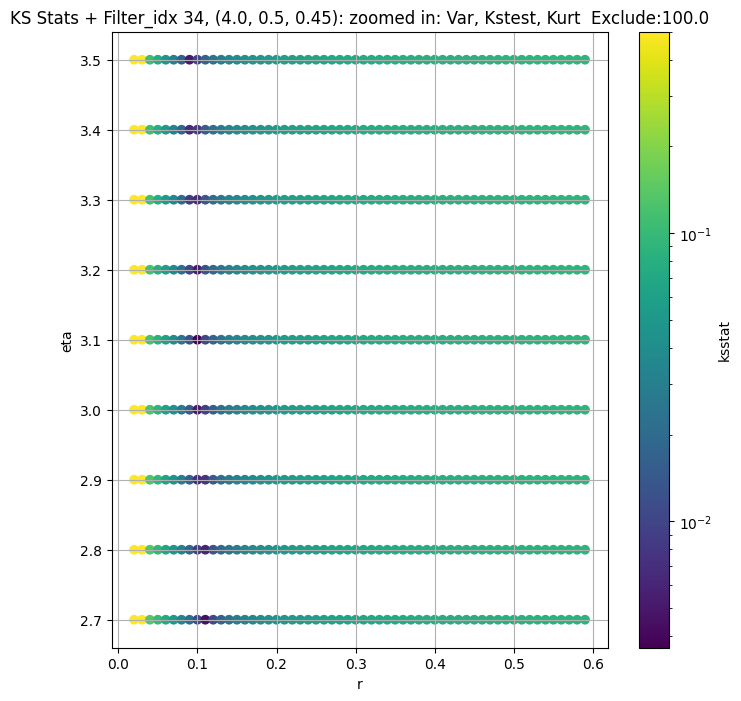

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 35, 0.0 + 100 = 100, ksstat: 0.00263539998083262, var: 42.72687530517578


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 35, 0.0 + 75 = 75, ksstat: 0.002139287020226234, var: 43.247127532958984


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 35, 0.0 + 50 = 50, ksstat: 0.0016093564068605445, var: 43.83298110961914


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 35, 0.0 + 25 = 25, ksstat: 0.0010442359061834106, var: 44.529598236083984


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 35, 0.0 + 0 = 0, ksstat: 0.0005473495735619505, var: 45.61280822753906
Number of samples: 100000, Without approximation : 16384000.0


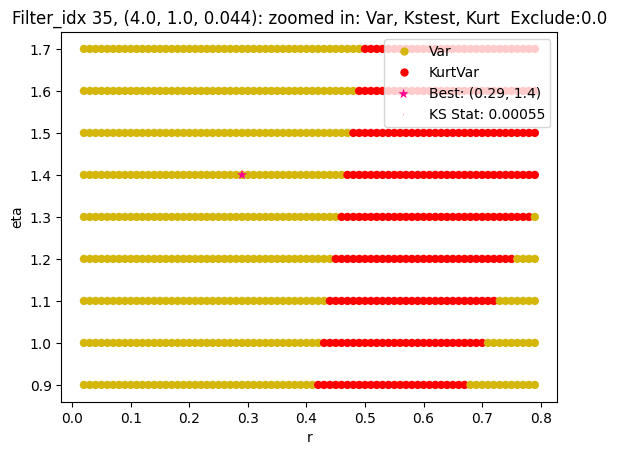

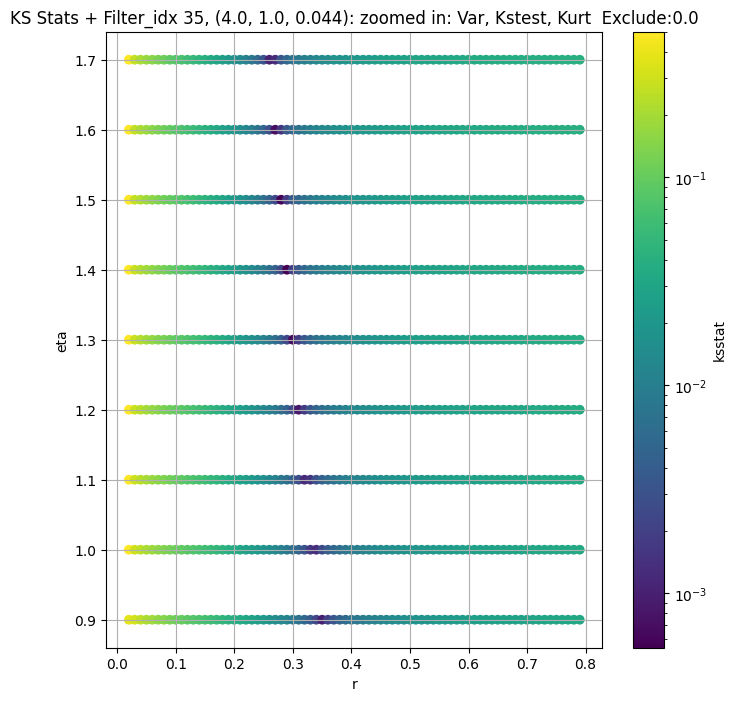

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.002887903193413005, var: 16.558719635009766


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.0023001329507884097, var: 16.78942108154297


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.0018601912513612762, var: 17.05499839782715


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.0011894161768075118, var: 17.381423950195312


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.0005286828820554312, var: 17.96221160888672
Number of samples: 100000, Without approximation : 16384000.0


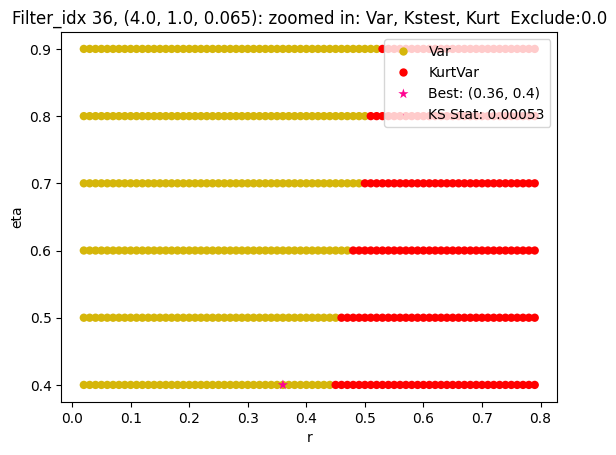

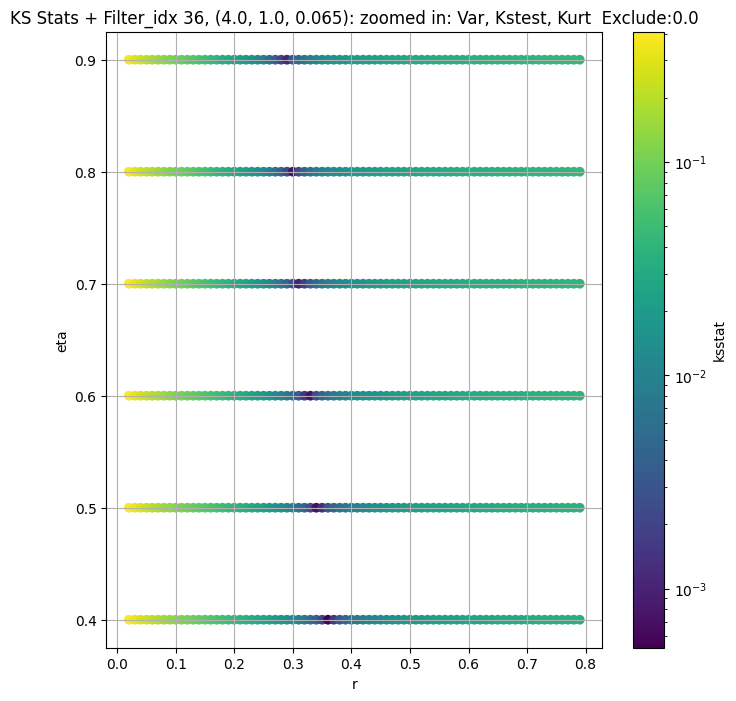

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 37, 0.0 + 100 = 100, ksstat: 0.002367737117928148, var: 5.997539043426514


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 37, 0.0 + 75 = 75, ksstat: 0.0019012865358488673, var: 6.0820207595825195


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 37, 0.0 + 50 = 50, ksstat: 0.001482103774795518, var: 6.1790266036987305


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 37, 0.0 + 25 = 25, ksstat: 0.0010796702968671884, var: 6.297713756561279


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 37, 0.0 + 0 = 0, ksstat: 0.000604226997726387, var: 6.498443603515625
Number of samples: 100000, Without approximation : 16384000.0


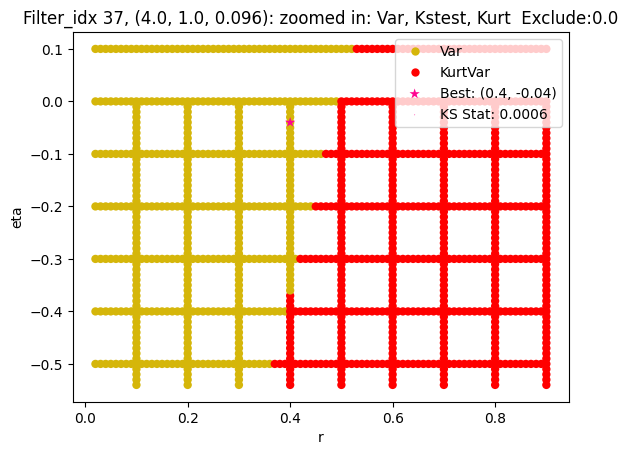

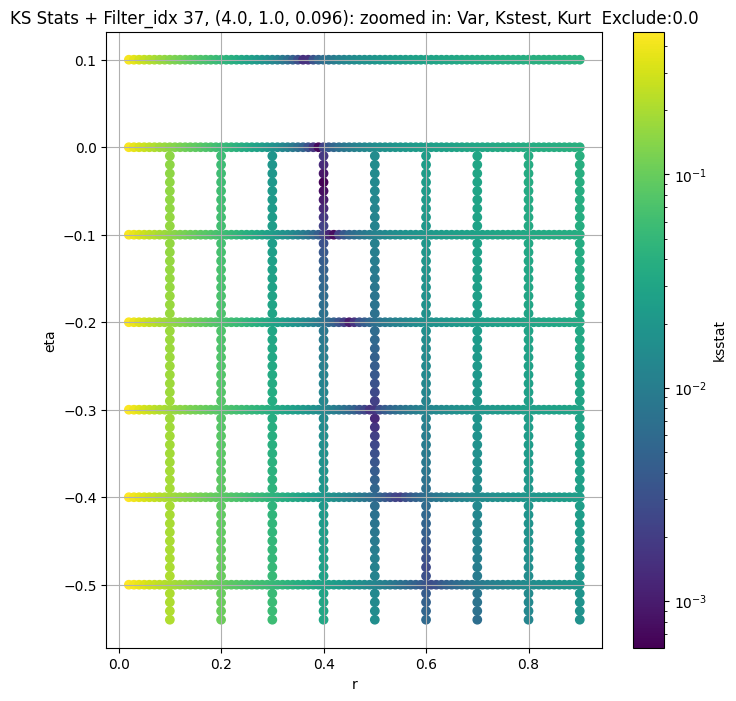

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 38, 0.0 + 100 = 100, ksstat: 0.0044473241186525625, var: 2.316770076751709


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 38, 0.0 + 75 = 75, ksstat: 0.0039858871281808275, var: 2.3585572242736816


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 38, 0.0 + 50 = 50, ksstat: 0.0035734908448434854, var: 2.4071402549743652


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 38, 0.0 + 25 = 25, ksstat: 0.0026010660170757705, var: 2.4677727222442627


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 38, 0.0 + 0 = 0, ksstat: 0.0014520002759618317, var: 2.5873677730560303
Number of samples: 100000, Without approximation : 16384000.0


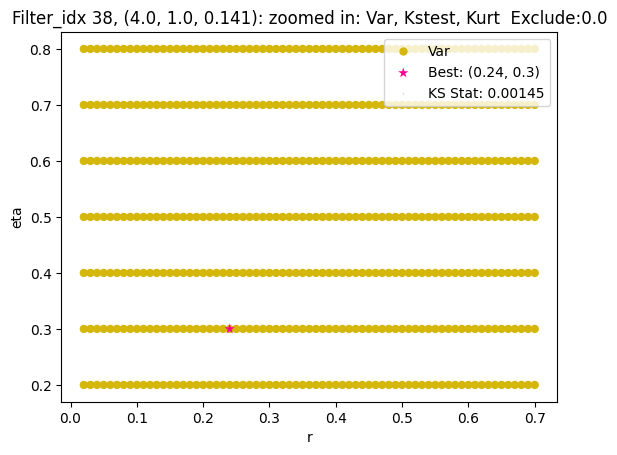

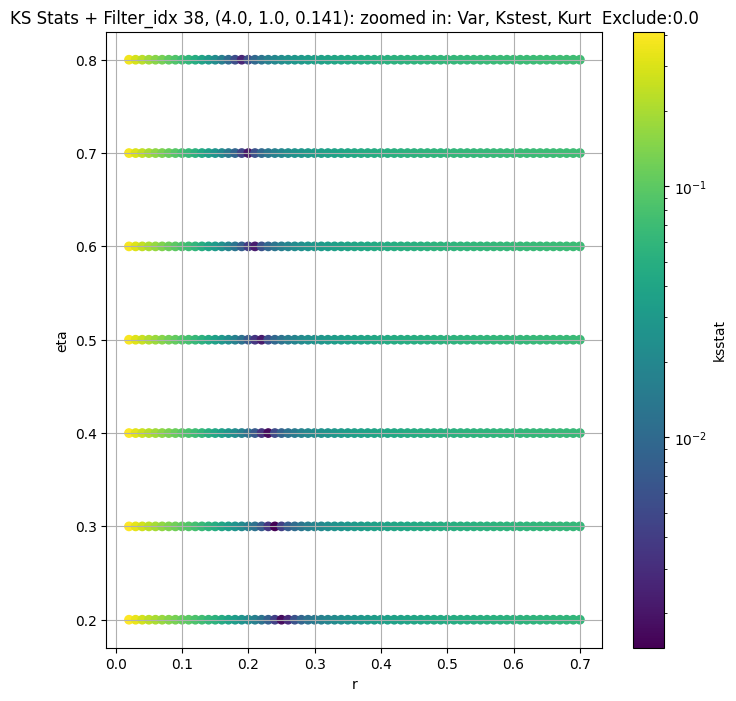

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 39, 0.0 + 100 = 100, ksstat: 0.0043839727114838925, var: 0.8455619812011719


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 39, 0.0 + 75 = 75, ksstat: 0.004006751085660509, var: 0.8623322248458862


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 39, 0.0 + 50 = 50, ksstat: 0.003479715730325607, var: 0.8818120956420898


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 39, 0.0 + 25 = 25, ksstat: 0.002913391102181695, var: 0.9058628678321838


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 39, 0.0 + 0 = 0, ksstat: 0.0023139316728130743, var: 0.950377345085144
Number of samples: 100000, Without approximation : 16384000.0


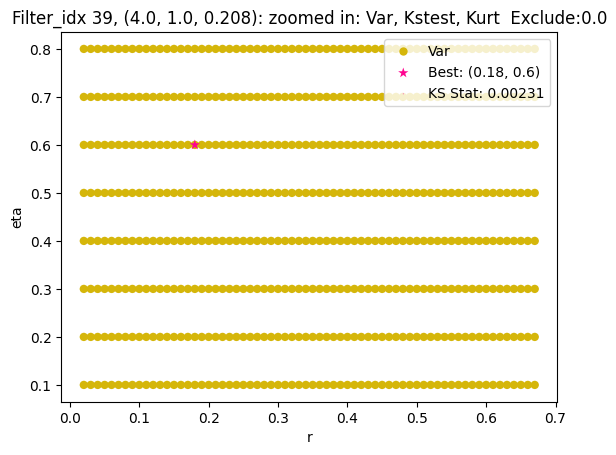

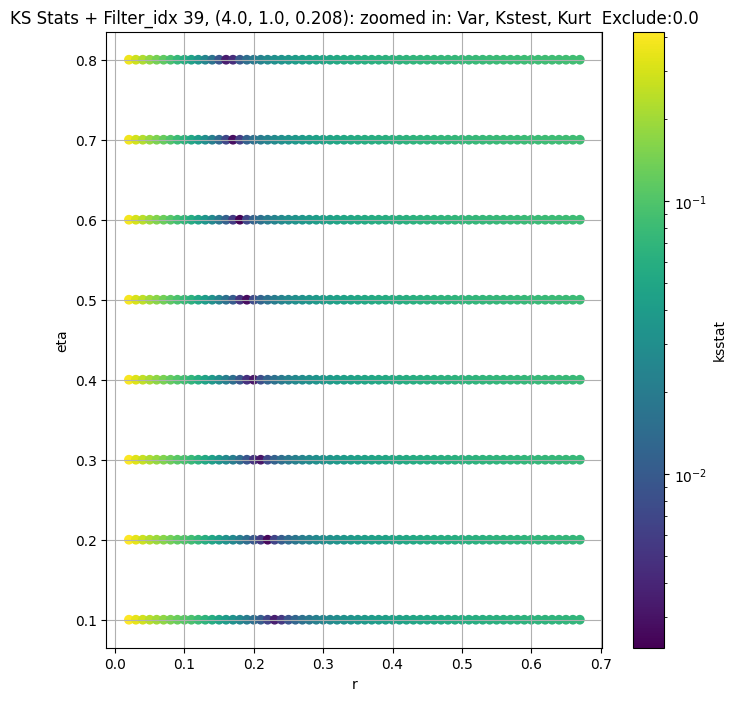

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 100 = 100, ksstat: 0.0050224715024757005, var: 0.26131975650787354


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 75 = 75, ksstat: 0.004484189222701433, var: 0.2672950029373169


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 50 = 50, ksstat: 0.00385825627390992, var: 0.2743243873119354


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 25 = 25, ksstat: 0.003276180071151824, var: 0.28316938877105713


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 0 = 0, ksstat: 0.0038676499996320723, var: 0.30052027106285095
Number of samples: 100000, Without approximation : 16384000.0


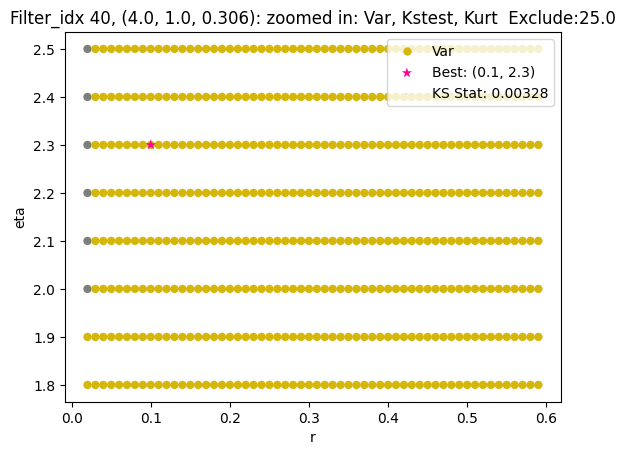

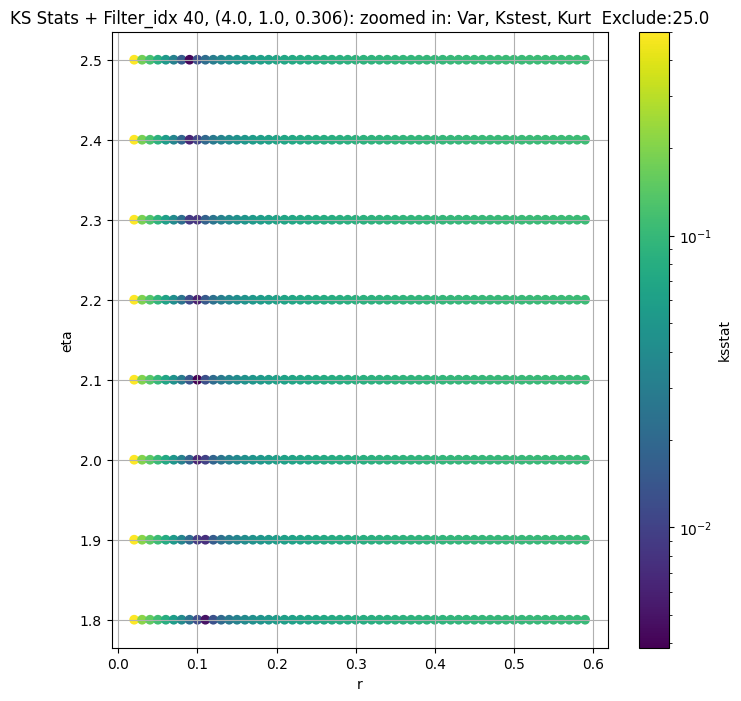

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 100 = 300, ksstat: 0.006161928682649399, var: 0.056257519870996475


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 75 = 275, ksstat: 0.005823633915425508, var: 0.05714740231633186


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 50 = 250, ksstat: 0.005443704811525785, var: 0.058090850710868835


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 25 = 225, ksstat: 0.005054320099790479, var: 0.059097129851579666


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 0 = 200, ksstat: 0.004661337691754808, var: 0.06017543748021126


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -25 = 175, ksstat: 0.004288781946792386, var: 0.0613403357565403


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -50 = 150, ksstat: 0.004412583986644819, var: 0.06260840594768524


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -75 = 125, ksstat: 0.004961279193136103, var: 0.06400678306818008


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -100 = 100, ksstat: 0.005344814199826076, var: 0.06557872891426086
Number of samples: 100000, Without approximation : 16384000.0


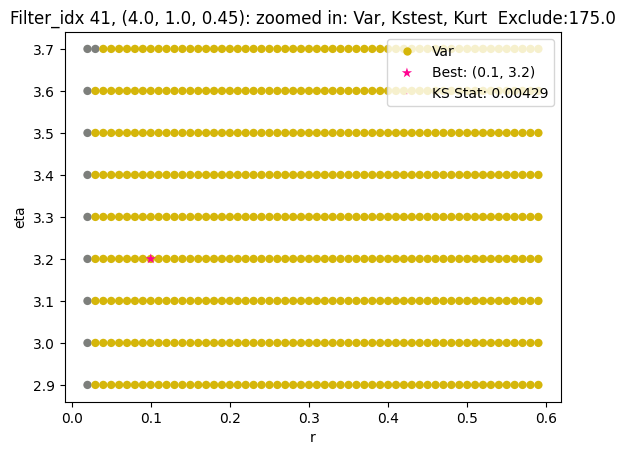

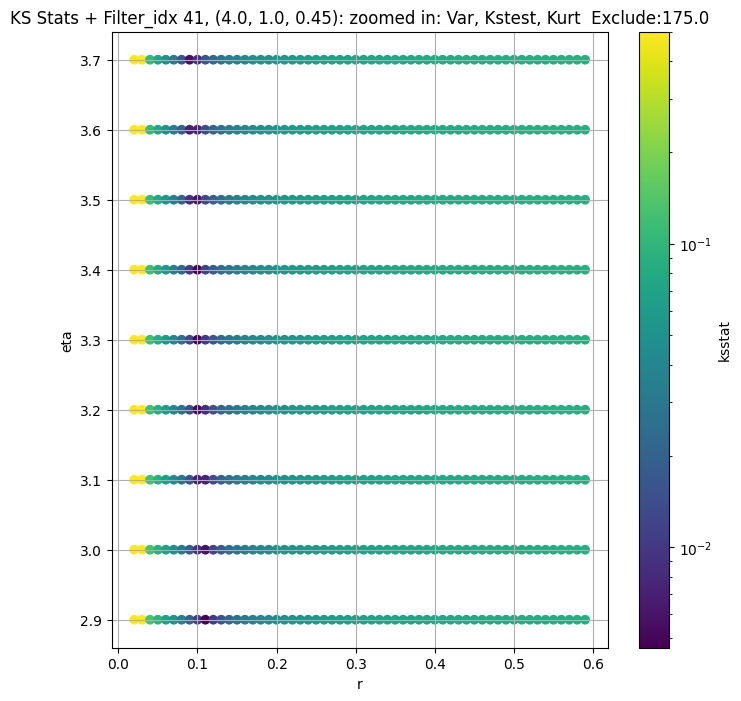

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",45.685776,36.681442,56.196175,4.554366,1.936449,13.453730,16384000.0,"(2.0, 0.5, 0.044)",0.001023,...,8.957152e-06,0.0,45.685776,0.000336,0.000921,0.21,2.30,2.961844e-05,0.0,2304000
1,"(2.0, 0.5, 0.065)",18.020935,14.297063,22.832045,5.192763,2.020806,22.338587,16384000.0,"(2.0, 0.5, 0.065)",0.001461,...,7.684188e+00,50.0,18.020935,0.000336,0.000771,0.45,0.00,8.743249e-01,0.0,3072000
2,"(2.0, 0.5, 0.096)",6.863085,5.496876,8.647962,6.144894,2.256978,31.258554,16384000.0,"(2.0, 0.5, 0.096)",0.001335,...,8.410643e-01,0.0,6.863085,0.000336,0.000246,0.50,-0.32,8.655020e-01,0.0,31104000
3,"(2.0, 0.5, 0.141)",2.609329,2.021814,3.562779,8.296274,2.903663,39.319584,16384000.0,"(2.0, 0.5, 0.141)",0.002179,...,9.970157e-02,0.0,2.609329,0.000336,0.000927,0.40,-0.32,1.032181e-01,0.0,2048000
4,"(2.0, 0.5, 0.208)",0.958908,0.720444,1.315991,11.451014,3.967390,63.742058,16384000.0,"(2.0, 0.5, 0.208)",0.002308,...,3.423856e-03,0.0,0.958908,0.000336,0.001697,0.30,-0.18,3.285278e-03,0.0,648000
5,"(2.0, 0.5, 0.306)",0.279056,0.203140,0.397355,16.405006,3.913536,98.954480,16384000.0,"(2.0, 0.5, 0.306)",0.002863,...,1.441572e-06,0.0,0.279056,0.000336,0.002121,0.18,0.60,1.269168e-07,0.0,432000
6,"(2.0, 0.5, 0.45)",0.155727,0.112684,0.251911,20.012684,4.327563,133.719500,16384000.0,"(2.0, 0.5, 0.45)",0.002483,...,4.177677e-18,0.0,0.155727,0.000336,0.002323,0.09,3.00,7.215676e-21,0.0,345988
7,"(2.0, 1.0, 0.044)",59.564480,48.876278,73.659966,4.723526,2.010139,13.899191,16384000.0,"(2.0, 1.0, 0.044)",0.000634,...,1.455184e-18,0.0,59.564480,0.000336,0.000634,0.10,7.20,1.455184e-18,0.0,4608000
8,"(2.0, 1.0, 0.065)",23.811407,19.124970,30.636597,5.541320,2.173217,28.138935,16384000.0,"(2.0, 1.0, 0.065)",0.000663,...,7.535065e-06,0.0,23.811407,0.000336,0.000560,0.22,1.80,6.549097e-05,0.0,6144000


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

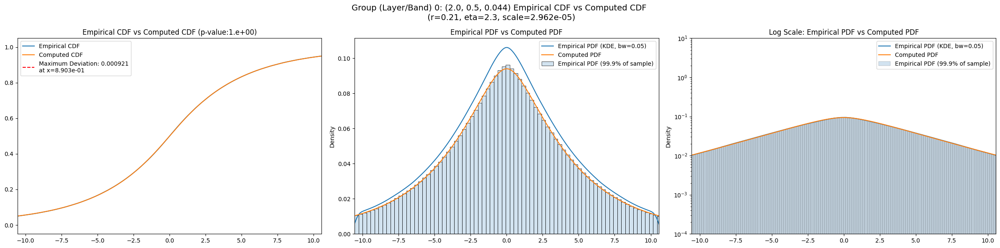

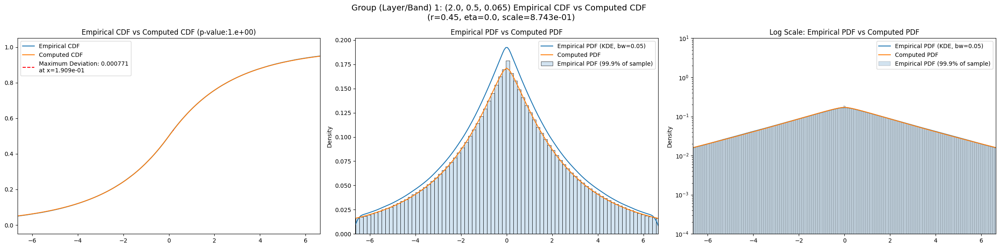

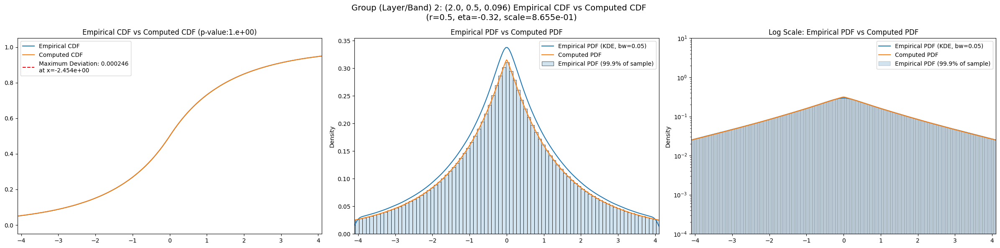

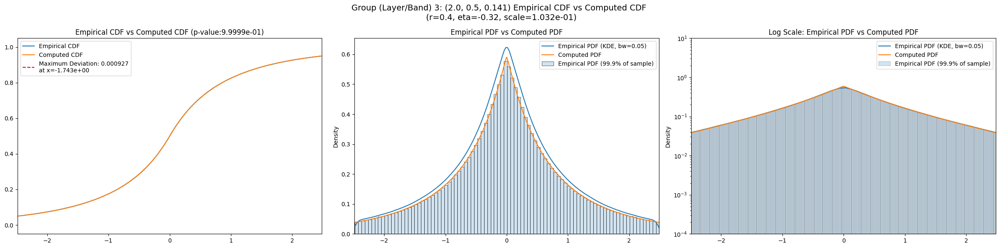

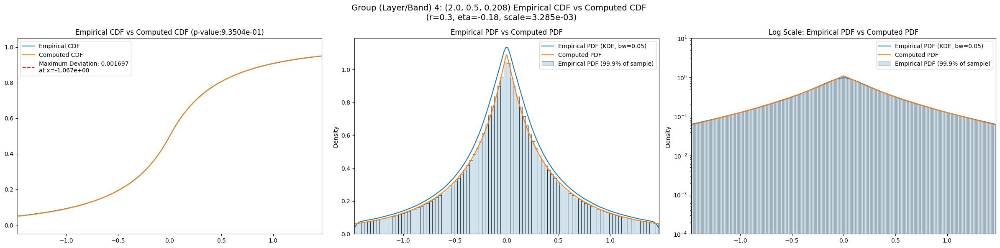

...

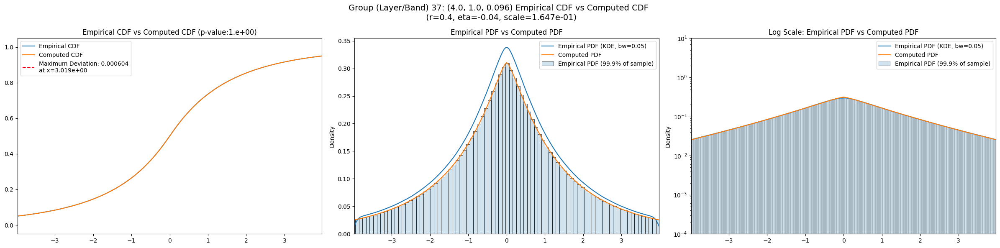

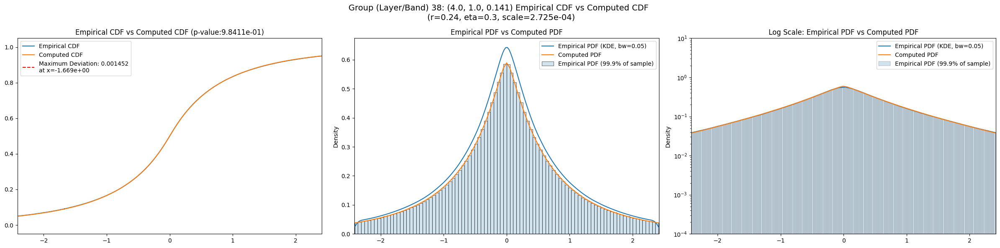

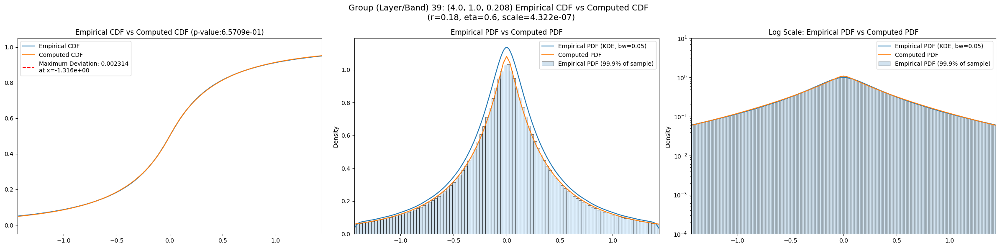

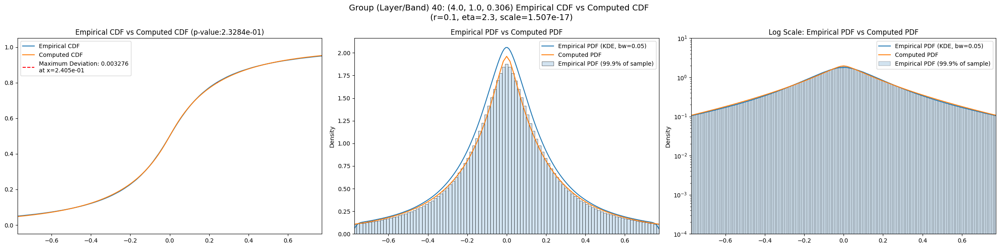

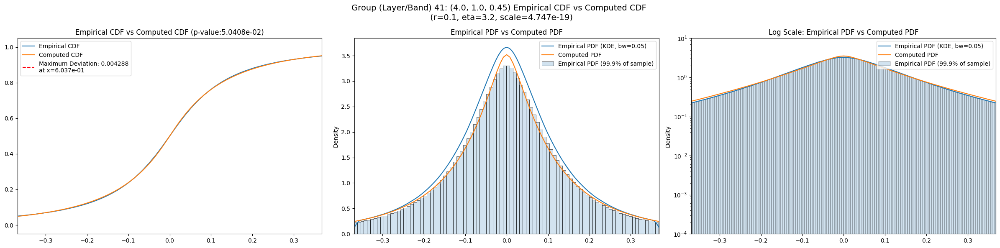

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",45.685776,36.681442,56.196175,4.554366,1.936449,13.453730,16384000.0,"(2.0, 0.5, 0.044)",0.001023,...,5.343070,0.026475,0.0,4.657030,0.004259,1.646520e-258,3.796010,0.008360,0.0,1.701239e-12
1,"(2.0, 0.5, 0.065)",18.020935,14.297063,22.832045,5.192763,2.020806,22.338587,16384000.0,"(2.0, 0.5, 0.065)",0.001461,...,3.224480,0.030905,0.0,2.834440,0.003952,1.145240e-222,2.328750,0.007544,0.0,6.893203e-09
2,"(2.0, 0.5, 0.096)",6.863085,5.496876,8.647962,6.144894,2.256978,31.258554,16384000.0,"(2.0, 0.5, 0.096)",0.001335,...,1.913010,0.035188,0.0,1.676700,0.007312,0.000000e+00,1.369870,0.011060,0.0,2.752732e-01
3,"(2.0, 0.5, 0.141)",2.609329,2.021814,3.562779,8.296274,2.903663,39.319584,16384000.0,"(2.0, 0.5, 0.141)",0.002179,...,1.098460,0.040509,0.0,0.962770,0.012649,0.000000e+00,0.780393,0.015028,0.0,1.198369e-12
4,"(2.0, 0.5, 0.208)",0.958908,0.720444,1.315991,11.451014,3.967390,63.742058,16384000.0,"(2.0, 0.5, 0.208)",0.002308,...,0.621817,0.044527,0.0,0.545436,0.016762,0.000000e+00,0.439682,0.017817,0.0,2.015723e-41
5,"(2.0, 0.5, 0.306)",0.279056,0.203140,0.397355,16.405006,3.913536,98.954480,16384000.0,"(2.0, 0.5, 0.306)",0.002863,...,0.324206,0.044532,0.0,0.285121,0.017365,0.000000e+00,0.228825,0.016352,0.0,1.802350e-64
6,"(2.0, 0.5, 0.45)",0.155727,0.112684,0.251911,20.012684,4.327563,133.719500,16384000.0,"(2.0, 0.5, 0.45)",0.002483,...,0.244408,0.042695,0.0,0.214801,0.015837,0.000000e+00,0.172866,0.014102,0.0,3.108507e-77
7,"(2.0, 1.0, 0.044)",59.564480,48.876278,73.659966,4.723526,2.010139,13.899191,16384000.0,"(2.0, 1.0, 0.044)",0.000634,...,6.156360,0.024872,0.0,5.387210,0.006480,0.000000e+00,4.364250,0.008815,0.0,3.870768e-06
8,"(2.0, 1.0, 0.065)",23.811407,19.124970,30.636597,5.541320,2.173217,28.138935,16384000.0,"(2.0, 1.0, 0.065)",0.000663,...,3.759400,0.028546,0.0,3.269720,0.003480,8.485160e-173,2.678650,0.007293,0.0,6.916324e-05


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.001023,0.000336,0.000921,0.026475,0.004259,0.008360
1,0.001461,0.000336,0.000771,0.030905,0.003952,0.007544
2,0.001335,0.000336,0.000246,0.035188,0.007312,0.011060
3,0.002179,0.000336,0.000927,0.040509,0.012649,0.015028
4,0.002308,0.000336,0.001697,0.044527,0.016762,0.017817
5,0.002863,0.000336,0.002121,0.044532,0.017365,0.016352
6,0.002483,0.000336,0.002323,0.042695,0.015837,0.014102
7,0.000634,0.000336,0.000634,0.024872,0.006480,0.008815
8,0.000663,0.000336,0.000560,0.028546,0.003480,0.007293


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,45.685776,0.000921,0.21,2.30,2.961844e-05,0.0
1,18.020935,0.000771,0.45,0.00,8.743249e-01,0.0
2,6.863085,0.000246,0.50,-0.32,8.655020e-01,0.0
3,2.609329,0.000927,0.40,-0.32,1.032181e-01,0.0
4,0.958908,0.001697,0.30,-0.18,3.285278e-03,0.0
5,0.279056,0.002121,0.18,0.60,1.269168e-07,0.0
6,0.155727,0.002323,0.09,3.00,7.215676e-21,0.0
7,59.564480,0.000634,0.10,7.20,1.455184e-18,0.0
8,23.811407,0.000560,0.22,1.80,6.549097e-05,0.0
